# Spatial-temporal Analyzing of Air Quality in Twin Cities Metropolitan Area

#### Problem Statement
* Air pollution, especially through PM2.5 in Twin Cities metropolitan area is a significant environmental and public health concern and has been linked to a range of health problems.

* How does air quality vary spatially and temporally within the Twin Cities metropolitan areas, considering factors such as seasons, days of the week, and hours of the day?

* What are the relationships between human mobility patterns, weather conditions, population distribution, employment density, land use, and traffic patterns, and air quality in the absence of high-resolution temporal air quality data?

* What spatial-temporal patterns and trends exist in the air quality of the Twin Cities metro area, and how can this information be used to inform air quality management and policies?

### Import Libraries 

In [1]:
# File manipulation
import os  # For working with Operating System
from sys import platform  # Diagnose operating system
import requests  # For making HTTP requests
import datetime as dt  # Converting unix time

# Analysis
import numpy as np  # For working with Arrays
import pandas as pd  # Data Manipulation
import geopandas as gpd  # Spatial Data Manipulation

# Visualization
from pprint import pprint  # Pretty Printing
import matplotlib.pyplot as plt  # Basic Plotting
import mplcursors  # Adding tooltips to Matplotlib plots

import warnings
warnings.filterwarnings('ignore')  # Ignores some warnings

import plotly.express as px  # For interactive visualizations
from matplotlib.widgets import Slider  # Slider widget for Matplotlib

# Table
from prettytable import PrettyTable  # For creating ASCII tables

# Additional libraries for machine learning
from sklearn.preprocessing import StandardScaler  # For standardizing the features
from sklearn.cluster import KMeans  # For performing KMeans clustering

# Utilities
from itertools import combinations  # Generates all possible combinations

### Libraries Installed

In [2]:
!pip install plotly

  Using cached plotly-5.18.0-py3-none-any.whl (15.6 MB)
  Using cached tenacity-8.2.3-py3-none-any.whl (24 kB)


In [55]:
pip install pandas matplotlib

Note: you may need to restart the kernel to use updated packages.


In [1]:
pip install xarray

     |████████████████████████████████| 1.1 MB 12.8 MB/s            
     |████████████████████████████████| 12.3 MB 47.8 MB/s            
  Using cached numpy-1.26.2-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (18.2 MB)
     |████████████████████████████████| 247 kB 32.5 MB/s            
     |████████████████████████████████| 341 kB 20.5 MB/s            
  Attempting uninstall: python-dateutil
    Found existing installation: python-dateutil 2.8.0
    Uninstalling python-dateutil-2.8.0:
      Successfully uninstalled python-dateutil-2.8.0
  Attempting uninstall: numpy
    Found existing installation: numpy 1.20.3
    Uninstalling numpy-1.20.3:
      Successfully uninstalled numpy-1.20.3
  Attempting uninstall: pandas
    Found existing installation: pandas 1.3.5
    Uninstalling pandas-1.3.5:
      Successfully uninstalled pandas-1.3.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source o

In [45]:
pip install --upgrade seaborn

     |████████████████████████████████| 294 kB 12.3 MB/s            
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.11.2
    Uninstalling seaborn-0.11.2:
      Successfully uninstalled seaborn-0.11.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
segregation 2.1.0 requires quilt3, which is not installed.
pysal 2.5.0 requires python-dateutil<=2.8.0, but you have python-dateutil 2.8.2 which is incompatible.
pysal 2.5.0 requires urllib3>=1.26, but you have urllib3 1.25.11 which is incompatible.
Note: you may need to restart the kernel to use updated packages.


In [47]:
pip install --upgrade pandas

Note: you may need to restart the kernel to use updated packages.


In [8]:
pip install utm

  Preparing metadata (setup.py) ... done
  Created wheel for utm: filename=utm-0.7.0-py3-none-any.whl size=6108 sha256=492c7e82156f90aa8cb9e36f6dda3e728b353909fc3a2c08c14a9d520e93c686
  Stored in directory: /home/siyal003/.cache/pip/wheels/75/f0/dd/39dfc9436520412399934d4a8566fe5c0cb8cc2568a1196057
Successfully built utm
Note: you may need to restart the kernel to use updated packages.


In [82]:
pip install geopandas libpysal

Note: you may need to restart the kernel to use updated packages.


In [56]:
pip install mplcursors

     |████████████████████████████████| 89 kB 834 kB/s             
  Preparing metadata (setup.py) ... done
  Created wheel for mplcursors: filename=mplcursors-0.5.2-py3-none-any.whl size=21189 sha256=5c4e0557def2ee76e19496f280922dc5c8862bd31d20eb732c39b6fcc673de2d
  Stored in directory: /home/siyal003/.cache/pip/wheels/b1/98/ff/4885c231adf3d185efdc38cf8aa2527f1b255ca714a43cb125
Successfully built mplcursors
Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install matplotlib mplcursors mpldatacursor

Note: you may need to restart the kernel to use updated packages.


In [6]:
pip install dash plotly pandas numpy

     |████████████████████████████████| 10.2 MB 17.3 MB/s            �███████████▌              | 5.6 MB 17.3 MB/s eta 0:00:01��█████████████▎   | 9.0 MB 17.3 MB/s eta 0:00:01
     |████████████████████████████████| 226 kB 42.5 MB/s            
     |████████████████████████████████| 99 kB 929 kB/s             
     |████████████████████████████████| 97 kB 776 kB/s             
     |████████████████████████████████| 133 kB 71.7 MB/s            
  Attempting uninstall: MarkupSafe
    Found existing installation: MarkupSafe 2.0.1
    Uninstalling MarkupSafe-2.0.1:
      Successfully uninstalled MarkupSafe-2.0.1
  Attempting uninstall: Jinja2
    Found existing installation: Jinja2 3.0.3
    Uninstalling Jinja2-3.0.3:
      Successfully uninstalled Jinja2-3.0.3
  Attempting uninstall: click
    Found existing installation: click 8.0.3
    Uninstalling click-8.0.3:
      Successfully uninstalled click-8.0.3
  Attempting uninstall: blinker
    Found existing installation: blinker 1.4
    U

In [2]:
pip install prettytable

Note: you may need to restart the kernel to use updated packages.


## Datasets

#### The following dataset were used for this project:

#### 1. Air Quality Data (PurpleAir)
https://www2.purpleair.com/
This notebook retrieves readings from PurpleAir Sensors in Minneapolis and cleans the entries and saves the results as a csv file.

Documentation is available here: https://api.purpleair.com.

This article is super helpful in getting started: https://community.purpleair.com/t/making-api-calls-with-the-purpleair-api/180.

I have collected 6-hour average PM2.5 data for each of the four months (April, July, October, and December), representing all four seasons.

#### 2. Metro Counties and CTUs Shapefile: This dataset contains the boundaries of the Twin Cities metropolitan area and was obtained from the MnGeo website.
https://gisdata.mn.gov/dataset/us-mn-state-metc-bdry-metro-counties-and-ctus

### Air Quality Data
##### PM2.5 Concentration Range as World Health Organization  

General Guideline	Concentration
1. Good	0-12 µg/m³
2. Moderate	12.1-35.4 µg/m³
3. Unhealthy for sensitive groups	35.5-55.4 µg/m³
4. Unhealthy	55.5-150.4 µg/m³
5. Very unhealthy	150.5-250.4 µg/m³
6. Hazardous	250.5 µg/m³ or higher


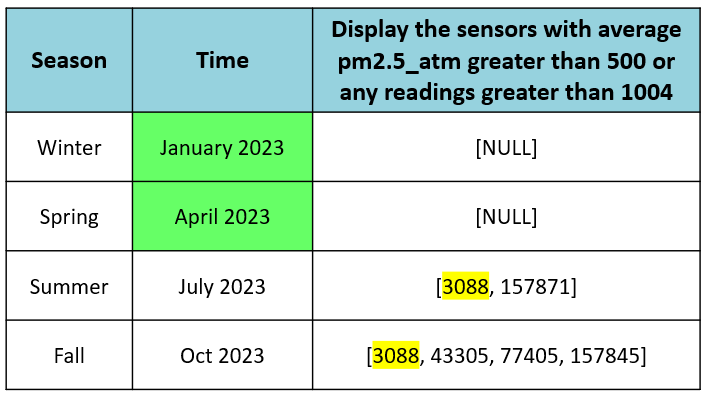

### Annual Patterns
#### Winter:
In many regions, PM2.5 levels tend to be higher during the winter months. This is often attributed to increased residential heating and the burning of solid fuels for warmth.
Poor dispersion of pollutants due to stable atmospheric conditions, such as temperature inversions, can lead to the accumulation of PM2.5 in the air.

#### Spring:
PM2.5 levels may start to decrease as temperatures rise, leading to improved dispersion of pollutants.
Changes in vegetation and the onset of rainfall can contribute to a reduction in airborne particulate matter.

#### Summer:
Generally, PM2.5 levels are lower in the summer due to increased atmospheric dispersion, higher temperatures, and enhanced atmospheric stability.
Rainfall during the summer can help remove particles from the air.

#### Autumn/Fall:
PM2.5 levels may start to rise again in the fall as heating systems are turned on and atmospheric stability decreases.
Changes in vegetation, such as the shedding of leaves, can also contribute to an increase in particulate matter.

### Study Area

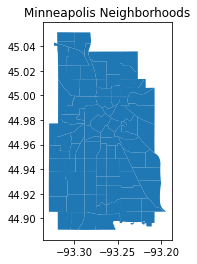

In [12]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load the Minneapolis Neighborhoods GeoJSON file
neighborhoods_geojson_file = "Minneapolis_Neighborhoods.geojson"
minneapolis_neighborhoods = gpd.read_file(neighborhoods_geojson_file)

# Create a basic plot of the Minneapolis neighborhoods
minneapolis_neighborhoods.plot()

# Add a title
plt.title("Minneapolis Neighborhoods")

# Show the plot
plt.show()

In [53]:
# Extent of study (4km from Mpls)

# Minneapolis Boundary (from MetCouncil CTUs and County Boundaries)

mpls_path = os.path.join(os.getcwd(), 'Minneapolis_Neighborhoods.geojson')
mpls = gpd.read_file(mpls_path)

# Get extent

mpls_buffed = mpls.geometry.buffer(4000)

### To convert the Unix timestamp

In [ ]:
import datetime

timestamp = 1698955053 #that many seconds have passed since 00:00:00 UTC (Coordinated Universal Time) on January 1, 1970. 

# Convert the timestamp to a datetime object
dt = datetime.datetime.utcfromtimestamp(timestamp)

# Print the datetime in a readable format
print(dt)

### ETL to get Sensors Locations

In [24]:
# Importing Packages
import requests
import pandas as pd
import time

In [25]:
#My personal Read key
API_KEY = "A476D63C-5813-11EE-A77F-42010A800009" 

In [26]:
# Getting Sensor Lat/Longs
response = requests.get("https://api.purpleair.com/v1/sensors",
            headers={
                "X-API-Key": API_KEY
            },
            params={
                "fields": "latitude,longitude",
                "location_type": 0,
                "nwlng": -93.36258704975518, #This box is for Minneapolis with approx. 5 mile buffer
                "nwlat": 45.076741700978054,
                "selng": -93.16002663878811,
                "selat": 44.84668934299847
            }
        )

sensors = response.json()["data"]

In [27]:
# Dataframe of Sensor IDs 
df = pd.DataFrame(sensors, columns=["sensor", "lat", "lng"])

df

,sensor,lat,lng
0,3088,44.935818,-93.217520
1,5582,44.891655,-93.342910
2,11134,44.927760,-93.322350
3,21179,44.965965,-93.284615
4,43305,44.899097,-93.301690
...,...,...,...
72,193171,45.052310,-93.360970
73,193207,44.998047,-93.205510
74,194635,44.953735,-93.248660
75,196233,44.986860,-93.183380


In [28]:
# Convert Pandas DataFrame to CSV
df.to_csv('sensor_data_minneapolis.csv', index=False)

<AxesSubplot:>

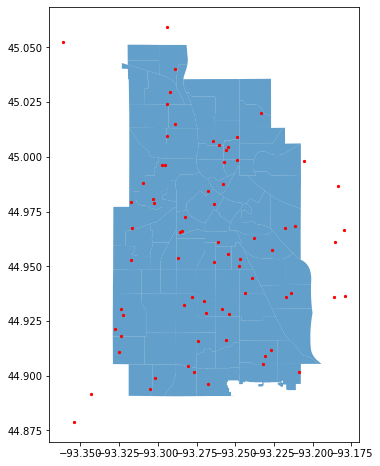

In [21]:
#PLOT ALL THE SENSORS IN MINNEAPOLIS

from shapely.geometry import Point

# Load the Minneapolis Neighborhoods GeoJSON file
neighborhoods_geojson_file = "Minneapolis_Neighborhoods.geojson"
minneapolis_neighborhoods = gpd.read_file(neighborhoods_geojson_file)

# Load the sensor data from your CSV file
sensors_csv_file = "sensor_data_minneapolis.csv"
sensor_data = pd.read_csv(sensors_csv_file)

# Create a GeoDataFrame from the sensor data
geometry = [Point(xy) for xy in zip(sensor_data.lng, sensor_data.lat)]
sensor_geo_df = gpd.GeoDataFrame(sensor_data, crs="EPSG:4326", geometry=geometry)

# Now you can visualize the Minneapolis neighborhoods and sensor data together
ax = minneapolis_neighborhoods.plot(figsize=(12, 8), alpha=0.7)
sensor_geo_df.plot(ax=ax, color="red", markersize=5)

### Purple Air Sensors in Minneapolis Area location
This sensor location csv is through manual method of getting long-lat

In [32]:
#USE THIS WHEN NARROWING DOWN FROM MINNESOTA TO MINNEAPOLIS

import geopandas as gpd
import pandas as pd

# Load Minneapolis neighborhood boundaries from GeoJSON
minneapolis_geojson = gpd.read_file('Minneapolis_Neighborhoods.geojson')

# Load sensor locations in MINNESOTA
sensor_locations = pd.read_csv('PurpleAir_SensorLocations_Minnesota.csv')

# Convert sensor locations to GeoDataFrame
sensor_locations_gdf = gpd.GeoDataFrame(
    sensor_locations,
    geometry=gpd.points_from_xy(sensor_locations.X, sensor_locations.Y),
    crs="EPSG:4326"
)

# Perform spatial join to filter sensors in Minneapolis
sensors_in_minneapolis = gpd.sjoin(sensor_locations_gdf, minneapolis_geojson, op='within')

# Save the result to a new CSV file
sensors_in_minneapolis.to_csv('Sensors_In_Minneapolis.csv', index=False)

/opt/conda/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3377: FutureWarning:

The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.



<AxesSubplot:>

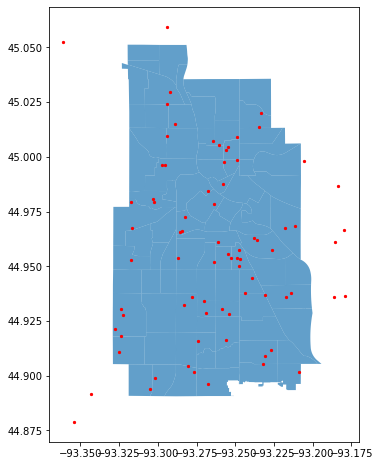

In [34]:
#PLOT ALL THE SENSORS IN MINNEAPOLIS

from shapely.geometry import Point

# Load Minneapolis neighborhood boundaries from GeoJSON (if not loaded already)
minneapolis_neighborhoods = gpd.read_file("Minneapolis_Neighborhoods.geojson")

# Load the sensor data from your CSV file
sensors_csv_file = "Sensors in Mpls_ETL.csv"
sensor_data = pd.read_csv(sensors_csv_file)

# Create a GeoDataFrame from the sensor data
geometry = [Point(xy) for xy in zip(sensor_data.X, sensor_data.Y)]
sensor_geo_df = gpd.GeoDataFrame(sensor_data, crs="EPSG:4326", geometry=geometry)

# Now you can visualize the Minneapolis neighborhoods and sensor data together
ax = minneapolis_neighborhoods.plot(figsize=(12, 8), alpha=0.7)
sensor_geo_df.plot(ax=ax, color="red", markersize=5)

##### PLOT ALL THE SENSORS WITHIN 5 Miles of MINNEAPOLIS

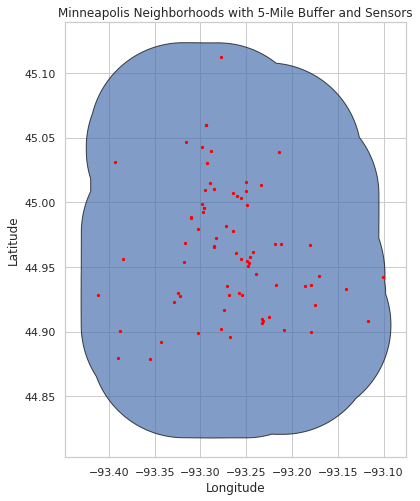

In [ ]:
import geopandas as gpd
from shapely.geometry import Point

# Specify the full path to the Minneapolis neighborhood boundaries shapefile
shapefile_path = "./Twin_Cities_Shapefile/mpls_buffer_5m.shp"

# Load Minneapolis neighborhood boundaries from the specified shapefile
minneapolis_neighborhoods = gpd.read_file(shapefile_path)

# Load the sensor data from your CSV file
sensors_csv_file = "sensor_within5m_buffer_mpls.csv"
sensor_data = pd.read_csv(sensors_csv_file)

# Create a GeoDataFrame from the sensor data
geometry = [Point(xy) for xy in zip(sensor_data.X, sensor_data.Y)]
sensor_geo_df = gpd.GeoDataFrame(sensor_data, crs="EPSG:4326", geometry=geometry)

# Now you can visualize the Minneapolis neighborhoods and sensor data together
ax = minneapolis_neighborhoods.plot(figsize=(12, 8), alpha=0.7)
sensor_geo_df.plot(ax=ax, color="red", markersize=5)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Minneapolis Neighborhoods with 5-Mile Buffer and Sensors")
plt.show()

## SAMPLE CODE

In [ ]:
#It starts from here:

import pandas as pd  # for data manipulation and analysis
import os  # for interacting with the file system
import glob  # file search with patterns

# Load the sensor locations data into a DataFrame
sensor_locations_df = pd.read_csv("Sensors_In_Minneapolis.csv")

# Define the directory where the CSV files are located
directory = "./AQ_Data/AQ_Apr2023" 

# Create an empty list to store the dataframes
dfs = []

# Iterate over each file in the directory
for filename in os.listdir(directory):
    # Check if the file is a CSV file
    if filename.endswith(".csv"):
        # Extract the sensor ID from the filename
        Sensor_ID = filename.split()[0]
        
        # Load the CSV file into a pandas DataFrame
        df = pd.read_csv(os.path.join(directory, filename))
        
        # Add a new column with the sensor ID
        df["Sensor_ID"] = Sensor_ID
        
        # Append the DataFrame to the list
        dfs.append(df)

# Concatenate all the dataframes in the list
combined_df = pd.concat(dfs, ignore_index=True)

# converting the "Sensor_ID" column in the sensor_locations_df dataframe to a string data type using the astype() method
sensor_locations_df["Sensor_ID"] = sensor_locations_df["Sensor_ID"].astype(str)

# Perform a left join between SensorLocations_HennepinCounty and combined_df on sensor_id
merged_df = pd.merge(sensor_locations_df, combined_df, on="Sensor_ID", how="inner")

# Sort by the time_stamp column
merged_df = merged_df.sort_values("time_stamp")

merged_df.to_csv("AQ_Apr2023.csv", index=False)

In [5]:
# Iterate over each file in the specified directory
for filename in os.listdir(directory):
    # Check if the file has a ".csv" extension
    if filename.endswith(".csv"):
        # Create the full file path by joining the directory and the filename
        file_path = os.path.join(directory, filename)
        
        # Check if the file is not empty (has a size greater than 0 bytes)
        if os.path.getsize(file_path) > 0:
            # Extract the sensor ID from the filename
            Sensor_ID = filename.split()[0]
            
            # Read the CSV file into a pandas DataFrame
            df = pd.read_csv(file_path)
            
            # Add a new column "Sensor_ID" to the DataFrame
            df["Sensor_ID"] = Sensor_ID
            
            # Append the DataFrame to the list of DataFrames
            dfs.append(df)
        else:
            # Print a message indicating that an empty file was skipped
            print(f"Skipped empty file: {filename}")

Skipped empty file: 17189. 2023-04-03 2023-04-10 360-Minute Average.csv
Skipped empty file: 145234 2023-04-03 2023-04-10 360-Minute Average.csv
Skipped empty file: 142852 2023-04-03 2023-04-10 360-Minute Average.csv


## Distance between sensors

In [14]:
## The distance is in degrees

import pandas as pd
from itertools import combinations

# Load the sensor data from your CSV file
sensors_csv_file = "Sensors in Mpls_ETL.csv"
sensor_data = pd.read_csv(sensors_csv_file)

# Extract relevant columns
coordinates = sensor_data[['Sensor_ID', 'X', 'Y']]

# Create a list of all unique combinations of sensor pairs
sensor_combinations = list(combinations(coordinates.values, 2))

# Calculate distances for each pair of sensors
distances = []
for combo in sensor_combinations:
    sensor1, sensor2 = combo
    sensor_id1, x1, y1 = sensor1
    sensor_id2, x2, y2 = sensor2
    distance = ((x2 - x1)**2 + (y2 - y1)**2)**0.5
    distances.append({'Sensor_ID_1': int(sensor_id1), 'Sensor_ID_2': int(sensor_id2), 'Distance': distance})

# Create a DataFrame with the distances
distances_df = pd.DataFrame(distances)

# Print or save the distances DataFrame
print(distances_df)
# distances_df.to_csv("sensor_distances.csv", index=False)

      Sensor_ID_1  Sensor_ID_2  Distance
0            3088         5582  0.132940
1            3088        11134  0.105139
2            3088        21179  0.073557
3            3088        43305  0.091831
4            3088        54907  0.077557
...           ...          ...       ...
2921       193207       196233  0.024797
2922       193207       198941  0.066291
2923       194635       196233  0.073203
2924       194635       198941  0.024360
2925       196233       198941  0.069081

[2926 rows x 3 columns]


In [16]:
##  NAD 1983 UTM Zone 15N
# Converted degrees to meters using the approximate conversion factor of 1 degree of latitude being approximately 111 kilometers.
# Converted meters to miles using the conversion factor of 1 kilometer being approximately 0.621371 miles.

import pandas as pd
from itertools import combinations ## generates all possible combinations 

# Constants for conversion
DEG_TO_KM_FACTOR = 111.0  # Approximate conversion factor for degrees to kilometers
KM_TO_MILES_FACTOR = 0.621371  # Conversion factor for kilometers to miles

# Load the sensor data from your CSV file
sensors_csv_file = "Sensors in Mpls_ETL.csv"
sensor_data = pd.read_csv(sensors_csv_file)

# Extract relevant columns
coordinates = sensor_data[['Sensor_ID', 'X', 'Y']]

# Create a list of all unique combinations of sensor pairs
sensor_combinations = list(combinations(coordinates.values, 2))

# Calculate distances for each pair of sensors
distances = []
for combo in sensor_combinations:
    sensor1, sensor2 = combo
    sensor_id1, x1, y1 = sensor1
    sensor_id2, x2, y2 = sensor2
    
    # Convert degrees to meters
    distance_in_km = ((x2 - x1)**2 + (y2 - y1)**2)**0.5 * DEG_TO_KM_FACTOR
    
    # Convert kilometers to miles
    distance_in_miles = distance_in_km * KM_TO_MILES_FACTOR
    
    distances.append({'Sensor_ID_1': int(sensor_id1), 'Sensor_ID_2': int(sensor_id2), 'Distance': distance_in_miles})

# Create a DataFrame with the distances
distances_df = pd.DataFrame(distances)

# Print or save the distances DataFrame
print(distances_df)
distances_df.to_csv("sensor_distances_miles.csv", index=False)

      Sensor_ID_1  Sensor_ID_2  Distance
0            3088         5582  9.169156
1            3088        11134  7.251683
2            3088        21179  5.073363
3            3088        43305  6.333817
4            3088        54907  5.349297
...           ...          ...       ...
2921       193207       196233  1.710296
2922       193207       198941  4.572221
2923       194635       196233  5.049001
2924       194635       198941  1.680194
2925       196233       198941  4.764643

[2926 rows x 3 columns]


In [3]:
import pandas as pd
from itertools import combinations
from IPython.display import display

# Constants for conversion
DEG_TO_KM_FACTOR = 111.0  # Approximate conversion factor for degrees to kilometers
KM_TO_MILES_FACTOR = 0.621371  # Conversion factor for kilometers to miles

# Load the sensor data from your CSV file
sensors_csv_file = "Sensors in Mpls_ETL.csv"
sensor_data = pd.read_csv(sensors_csv_file)

# Extract relevant columns
coordinates = sensor_data[['Sensor_ID', 'X', 'Y']]

# Create a list of all unique combinations of sensor pairs
sensor_combinations = list(combinations(coordinates.values, 2))

# Calculate distances for each pair of sensors
distances = []
for combo in sensor_combinations:
    sensor1, sensor2 = combo
    sensor_id1, x1, y1 = sensor1
    sensor_id2, x2, y2 = sensor2
    
    # Convert degrees to meters
    distance_in_km = ((x2 - x1)**2 + (y2 - y1)**2)**0.5 * DEG_TO_KM_FACTOR
    
    # Convert kilometers to miles
    distance_in_miles = distance_in_km * KM_TO_MILES_FACTOR
    
    distances.append({'Sensor_ID_1': int(sensor_id1), 'Sensor_ID_2': int(sensor_id2), 'Distance': distance_in_miles})

# Create a DataFrame with the distances
distances_df = pd.DataFrame(distances)

# Display the DataFrame
display(distances_df)

# Save the DataFrame to a CSV file if needed
distances_df.to_csv("sensor_distances_miles.csv", index=False)

,Sensor_ID_1,Sensor_ID_2,Distance
0,3088,5582,9.169156
1,3088,11134,7.251683
2,3088,21179,5.073363
3,3088,43305,6.333817
4,3088,54907,5.349297
...,...,...,...
2921,193207,196233,1.710296
2922,193207,198941,4.572221
2923,194635,196233,5.049001
2924,194635,198941,1.680194


# DATA Manupulation
To gather the necessary air quality data, the Purple Air API served as the primary source for downloading the information. The initial step involved locating sensors within the Minneapolis boundary, achieved through the implementation of a custom Extract, Transform, and Load (ETL) process. Following this, individual CSV files corresponding to each sensor were meticulously processed to ensure data accuracy and uniformity. The subsequent phase involved merging these processed datasets, a task accomplished through the concatenation of all DataFrames present in the designated list. The data manipulation process involves converting the "Sensor_ID" column in sensor_locations_df to a string, performing a left join with combined_df to create merged_df, sorting it based on "time_stamp," and ultimately saving the final merged DataFrame without including the index for efficient storage.

## WINTER SEASON

In [91]:
## JANUARY 2023

# Load the sensor locations data into a DataFrame
sensor_locations_df = pd.read_csv("Sensors in Mpls_ETL.csv")

# Define the directory where the CSV files are located
directory = "./AQ_Data/AQ_Jan2023"

# Create an empty list to store the dataframes
dfs = []

# Iterate over each file in the directory
for filename in os.listdir(directory):
    # Check if the file is a CSV file
    if filename.endswith(".csv"):
        file_path = os.path.join(directory, filename)
        # Check if the file is empty
        if os.path.getsize(file_path) > 0:
            # Extract the sensor ID from the filename
            Sensor_ID = filename.split()[0]
            
            # Load the CSV file into a pandas DataFrame
            df = pd.read_csv(file_path)
            
            # Add a new column with the sensor ID
            df["Sensor_ID"] = Sensor_ID
            
            # Append the DataFrame to the list
            dfs.append(df)
        else:
            print(f"Skipped empty file: {filename}")

# Concatenate all the dataframes in the list
combined_df = pd.concat(dfs, ignore_index=True)

# converting the "Sensor_ID" column in the sensor_locations_df dataframe to a string data type using the astype() method
sensor_locations_df["Sensor_ID"] = sensor_locations_df["Sensor_ID"].astype(str)

# Perform a left join between SensorLocations_HennepinCounty and combined_df on sensor_id
merged_df = pd.merge(sensor_locations_df, combined_df, on="Sensor_ID", how="inner")

# Sort by the time_stamp column
merged_df = merged_df.sort_values("time_stamp")

merged_df.to_csv("AQ_Jan2023.csv", index=False)

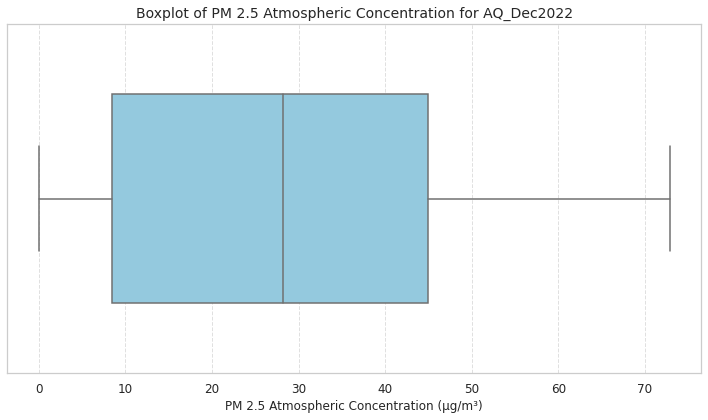

In [92]:
#BOXPLOT 

# Load the data from the CSV file
data = pd.read_csv("AQ_Jan2023.csv")

# Set the style of the plot using seaborn
sns.set(style="whitegrid")

# Create a boxplot for the "pm2.5_atm" column
plt.figure(figsize=(10, 6))
sns.boxplot(x=data["pm2.5_atm"], orient="h", color="skyblue", width=0.6)
plt.xlabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("Boxplot of PM 2.5 Atmospheric Concentration for AQ_Dec2022", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks([])
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()

plt.show()

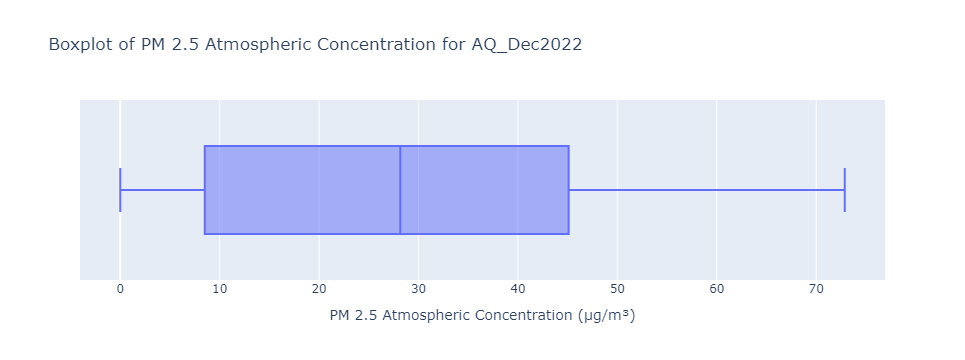

In [93]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_Jan2023.csv")

# Create an interactive boxplot with Plotly Express
fig = px.box(data, x="pm2.5_atm", title="Boxplot of PM 2.5 Atmospheric Concentration for AQ_Dec2022")
fig.update_layout(xaxis_title="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

#### Using Ruptures packag to detect Anamolies in PM2.5
Change-Point Detection in time series data 

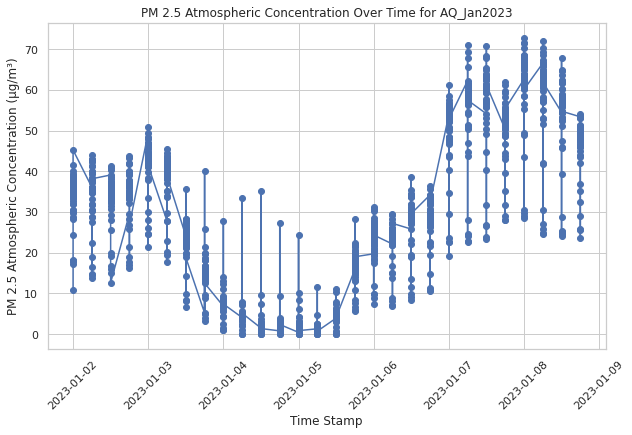

In [94]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the data from the CSV file
data = pd.read_csv("AQ_Jan2023.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Plot the "pm2.5_atm" over "time_stamp"
plt.figure(figsize=(10, 6))
plt.plot(data['time_stamp'], data['pm2.5_atm'], marker='o', linestyle='-')
plt.xlabel("Time Stamp")
plt.ylabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("PM 2.5 Atmospheric Concentration Over Time for AQ_Jan2023")
plt.xticks(rotation=45)
plt.grid(True)

plt.show()

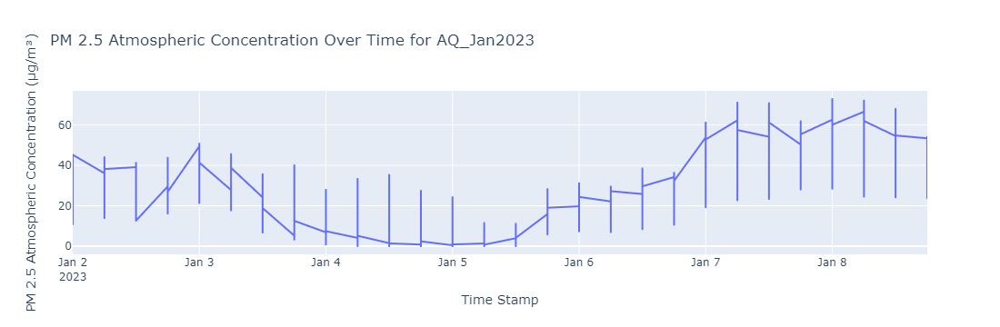

In [89]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_Jan2023.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Create an interactive time series plot with Plotly Express
fig = px.line(data, x="time_stamp", y="pm2.5_atm", title="PM 2.5 Atmospheric Concentration Over Time for AQ_Jan2023")
fig.update_xaxes(title_text="Time Stamp")
fig.update_yaxes(title_text="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

#### To get Sensor IDs with an average pm2.5_atm greater than 500 or any readings greater than 1004

In [100]:
import pandas as pd

# Load the data from the CSV file
data = pd.read_csv("AQ_Jan2023.csv")  # Replace with the actual file path

# Group by Sensor_ID and calculate the sum of pm2.5_atm and the count of all readings
sensor_stats = data.groupby("Sensor_ID").agg({
    "pm2.5_atm": ["sum", "mean", lambda x: any(x > 1004), "count"]
}).reset_index()

# Rename columns for clarity
sensor_stats.columns = ["Sensor_ID", "sum_pm2.5_atm", "avg_pm2.5_atm", "any_reading_gt_1004", "count_readings"]

# Filter sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
high_pm_sensors = sensor_stats[
    (sensor_stats["avg_pm2.5_atm"] > 500) | (sensor_stats["any_reading_gt_1004"])
]["Sensor_ID"]

# Display the sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
print("Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004:", high_pm_sensors.tolist())

Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004: []


#### Drop sensor IDs as [145242,3088, 43305, 77405, 157845]

In [124]:
# Load the data from the CSV file
data = pd.read_csv("AQ_Jan2023.csv")

# Drop rows with Sensor_IDs 77405 and 145242
data_updated = data[~data['Sensor_ID'].isin([145242,3088, 43305, 77405, 157845])]

# Save the updated DataFrame to a new CSV file
data_updated.to_csv("AQ_Jan2023_updated.csv", index=False)

#### Creating Animated Scatter Plot 

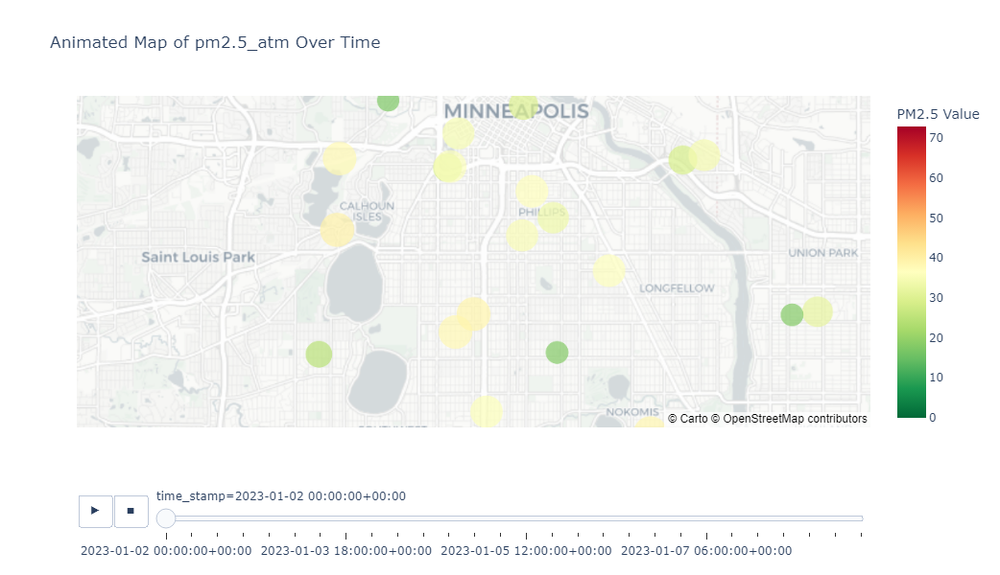

In [125]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('AQ_Jan2023_updated.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Compute the maximum PM2.5 value across all timestamps
max_pm25_global = df['pm2.5_atm'].max()

# Compute the color scale range based on the dataset values
color_scale_range = [df['pm2.5_atm'].min(), df['pm2.5_atm'].max()]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r',
                        range_color=color_scale_range,
                        size_max=35,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron",
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,
    width=800
)

# Customize the colorbar legend
fig.update_layout(coloraxis_colorbar=dict(title='PM2.5 Value'))

# Show the map
fig.show()

## SPRING SEASON

In [63]:
## APRIL 2023

import pandas as pd
import os

# Load the sensor locations data from "sensor_within5m_buffer.csv" into a DataFrame
sensor_locations_df = pd.read_csv("Sensors in Mpls_ETL.csv")

# Define the directory where the CSV files are located
directory = "./AQ_Data/AQ_Apr2023"

# Create an empty list to store the DataFrames
dfs = []

# Iterate over each file in the specified directory
for filename in os.listdir(directory):
    # Check if the file has a ".csv" extension
    if filename.endswith(".csv"):
        # Create the full file path by joining the directory and filename
        file_path = os.path.join(directory, filename)

        # Check if the file is not empty (has a size greater than 0 bytes)
        if os.path.getsize(file_path) > 0:
            # Extract the sensor ID from the filename
            Sensor_ID = filename.split()[0]

            # Read the CSV file into a pandas DataFrame
            df = pd.read_csv(file_path)

            # Add a new column "Sensor_ID" to the DataFrame
            df["Sensor_ID"] = Sensor_ID

            # Append the DataFrame to the list of DataFrames
            dfs.append(df)
        else:
            # Print a message indicating that an empty file was skipped
            print(f"Skipped empty file: {filename}")

# Concatenate all the DataFrames in the list into a single DataFrame
combined_df = pd.concat(dfs, ignore_index=True)

# Convert the "Sensor_ID" column in the sensor_locations_df DataFrame to a string data type using the astype() method
sensor_locations_df["Sensor_ID"] = sensor_locations_df["Sensor_ID"].astype(str)

# Perform an inner join between sensor_locations_df and combined_df on the "Sensor_ID" column
merged_df = pd.merge(sensor_locations_df, combined_df, on="Sensor_ID", how="inner")

# Sort the merged DataFrame by the "time_stamp" column
merged_df = merged_df.sort_values("time_stamp")

# Save the merged DataFrame to a CSV file named "AQ_Apr2023.csv" without including the index column
merged_df.to_csv("AQ_Apr2023.csv", index=False)

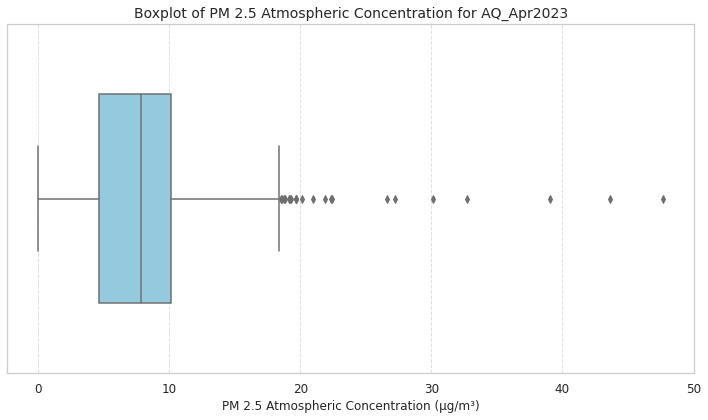

In [64]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns  # Import seaborn for better visual styles

# Load the data from the CSV file
data = pd.read_csv("AQ_Apr2023.csv")

# Set the style of the plot using seaborn
sns.set(style="whitegrid")

# Create a boxplot for the "pm2.5_atm" column
plt.figure(figsize=(10, 6))
sns.boxplot(x=data["pm2.5_atm"], orient="h", color="skyblue", width=0.6)
plt.xlabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("Boxplot of PM 2.5 Atmospheric Concentration for AQ_Apr2023", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks([])
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()

plt.show()

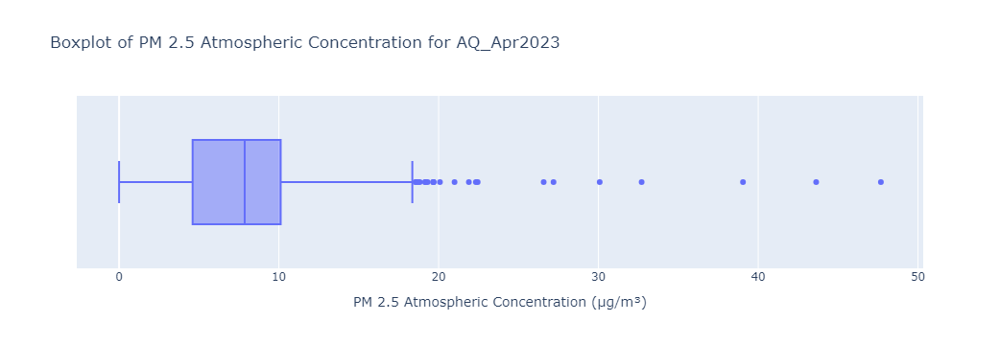

In [65]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_Apr2023.csv")

# Create an interactive boxplot with Plotly Express
fig = px.box(data, x="pm2.5_atm", title="Boxplot of PM 2.5 Atmospheric Concentration for AQ_Apr2023")
fig.update_layout(xaxis_title="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

#### Using Ruptures package to detect Anomalies in PM2.5
Change-Point Detection in time series data 

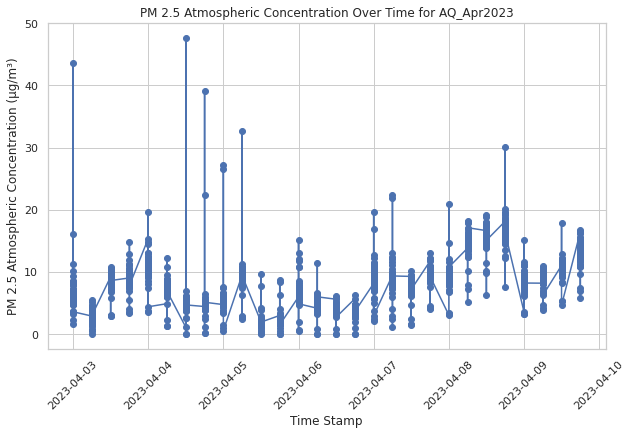

In [66]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the data from the CSV file
data = pd.read_csv("AQ_Apr2023.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Plot the "pm2.5_atm" over "time_stamp"
plt.figure(figsize=(10, 6))
plt.plot(data['time_stamp'], data['pm2.5_atm'], marker='o', linestyle='-')
plt.xlabel("Time Stamp")
plt.ylabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("PM 2.5 Atmospheric Concentration Over Time for AQ_Apr2023")
plt.xticks(rotation=45)
plt.grid(True)

plt.show()

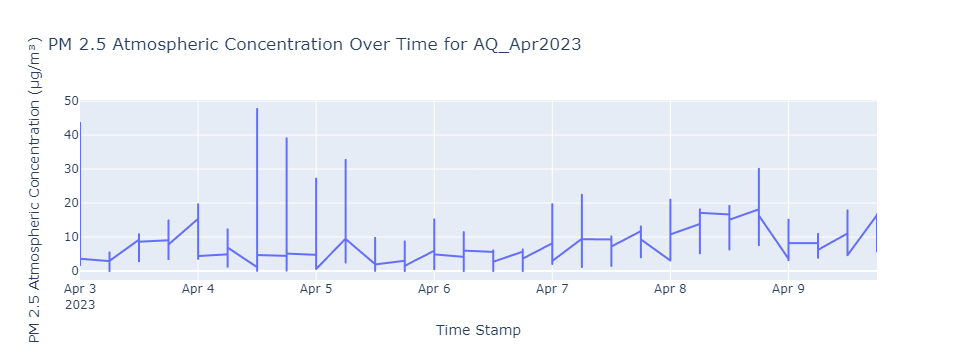

In [67]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_Apr2023.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Create an interactive time series plot with Plotly Express
fig = px.line(data, x="time_stamp", y="pm2.5_atm", title="PM 2.5 Atmospheric Concentration Over Time for AQ_Apr2023")
fig.update_xaxes(title_text="Time Stamp")
fig.update_yaxes(title_text="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

#### To get Sensor IDs with an average pm2.5_atm greater than 500 or any readings greater than 1004

In [101]:
import pandas as pd

# Load the data from the CSV file
data = pd.read_csv("AQ_Apr2023.csv")  # Replace with the actual file path

# Group by Sensor_ID and calculate the sum of pm2.5_atm and the count of all readings
sensor_stats = data.groupby("Sensor_ID").agg({
    "pm2.5_atm": ["sum", "mean", lambda x: any(x > 1004), "count"]
}).reset_index()

# Rename columns for clarity
sensor_stats.columns = ["Sensor_ID", "sum_pm2.5_atm", "avg_pm2.5_atm", "any_reading_gt_1004", "count_readings"]

# Filter sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
high_pm_sensors = sensor_stats[
    (sensor_stats["avg_pm2.5_atm"] > 500) | (sensor_stats["any_reading_gt_1004"])
]["Sensor_ID"]

# Display the sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
print("Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004:", high_pm_sensors.tolist())

Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004: []


#### Drop sensor IDs as [157871, 3088, 43305, 77405, 157845]

In [126]:
# Load the data from the CSV file
data = pd.read_csv("AQ_Apr2023.csv")

# Drop rows with Sensor_IDs 77405 and 145242
data_updated = data[~data['Sensor_ID'].isin([157871, 3088, 43305, 77405, 157845])]

# Save the updated DataFrame to a new CSV file
data_updated.to_csv("AQ_Apr2023_updated.csv", index=False)

#### Animated Scatter Plot with Legends Changing

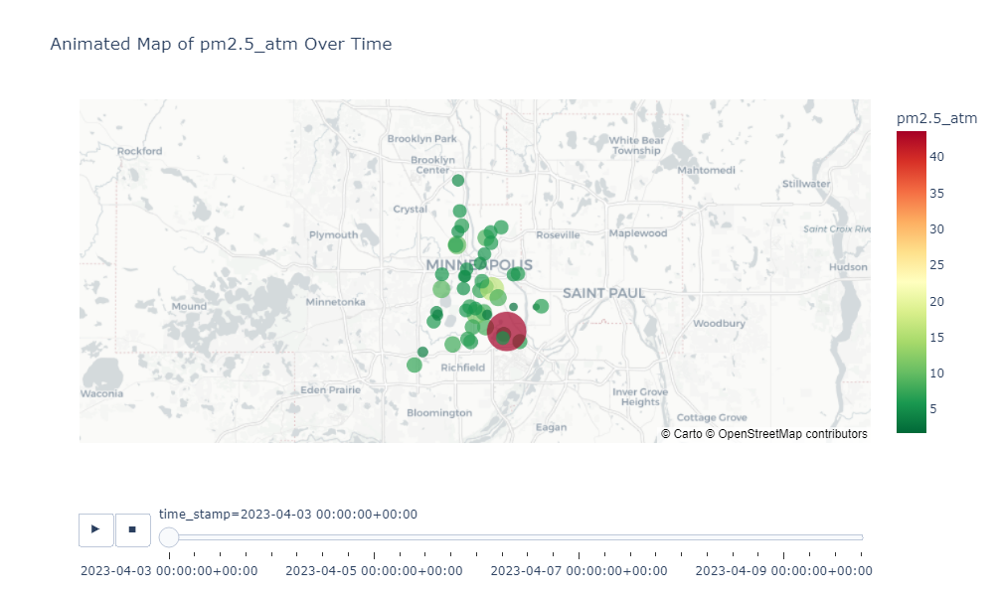

In [70]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('AQ_Apr2023_updated.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r', #Other options: Viridis, Inferno, Magma, Jet.  #use _r to reverse the legends
                        size_max=30,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron", #Other options: white-bg, carto-darkmatter, open-street-map
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9  # Adjust the zoom level as needed
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,  # Adjust the height as needed
    width=800    # Adjust the width as needed
)

# Show the map
fig.show()

#### Animated Scatter Plot with Fixed Legends 

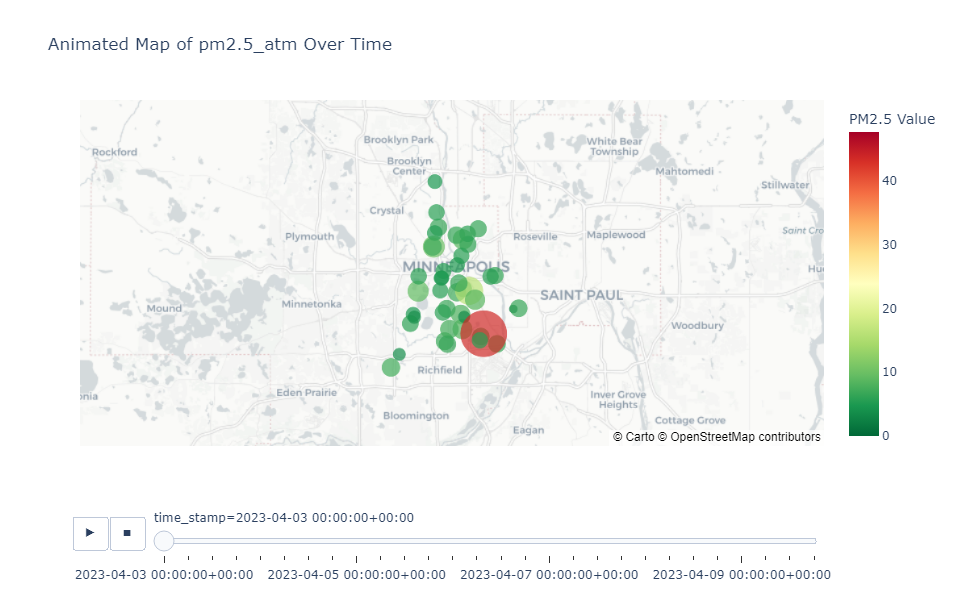

In [127]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('AQ_Apr2023_updated.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Compute the maximum PM2.5 value across all timestamps
max_pm25_global = df['pm2.5_atm'].max()

# Compute the color scale range based on the dataset values
color_scale_range = [df['pm2.5_atm'].min(), df['pm2.5_atm'].max()]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r',
                        range_color=color_scale_range,
                        size_max=35,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron",
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,
    width=800
)

# Customize the colorbar legend
fig.update_layout(coloraxis_colorbar=dict(title='PM2.5 Value'))

# Show the map
fig.show()

#### K-Means Clustering

[1 5 6 4 2 3]


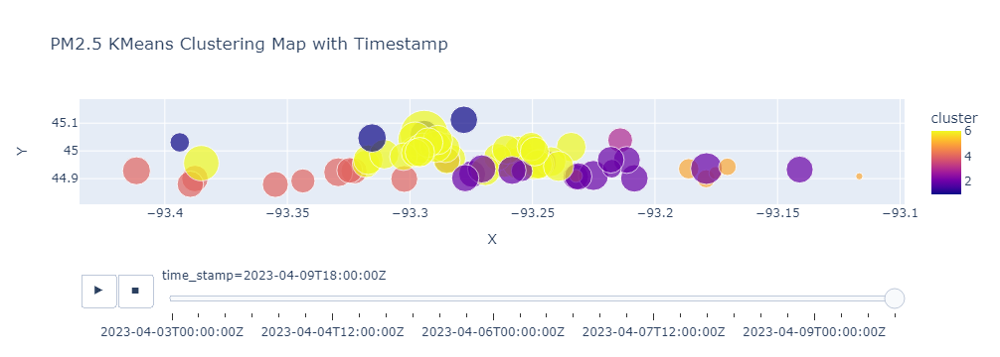

In [7]:
import pandas as pd # for data manipulation and analysis
import plotly.express as px # for creating interactive visualizations
from sklearn.preprocessing import StandardScaler # for standardizing the features
from sklearn.cluster import KMeans # for performing KMeans clustering

# Load CSV data
df = pd.read_csv('AQ_Apr2023_updated.csv')

# Extract relevant columns
data = df[['X', 'Y', 'pm2.5_atm']]

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

# Perform K-Means Clustering with 6 clusters
kmeans = KMeans(n_clusters=6, random_state=42)
df['cluster'] = kmeans.fit_predict(data_scaled) + 1 # Adding 1 to make clusters start from 1

# Create an interactive scatter plot with time
fig = px.scatter(df, x='X', y='Y', color='cluster', size='pm2.5_atm',
                 animation_frame='time_stamp', title='PM2.5 KMeans Clustering Map with Timestamp',
                 labels={'pm2.5_atm': 'PM2.5 Level'}, size_max=50, opacity=0.7)

# Increase the height of the plot
fig.update_layout(height=600)

print(df['cluster'].unique())

# Show the plot
fig.show()

##### Agglomerative Clustering

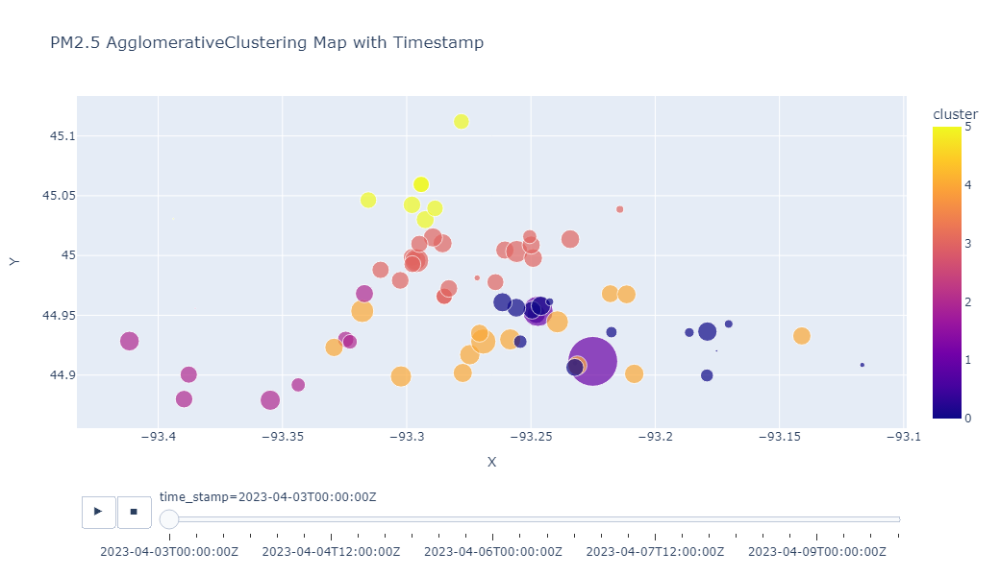

In [244]:
import pandas as pd # for data manipulation and analysis
import plotly.express as px # for creating interactive visualizations
from sklearn.preprocessing import StandardScaler # for standardizing the features
from sklearn.cluster import AgglomerativeClustering # for performing agglomerative clustering


# Load CSV data
df = pd.read_csv('AQ_Apr2023_updated.csv')

# Extract relevant columns
data = df[['X', 'Y', 'pm2.5_atm']]

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

# Perform Agglomerative Clustering with 6 clusters
agglomerative = AgglomerativeClustering(n_clusters=6)
df['cluster'] = agglomerative.fit_predict(data_scaled)

# Create an interactive scatter plot with time
fig = px.scatter(df, x='X', y='Y', color='cluster', size='pm2.5_atm',
                 animation_frame='time_stamp', title='PM2.5 AgglomerativeClustering Map with Timestamp',
                 labels={'pm2.5_atm': 'PM2.5 Level'}, size_max=50, opacity=0.7)

# Increase the height of the plot
fig.update_layout(height=600)

# Show the plot
fig.show()

#### Cluster Classification And Identfying Sensors with Average PM2.5 > 500

In [81]:
import pandas as pd
from sklearn.cluster import KMeans

# Load the data from the CSV file
data = pd.read_csv("AQ_Apr2023_updated.csv")  # Replace with the actual file path

# Extract the "pm2.5_atm" column for clustering
X = data[["pm2.5_atm"]]

# Perform k-means clustering
kmeans = KMeans(n_clusters=6, random_state=42)
data["cluster"] = kmeans.fit_predict(X)

# Reclassify based on specified ranges
reclassification_mapping = {
    0: 'C1 (<12)',
    1: 'C2 (12.1-35.4)',
    2: 'C3 (35.5-55.4)',
    3: 'C4 (>55.4)',
    4: 'C5 (150.4-500)',
    5: 'C6 (>500)',
}

data["reclassified_cluster"] = data["cluster"].map(reclassification_mapping)

# Display the resulting DataFrame with cluster and reclassified_cluster columns
print(data[["pm2.5_atm", "cluster", "reclassified_cluster"]])

# Save the resulting DataFrame to a new CSV file
output_csv_path = "output_data.csv"  # Replace with your desired file path
data.to_csv(output_csv_path, index=False)

      pm2.5_atm  cluster reclassified_cluster
0        0.0435        4       C5 (150.4-500)
1        0.5540        4       C5 (150.4-500)
2       43.6255        5            C6 (>500)
3        4.7775        0             C1 (<12)
4        7.3265        1       C2 (12.1-35.4)
...         ...      ...                  ...
2007    12.9890        2       C3 (35.5-55.4)
2008    11.7535        1       C2 (12.1-35.4)
2009    12.4855        1       C2 (12.1-35.4)
2010    14.2385        2       C3 (35.5-55.4)
2011     0.8550        4       C5 (150.4-500)

[2012 rows x 3 columns]


In [247]:
import pandas as pd
from sklearn.cluster import KMeans

# Load the data from the CSV file
data = pd.read_csv("AQ_Apr2023_updated.csv")  # Replace with the actual file path

# Extract the "pm2.5_atm" column for clustering
X = data[["pm2.5_atm"]]

# Perform k-means clustering
kmeans = KMeans(n_clusters=6, random_state=42)
data["cluster"] = kmeans.fit_predict(X) + 1

# Reclassify based on specified ranges
reclassification_mapping = {
    0: 'C1 (<12)',
    1: 'C2 (12.1-35.4)',
    2: 'C3 (35.5-55.4)',
    3: 'C4 (55.5-150.3)',
    4: 'C5 (150.4-500)',
    5: 'C6 (>500)',
}

data["reclassified_cluster"] = data["cluster"].map(reclassification_mapping)

# Display the resulting DataFrame with cluster and reclassified_cluster columns
print(data[["pm2.5_atm", "cluster", "reclassified_cluster"]])

# Save the resulting DataFrame to a new CSV file
output_csv_path = "AQ_Apr2023_updated1.csv"  # Replace with your desired file path
data.to_csv(output_csv_path, index=False)

      pm2.5_atm  cluster reclassified_cluster
0        0.0435        1       C2 (12.1-35.4)
1        0.5540        1       C2 (12.1-35.4)
2       43.6255        4       C5 (150.4-500)
3        4.7775        6                  NaN
4        7.3265        3      C4 (55.5-150.3)
...         ...      ...                  ...
1951    12.9890        2       C3 (35.5-55.4)
1952    11.7535        3      C4 (55.5-150.3)
1953    12.4855        3      C4 (55.5-150.3)
1954    14.2385        2       C3 (35.5-55.4)
1955     0.8550        1       C2 (12.1-35.4)

[1956 rows x 3 columns]


## SUMMER SEASON

### JULY 2022 (Not Part of Analysis)

In [29]:
import pandas as pd
import os

# Load the sensor locations data into a DataFrame
sensor_locations_df = pd.read_csv("Sensors in Mpls_ETL.csv")

# Define the directory where the CSV files are located
directory = "./AQ_Data/AQ_July2022"

# Create an empty list to store the dataframes
dfs = []

# Iterate over each file in the directory
for filename in os.listdir(directory):
    # Check if the file is a CSV file
    if filename.endswith(".csv"):
        file_path = os.path.join(directory, filename)
        # Check if the file is empty
        if os.path.getsize(file_path) > 0:
            # Extract the sensor ID from the filename
            Sensor_ID = filename.split()[0]
            
            # Load the CSV file into a pandas DataFrame
            df = pd.read_csv(file_path)
            
            # Add a new column with the sensor ID
            df["Sensor_ID"] = Sensor_ID
            
            # Append the DataFrame to the list
            dfs.append(df)
        else:
            print(f"Skipped empty file: {filename}")

# Concatenate all the dataframes in the list
combined_df = pd.concat(dfs, ignore_index=True)

# converting the "Sensor_ID" column in the sensor_locations_df dataframe to a string data type using the astype() method
sensor_locations_df["Sensor_ID"] = sensor_locations_df["Sensor_ID"].astype(str)

# Perform a left join between SensorLocations_HennepinCounty and combined_df on sensor_id
merged_df = pd.merge(sensor_locations_df, combined_df, on="Sensor_ID", how="inner")

# Sort by the time_stamp column
merged_df = merged_df.sort_values("time_stamp")

merged_df.to_csv("AQ_July2022.csv", index=False)

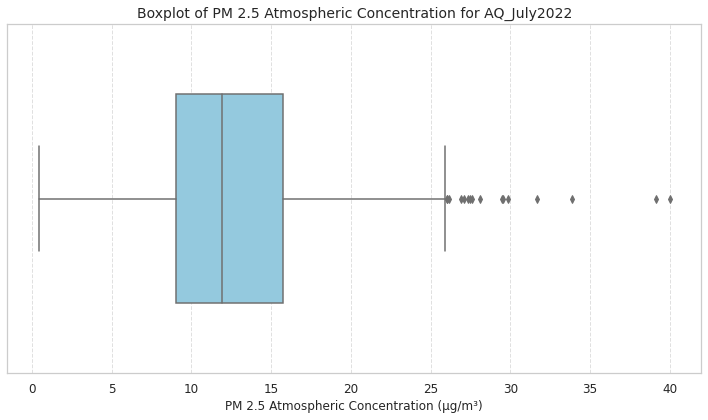

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns  # Import seaborn for better visual styles

# Load the data from the CSV file
data = pd.read_csv("AQ_July2022.csv")

# Set the style of the plot using seaborn
sns.set(style="whitegrid")

# Create a boxplot for the "pm2.5_atm" column
plt.figure(figsize=(10, 6))
sns.boxplot(x=data["pm2.5_atm"], orient="h", color="skyblue", width=0.6)
plt.xlabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("Boxplot of PM 2.5 Atmospheric Concentration for AQ_July2022", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks([])
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()

plt.show()

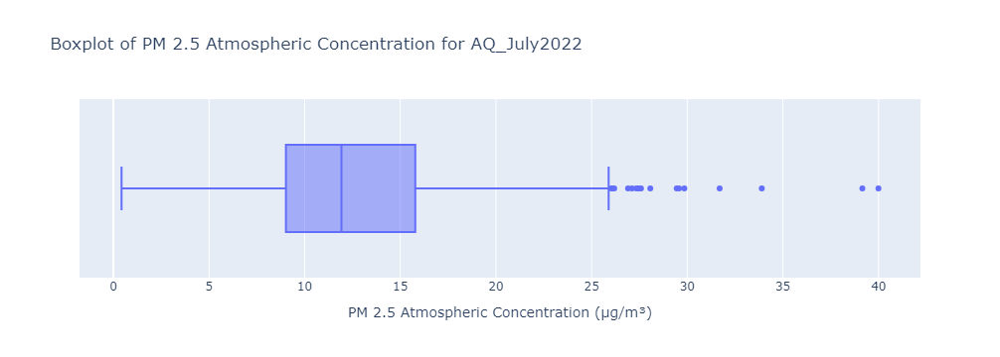

In [31]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_July2022.csv")

# Create an interactive boxplot with Plotly Express
fig = px.box(data, x="pm2.5_atm", title="Boxplot of PM 2.5 Atmospheric Concentration for AQ_July2022")
fig.update_layout(xaxis_title="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

##### Using Ruptures packag to detect Anamolies in PM2.5
Change-Point Detection in time series data 

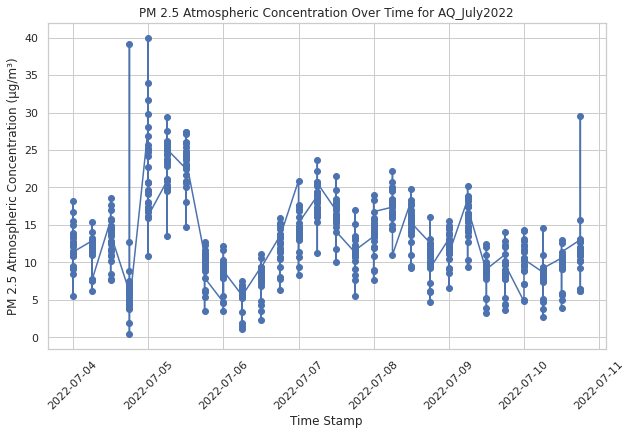

In [32]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the data from the CSV file
data = pd.read_csv("AQ_July2022.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Plot the "pm2.5_atm" over "time_stamp"
plt.figure(figsize=(10, 6))
plt.plot(data['time_stamp'], data['pm2.5_atm'], marker='o', linestyle='-')
plt.xlabel("Time Stamp")
plt.ylabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("PM 2.5 Atmospheric Concentration Over Time for AQ_July2022")
plt.xticks(rotation=45)
plt.grid(True)

plt.show()

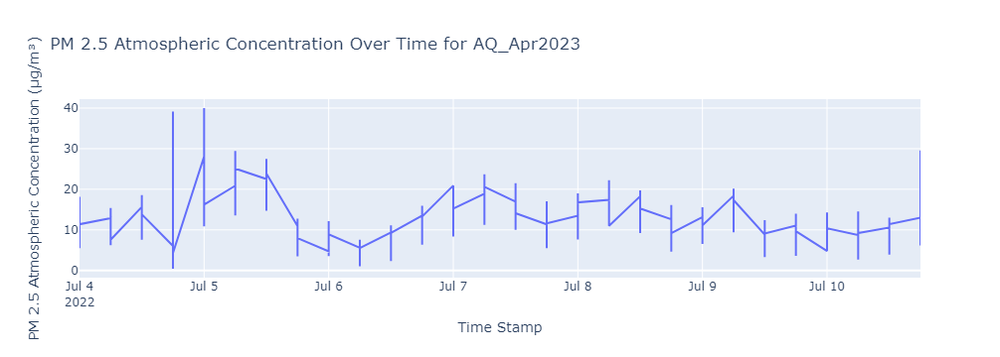

In [33]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_July2022.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Create an interactive time series plot with Plotly Express
fig = px.line(data, x="time_stamp", y="pm2.5_atm", title="PM 2.5 Atmospheric Concentration Over Time for AQ_Apr2023")
fig.update_xaxes(title_text="Time Stamp")
fig.update_yaxes(title_text="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

#### To get Sensor IDs with an average pm2.5_atm greater than 500.

In [34]:
import pandas as pd

# Load the data from the CSV file
data = pd.read_csv("AQ_July2022.csv")  # Replace with the actual file path

# Group by Sensor_ID and calculate the sum of pm2.5_atm and the count of all readings
sensor_stats = data.groupby("Sensor_ID").agg({
    "pm2.5_atm": ["sum", "count"]
}).reset_index()

# Rename columns for clarity
sensor_stats.columns = ["Sensor_ID", "sum_pm2.5_atm", "count_readings"]

# Calculate the sum of pm2.5_atm / count for each sensor
sensor_stats["avg_pm2.5_atm"] = sensor_stats["sum_pm2.5_atm"] / sensor_stats["count_readings"]

# Filter sensors with average pm2.5_atm greater than 500
high_pm_sensors = sensor_stats[sensor_stats["avg_pm2.5_atm"] > 500]["Sensor_ID"]

# Display the sensors with average pm2.5_atm greater than 500
print("Sensor IDs with average pm2.5_atm greater than 500:", high_pm_sensors.tolist())

Sensor IDs with average pm2.5_atm greater than 500: []


#### Drop sensor IDs as [77405, 145242]

In [35]:
# Load the data from the CSV file
data = pd.read_csv("AQ_July2022.csv")

# Drop rows with Sensor_IDs 77405 and 145242
data_updated = data[~data['Sensor_ID'].isin([77405, 145242])]

# Save the updated DataFrame to a new CSV file
data_updated.to_csv("AQ_July2022_updated.csv", index=False)

#### Creating Animated Scatter Plot 

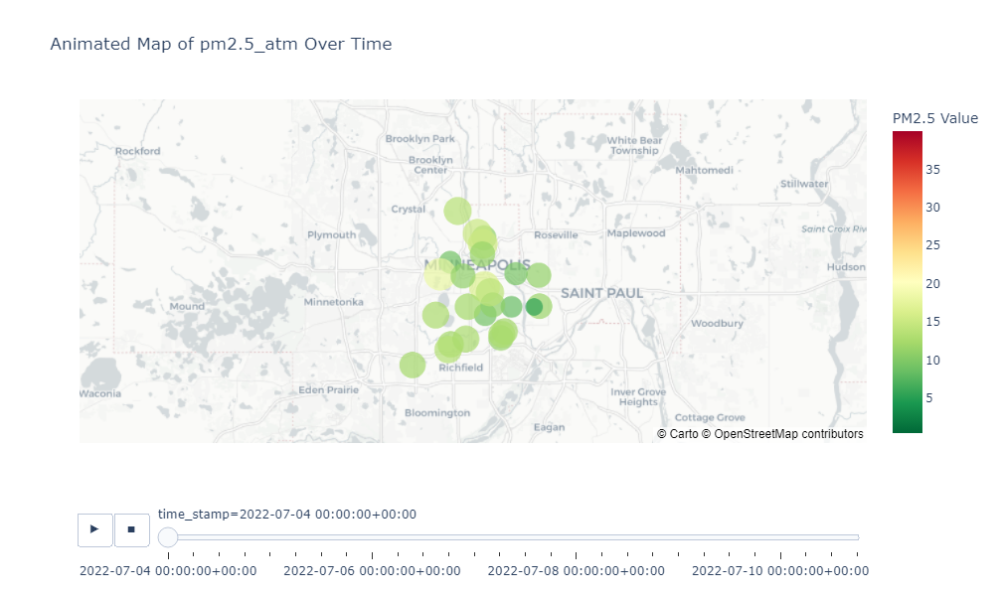

In [36]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('AQ_July2022.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Compute the maximum PM2.5 value across all timestamps
max_pm25_global = df['pm2.5_atm'].max()

# Compute the color scale range based on the dataset values
color_scale_range = [df['pm2.5_atm'].min(), df['pm2.5_atm'].max()]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r',
                        range_color=color_scale_range,
                        size_max=35,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron",
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,
    width=800
)

# Customize the colorbar legend
fig.update_layout(coloraxis_colorbar=dict(title='PM2.5 Value'))

# Show the map
fig.show()

### JULY 2023
Sensors with Incorrect readings: 108274, 157871

In [72]:
import pandas as pd
import os

# Load the sensor locations data into a DataFrame
sensor_locations_df = pd.read_csv("Sensors in Mpls_ETL.csv")

# Define the directory where the CSV files are located
directory = "./AQ_Data/AQ_July2023"

# Create an empty list to store the dataframes
dfs = []

# Iterate over each file in the directory
for filename in os.listdir(directory):
    # Check if the file is a CSV file
    if filename.endswith(".csv"):
        file_path = os.path.join(directory, filename)
        # Check if the file is empty
        if os.path.getsize(file_path) > 0:
            # Extract the sensor ID from the filename
            Sensor_ID = filename.split()[0]
            
            # Load the CSV file into a pandas DataFrame
            df = pd.read_csv(file_path)
            
            # Add a new column with the sensor ID
            df["Sensor_ID"] = Sensor_ID
            
            # Append the DataFrame to the list
            dfs.append(df)
        else:
            print(f"Skipped empty file: {filename}")

# Concatenate all the dataframes in the list
combined_df = pd.concat(dfs, ignore_index=True)

# converting the "Sensor_ID" column in the sensor_locations_df dataframe to a string data type using the astype() method
sensor_locations_df["Sensor_ID"] = sensor_locations_df["Sensor_ID"].astype(str)

# Perform a left join between SensorLocations_HennepinCounty and combined_df on sensor_id
merged_df = pd.merge(sensor_locations_df, combined_df, on="Sensor_ID", how="inner")

# Sort by the time_stamp column
merged_df = merged_df.sort_values("time_stamp")

merged_df.to_csv("AQ_July2023.csv", index=False)

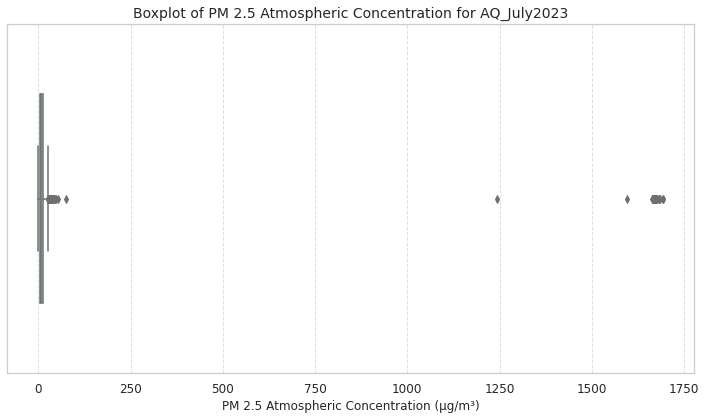

In [73]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns  # Import seaborn for better visual styles

# Load the data from the CSV file
data = pd.read_csv("AQ_July2023.csv")

# Set the style of the plot using seaborn
sns.set(style="whitegrid")

# Create a boxplot for the "pm2.5_atm" column
plt.figure(figsize=(10, 6))
sns.boxplot(x=data["pm2.5_atm"], orient="h", color="skyblue", width=0.6)
plt.xlabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("Boxplot of PM 2.5 Atmospheric Concentration for AQ_July2023", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks([])
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()

plt.show()

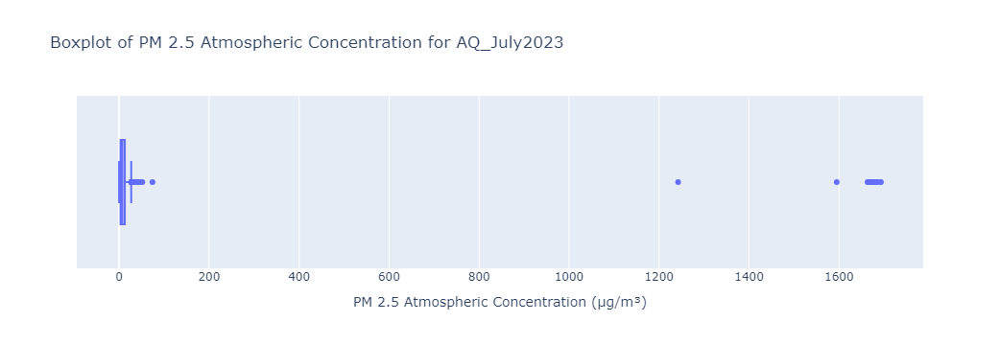

In [74]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_July2023.csv")

# Create an interactive boxplot with Plotly Express
fig = px.box(data, x="pm2.5_atm", title="Boxplot of PM 2.5 Atmospheric Concentration for AQ_July2023")
fig.update_layout(xaxis_title="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

#### To get Sensor IDs with an average pm2.5_atm greater than 500.

In [105]:
import pandas as pd

# Load the data from the CSV file
data = pd.read_csv("AQ_July2023.csv")  # Replace with the actual file path

# Group by Sensor_ID and calculate the sum of pm2.5_atm and the count of all readings
sensor_stats = data.groupby("Sensor_ID").agg({
    "pm2.5_atm": ["sum", "mean", lambda x: any(x > 1004), "count"]
}).reset_index()

# Rename columns for clarity
sensor_stats.columns = ["Sensor_ID", "sum_pm2.5_atm", "avg_pm2.5_atm", "any_reading_gt_1004", "count_readings"]

# Filter sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
high_pm_sensors = sensor_stats[
    (sensor_stats["avg_pm2.5_atm"] > 500) | (sensor_stats["any_reading_gt_1004"])
]["Sensor_ID"]

# Display the sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
print("Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004:", high_pm_sensors.tolist())

Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004: [3088, 157871]


#### Drop rows with Sensor_IDs [157871, 3088, 43305, 77405, 157845]

In [13]:
# Load the data from the CSV file
data = pd.read_csv("AQ_July2023.csv")

# Drop rows with Sensor_IDs 77405 and 145242
data_updated = data[~data['Sensor_ID'].isin([157871, 3088, 43305, 77405, 157845])]

# Save the updated DataFrame to a new CSV file
data_updated.to_csv("AQ_July2023_updated.csv", index=False)

#### Animated Scatter Plot

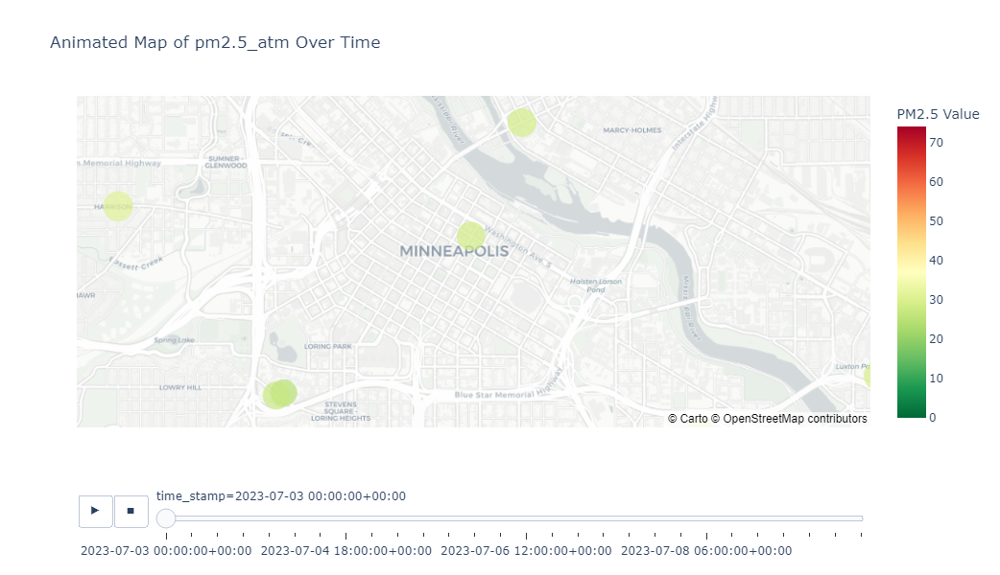

In [123]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('AQ_July2023_updated.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Compute the maximum PM2.5 value across all timestamps
max_pm25_global = df['pm2.5_atm'].max()

# Compute the color scale range based on the dataset values
color_scale_range = [df['pm2.5_atm'].min(), df['pm2.5_atm'].max()]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r',
                        range_color=color_scale_range,
                        size_max=35,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron",
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,
    width=800
)

# Customize the colorbar legend
fig.update_layout(coloraxis_colorbar=dict(title='PM2.5 Value'))

# Show the map
fig.show()

### JULY 2023 2nd week

In [4]:
import pandas as pd
import os

# Load the sensor locations data into a DataFrame
sensor_locations_df = pd.read_csv("Sensors in Mpls_ETL.csv")

# Define the directory where the CSV files are located
directory = "./AQ_Data/AQ_July2023_2ndwk"

# Create an empty list to store the dataframes
dfs = []

# Iterate over each file in the directory
for filename in os.listdir(directory):
    # Check if the file is a CSV file
    if filename.endswith(".csv"):
        file_path = os.path.join(directory, filename)
        # Check if the file is empty
        if os.path.getsize(file_path) > 0:
            # Extract the sensor ID from the filename
            Sensor_ID = filename.split()[0]
            
            # Load the CSV file into a pandas DataFrame
            df = pd.read_csv(file_path)
            
            # Add a new column with the sensor ID
            df["Sensor_ID"] = Sensor_ID
            
            # Append the DataFrame to the list
            dfs.append(df)
        else:
            print(f"Skipped empty file: {filename}")

# Concatenate all the dataframes in the list
combined_df = pd.concat(dfs, ignore_index=True)

# converting the "Sensor_ID" column in the sensor_locations_df dataframe to a string data type using the astype() method
sensor_locations_df["Sensor_ID"] = sensor_locations_df["Sensor_ID"].astype(str)

# Perform a left join between SensorLocations_HennepinCounty and combined_df on sensor_id
merged_df = pd.merge(sensor_locations_df, combined_df, on="Sensor_ID", how="inner")

# Sort by the time_stamp column
merged_df = merged_df.sort_values("time_stamp")

merged_df.to_csv("AQ_July2023_2ndwk.csv", index=False)

Skipped empty file: 194635 2023-07-10 2023-07-17 360-Minute Average.csv
Skipped empty file: 143248 2023-07-10 2023-07-17 360-Minute Average.csv
Skipped empty file: 166459 2023-07-10 2023-07-17 360-Minute Average.csv
Skipped empty file: 142742 2023-07-10 2023-07-17 360-Minute Average.csv


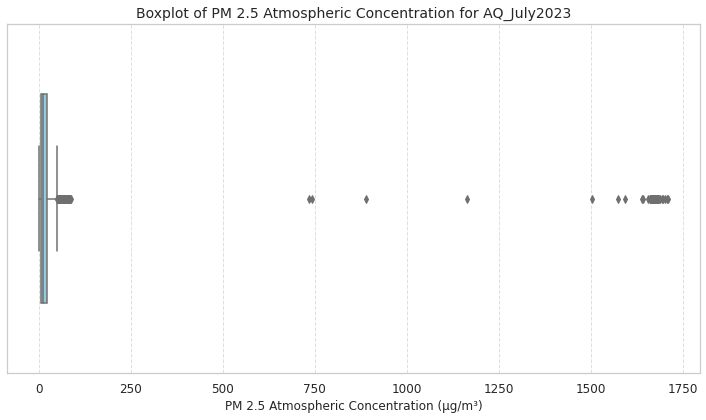

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns  # Import seaborn for better visual styles

# Load the data from the CSV file
data = pd.read_csv("AQ_July2023_2ndwk.csv")

# Set the style of the plot using seaborn
sns.set(style="whitegrid")

# Create a boxplot for the "pm2.5_atm" column
plt.figure(figsize=(10, 6))
sns.boxplot(x=data["pm2.5_atm"], orient="h", color="skyblue", width=0.6)
plt.xlabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("Boxplot of PM 2.5 Atmospheric Concentration for AQ_July2023", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks([])
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()

plt.show()

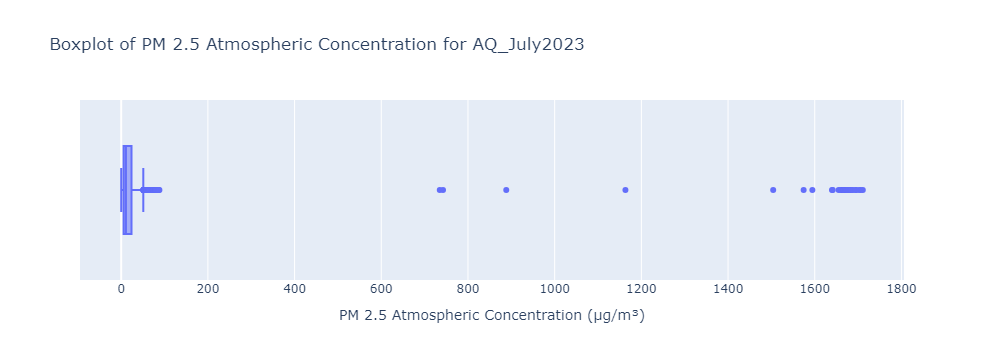

In [6]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_July2023_2ndwk.csv")

# Create an interactive boxplot with Plotly Express
fig = px.box(data, x="pm2.5_atm", title="Boxplot of PM 2.5 Atmospheric Concentration for AQ_July2023")
fig.update_layout(xaxis_title="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

#### To get Sensor IDs with an average pm2.5_atm greater than 500.

In [7]:
import pandas as pd

# Load the data from the CSV file
data = pd.read_csv("AQ_July2023_2ndwk.csv")  # Replace with the actual file path

# Group by Sensor_ID and calculate the sum of pm2.5_atm and the count of all readings
sensor_stats = data.groupby("Sensor_ID").agg({
    "pm2.5_atm": ["sum", "mean", lambda x: any(x > 1004), "count"]
}).reset_index()

# Rename columns for clarity
sensor_stats.columns = ["Sensor_ID", "sum_pm2.5_atm", "avg_pm2.5_atm", "any_reading_gt_1004", "count_readings"]

# Filter sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
high_pm_sensors = sensor_stats[
    (sensor_stats["avg_pm2.5_atm"] > 500) | (sensor_stats["any_reading_gt_1004"])
]["Sensor_ID"]

# Display the sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
print("Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004:", high_pm_sensors.tolist())

Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004: [3088, 77405, 145242, 157871]


#### Drop rows with Sensor_IDs [157871, 3088, 43305, 145242, 77405, 157845]

In [8]:
# Load the data from the CSV file
data = pd.read_csv("AQ_July2023_2ndwk.csv")

# Drop rows with Sensor_IDs 77405 and 145242
data_updated = data[~data['Sensor_ID'].isin([157871, 3088, 43305, 77405, 145242, 157845])]

# Save the updated DataFrame to a new CSV file
data_updated.to_csv("AQ_July2023_2ndwk_updated.csv", index=False)

#### Animated Scatter Plot

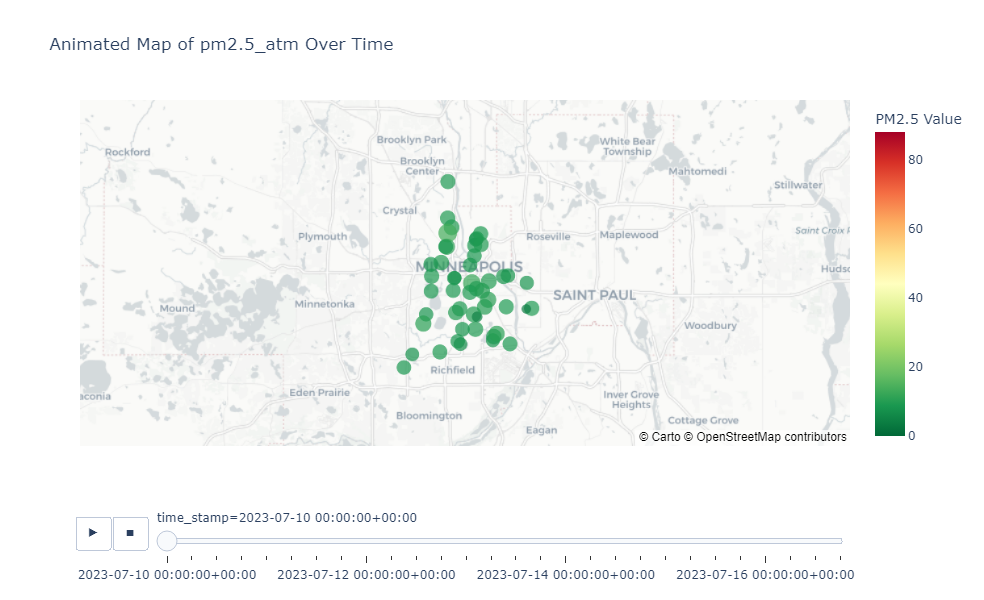

In [9]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('AQ_July2023_2ndwk_updated.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Compute the maximum PM2.5 value across all timestamps
max_pm25_global = df['pm2.5_atm'].max()

# Compute the color scale range based on the dataset values
color_scale_range = [df['pm2.5_atm'].min(), df['pm2.5_atm'].max()]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r',
                        range_color=color_scale_range,
                        size_max=35,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron",
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,
    width=800
)

# Customize the colorbar legend
fig.update_layout(coloraxis_colorbar=dict(title='PM2.5 Value'))

# Show the map
fig.show()

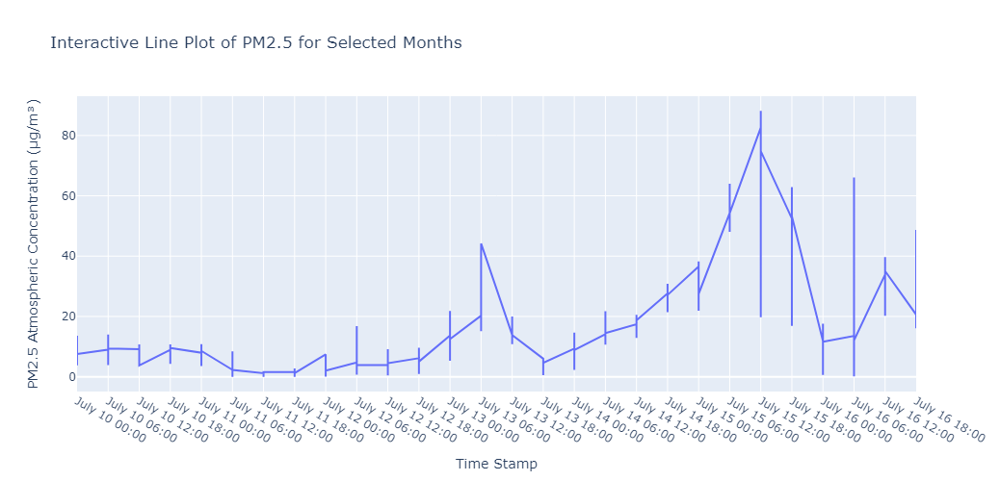

In [12]:
import plotly.graph_objects as go
import pandas as pd

# Load the CSV data
csv_path = 'AQ_July2023_2ndwk_updated.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Extract month and day information
df['month'] = df['time_stamp'].dt.month
df['day'] = df['time_stamp'].dt.day

# Filter data for specific months (e.g., January, April, July, October)
selected_months = [1, 4, 7, 10]
filtered_df = df[df['month'].isin(selected_months)]

# Create an interactive line plot
fig = go.Figure()

# Add scatter traces for each point with hover text
for month, data in filtered_df.groupby('month'):
    month_name = data['time_stamp'].dt.strftime('%B').iloc[0]  # Get full month name
    hover_text = data['time_stamp'].dt.strftime('%B %d %H:%M')  # Format hover text
    fig.add_trace(go.Scatter(x=data['time_stamp'], y=data['pm2.5_atm'], mode='lines', name=month_name, text=hover_text))

# Customize the layout
fig.update_layout(
    xaxis=dict(title='Time Stamp', type='category'),
    yaxis=dict(title='PM2.5 Atmospheric Concentration (µg/m³)'),
    title='Interactive Line Plot of PM2.5 for Selected Months',
    width=800, height=500,
    hovermode='x',  # Show hover information on x-axis
)

# Set the x-axis tick values and labels for the selected months
fig.update_xaxes(
    tickvals=filtered_df['time_stamp'].unique(),
    ticktext=filtered_df['time_stamp'].dt.strftime('%B %d %H:%M').unique()
)

# Show the interactive plot
fig.show()

## FALL SEASON

### OCTOBER 2022 (Not part of Analysis)

In [51]:
import pandas as pd
import os

# Load the sensor locations data into a DataFrame
sensor_locations_df = pd.read_csv("Sensors in Mpls_ETL.csv")

# Define the directory where the CSV files are located
directory = "./AQ_Data/AQ_Oct2022"

# Create an empty list to store the dataframes
dfs = []

# Iterate over each file in the directory
for filename in os.listdir(directory):
    # Check if the file is a CSV file
    if filename.endswith(".csv"):
        file_path = os.path.join(directory, filename)
        # Check if the file is empty
        if os.path.getsize(file_path) > 0:
            # Extract the sensor ID from the filename
            Sensor_ID = filename.split()[0]
            
            # Load the CSV file into a pandas DataFrame
            df = pd.read_csv(file_path)
            
            # Add a new column with the sensor ID
            df["Sensor_ID"] = Sensor_ID
            
            # Append the DataFrame to the list
            dfs.append(df)
        else:
            print(f"Skipped empty file: {filename}")

# Concatenate all the dataframes in the list
combined_df = pd.concat(dfs, ignore_index=True)

# converting the "Sensor_ID" column in the sensor_locations_df dataframe to a string data type using the astype() method
sensor_locations_df["Sensor_ID"] = sensor_locations_df["Sensor_ID"].astype(str)

# Perform a left join between SensorLocations_HennepinCounty and combined_df on sensor_id
merged_df = pd.merge(sensor_locations_df, combined_df, on="Sensor_ID", how="inner")

# Sort by the time_stamp column
merged_df = merged_df.sort_values("time_stamp")

merged_df.to_csv("AQ_Oct2022.csv", index=False)

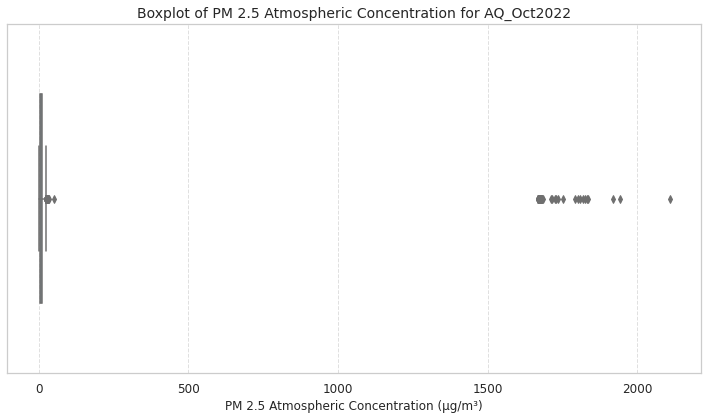

In [52]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns  # Import seaborn for better visual styles

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2022.csv")

# Set the style of the plot using seaborn
sns.set(style="whitegrid")

# Create a boxplot for the "pm2.5_atm" column
plt.figure(figsize=(10, 6))
sns.boxplot(x=data["pm2.5_atm"], orient="h", color="skyblue", width=0.6)
plt.xlabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("Boxplot of PM 2.5 Atmospheric Concentration for AQ_Oct2022", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks([])
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()

plt.show()

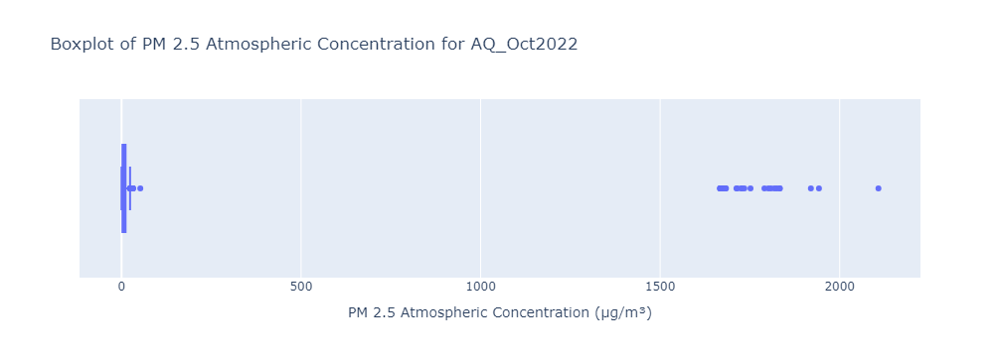

In [53]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2022.csv")

# Create an interactive boxplot with Plotly Express
fig = px.box(data, x="pm2.5_atm", title="Boxplot of PM 2.5 Atmospheric Concentration for AQ_Oct2022")
fig.update_layout(xaxis_title="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

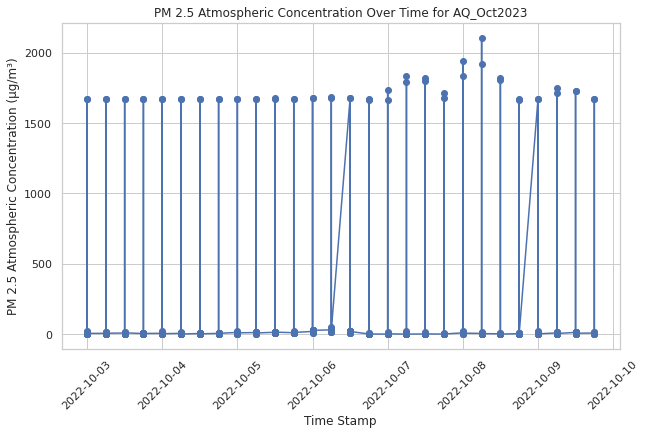

In [54]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2022.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Plot the "pm2.5_atm" over "time_stamp"
plt.figure(figsize=(10, 6))
plt.plot(data['time_stamp'], data['pm2.5_atm'], marker='o', linestyle='-')
plt.xlabel("Time Stamp")
plt.ylabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("PM 2.5 Atmospheric Concentration Over Time for AQ_Oct2023")
plt.xticks(rotation=45)
plt.grid(True)

plt.show()

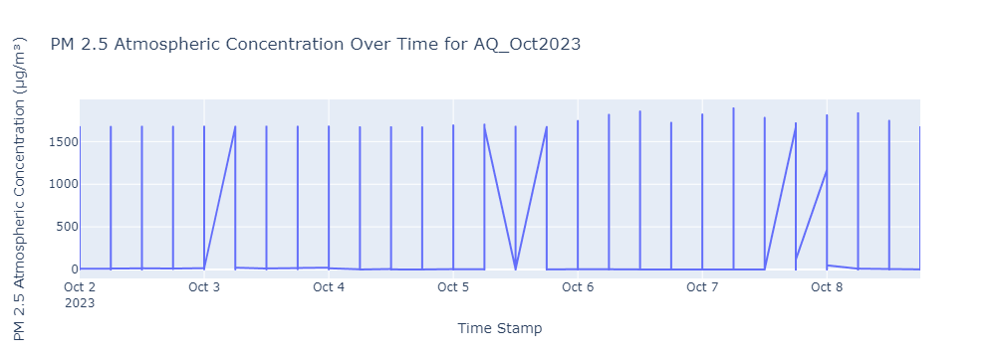

In [55]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2023.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Create an interactive time series plot with Plotly Express
fig = px.line(data, x="time_stamp", y="pm2.5_atm", title="PM 2.5 Atmospheric Concentration Over Time for AQ_Oct2023")
fig.update_xaxes(title_text="Time Stamp")
fig.update_yaxes(title_text="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

#### To get Sensor IDs with an average pm2.5_atm greater than 500.

In [56]:
import pandas as pd

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2022.csv")  # Replace with the actual file path

# Group by Sensor_ID and calculate the sum of pm2.5_atm and the count of all readings
sensor_stats = data.groupby("Sensor_ID").agg({
    "pm2.5_atm": ["sum", "count"]
}).reset_index()

# Rename columns for clarity
sensor_stats.columns = ["Sensor_ID", "sum_pm2.5_atm", "count_readings"]

# Calculate the sum of pm2.5_atm / count for each sensor
sensor_stats["avg_pm2.5_atm"] = sensor_stats["sum_pm2.5_atm"] / sensor_stats["count_readings"]

# Filter sensors with average pm2.5_atm greater than 500
high_pm_sensors = sensor_stats[sensor_stats["avg_pm2.5_atm"] > 50]["Sensor_ID"]

# Display the sensors with average pm2.5_atm greater than 500
print("Sensor IDs with average pm2.5_atm greater than 500:", high_pm_sensors.tolist())

Sensor IDs with average pm2.5_atm greater than 500: [77405, 145242]


#### Drop sensor IDs as 145242

In [59]:
# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2022.csv")

# Drop rows with Sensor_IDs 77405 and 145242
data_updated = data[~data['Sensor_ID'].isin([77405, 145242])]

# Save the updated DataFrame to a new CSV file
data_updated.to_csv("AQ_Oct2022_updated.csv", index=False)

#### Creating Animated Scatter Plot 

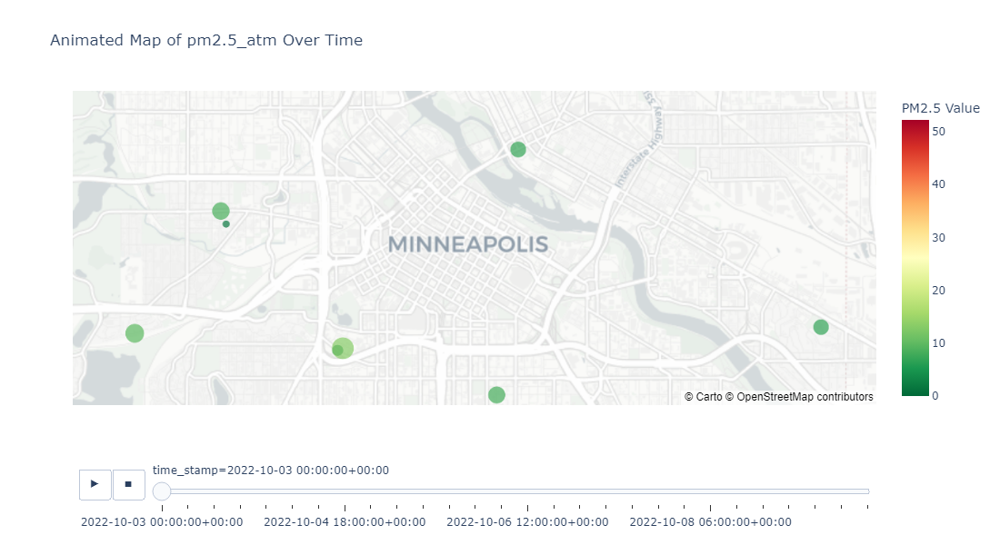

In [60]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('AQ_Oct2022_updated.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Compute the maximum PM2.5 value across all timestamps
max_pm25_global = df['pm2.5_atm'].max()

# Compute the color scale range based on the dataset values
color_scale_range = [df['pm2.5_atm'].min(), df['pm2.5_atm'].max()]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r',
                        range_color=color_scale_range,
                        size_max=35,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron",
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,
    width=800
)

# Customize the colorbar legend
fig.update_layout(coloraxis_colorbar=dict(title='PM2.5 Value'))

# Show the map
fig.show()

### OCTOBER 2023 

In [111]:
import pandas as pd
import os

# Load the sensor locations data into a DataFrame
sensor_locations_df = pd.read_csv("Sensors in Mpls_ETL.csv")

# Define the directory where the CSV files are located
directory = "./AQ_Data/AQ_Oct2023"

# Create an empty list to store the dataframes
dfs = []

# Iterate over each file in the directory
for filename in os.listdir(directory):
    # Check if the file is a CSV file
    if filename.endswith(".csv"):
        file_path = os.path.join(directory, filename)
        # Check if the file is empty
        if os.path.getsize(file_path) > 0:
            # Extract the sensor ID from the filename
            Sensor_ID = filename.split()[0]
            
            # Load the CSV file into a pandas DataFrame
            df = pd.read_csv(file_path)
            
            # Add a new column with the sensor ID
            df["Sensor_ID"] = Sensor_ID
            
            # Append the DataFrame to the list
            dfs.append(df)
        else:
            print(f"Skipped empty file: {filename}")

# Concatenate all the dataframes in the list
combined_df = pd.concat(dfs, ignore_index=True)

# converting the "Sensor_ID" column in the sensor_locations_df dataframe to a string data type using the astype() method
sensor_locations_df["Sensor_ID"] = sensor_locations_df["Sensor_ID"].astype(str)

# Perform a left join between SensorLocations_HennepinCounty and combined_df on sensor_id
merged_df = pd.merge(sensor_locations_df, combined_df, on="Sensor_ID", how="inner")

# Sort by the time_stamp column
merged_df = merged_df.sort_values("time_stamp")

merged_df.to_csv("AQ_Oct2023.csv", index=False)

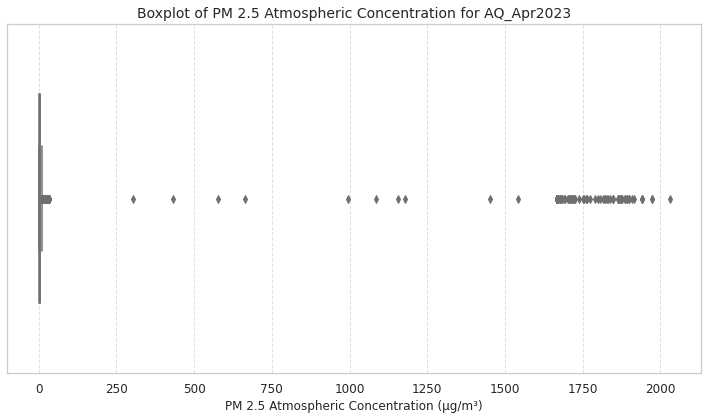

In [112]:
# OCTOBER 2023 (BoxPLOT)

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2023.csv")

# Set the style of the plot using seaborn
sns.set(style="whitegrid")

# Create a boxplot for the "pm2.5_atm" column
plt.figure(figsize=(10, 6))
sns.boxplot(x=data["pm2.5_atm"], orient="h", color="skyblue", width=0.6)
plt.xlabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("Boxplot of PM 2.5 Atmospheric Concentration for AQ_Apr2023", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks([])
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()

plt.show()

In [15]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2023_updated.csv")

# Create an interactive boxplot with Plotly Express
fig = px.box(data, x="pm2.5_atm", title="Boxplot of PM 2.5 Atmospheric Concentration for AQ_Apr2023")
fig.update_layout(xaxis_title="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

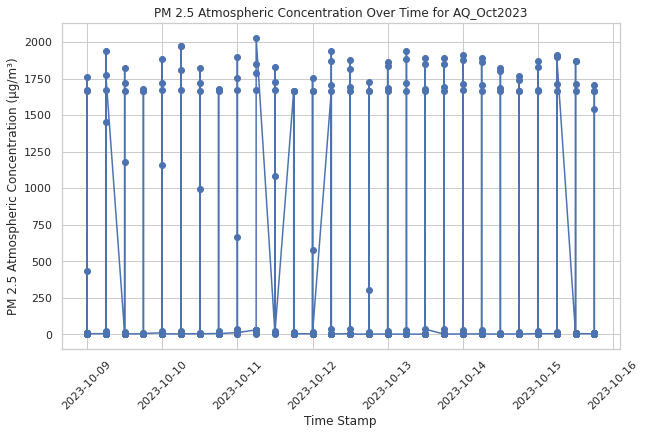

In [114]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2023.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Plot the "pm2.5_atm" over "time_stamp"
plt.figure(figsize=(10, 6))
plt.plot(data['time_stamp'], data['pm2.5_atm'], marker='o', linestyle='-')
plt.xlabel("Time Stamp")
plt.ylabel("PM 2.5 Atmospheric Concentration (µg/m³)")
plt.title("PM 2.5 Atmospheric Concentration Over Time for AQ_Oct2023")
plt.xticks(rotation=45)
plt.grid(True)

plt.show()

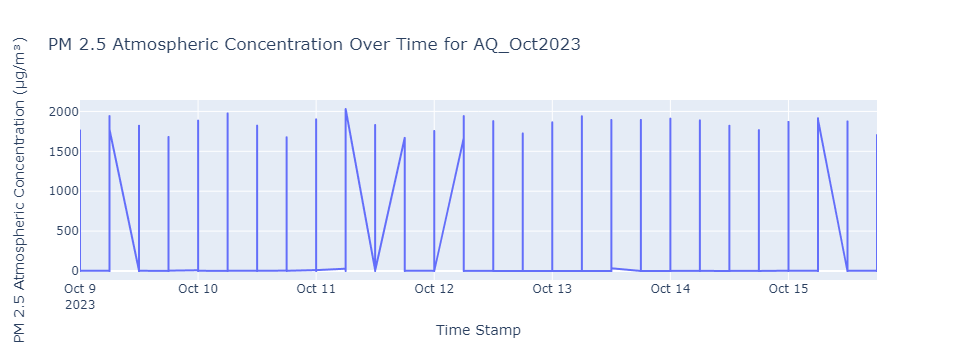

In [115]:
import pandas as pd
import plotly.express as px

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2023.csv")

# Convert the "time_stamp" column to datetime
data['time_stamp'] = pd.to_datetime(data['time_stamp'])

# Create an interactive time series plot with Plotly Express
fig = px.line(data, x="time_stamp", y="pm2.5_atm", title="PM 2.5 Atmospheric Concentration Over Time for AQ_Oct2023")
fig.update_xaxes(title_text="Time Stamp")
fig.update_yaxes(title_text="PM 2.5 Atmospheric Concentration (µg/m³)")

# Show the plot interactively
fig.show()

#### To get Sensor IDs with an average pm2.5_atm greater than 500 or any readings greater than 1004

In [118]:
import pandas as pd

# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2023.csv")  # Replace with the actual file path

# Group by Sensor_ID and calculate the sum of pm2.5_atm and the count of all readings
sensor_stats = data.groupby("Sensor_ID").agg({
    "pm2.5_atm": ["sum", "mean", lambda x: any(x > 1004), "count"]
}).reset_index()

# Rename columns for clarity
sensor_stats.columns = ["Sensor_ID", "sum_pm2.5_atm", "avg_pm2.5_atm", "any_reading_gt_1004", "count_readings"]

# Filter sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
high_pm_sensors = sensor_stats[
    (sensor_stats["avg_pm2.5_atm"] > 500) | (sensor_stats["any_reading_gt_1004"])
]["Sensor_ID"]

# Display the sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
print("Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004:", high_pm_sensors.tolist())

Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004: [3088, 43305, 77405, 157845]


#### Drop Sensor IDs [157871, 3088, 43305, 77405, 157845]

In [119]:
# Load the data from the CSV file
data = pd.read_csv("AQ_Oct2023.csv")

# Drop rows with Sensor_IDs 77405 and 145242
data_updated = data[~data['Sensor_ID'].isin([157871, 3088, 43305, 77405, 157845])]

# Save the updated DataFrame to a new CSV file
data_updated.to_csv("AQ_Oct2023_updated.csv", index=False)

#### Animated Scatter Plot

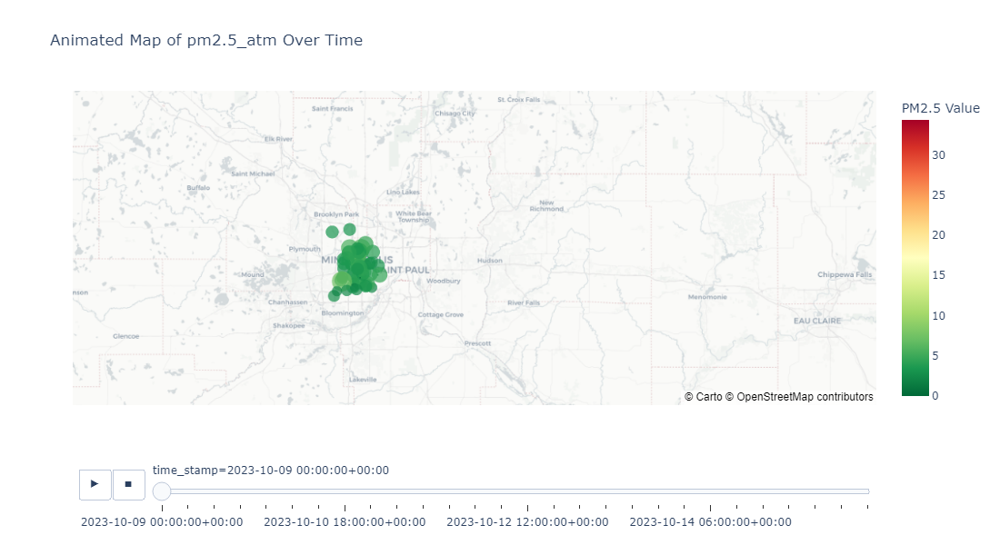

In [120]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('AQ_Oct2023_updated.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Compute the maximum PM2.5 value across all timestamps
max_pm25_global = df['pm2.5_atm'].max()

# Compute the color scale range based on the dataset values
color_scale_range = [df['pm2.5_atm'].min(), df['pm2.5_atm'].max()]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r',
                        range_color=color_scale_range,
                        size_max=35,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron",
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,
    width=800
)

# Customize the colorbar legend
fig.update_layout(coloraxis_colorbar=dict(title='PM2.5 Value'))

# Show the map
fig.show()

### Special Case: 

Some Events to be included in Analysis:

Other Events: Daily Data

DNR Alerts: https://www.dnr.state.mn.us/climate/journal/index.html
1.	"Big Mess" Snowstorm Clobbers Minnesota, January 2-5, 2023
2.	Winter storm and heavy snow, February 21-23, 2023 (Maybe)
3.	Spring Storm (Again), April 14-17, 2023
4.	July 4 celebration (1-day / Drop)
5.	Smoke Event of July 14, 2023 
6. Intense Heat Wave, August 21-23, 2023
7.	Welcome Rains Douse Minnesota: September 23-25, 2023
8.	Twin Cities see biggest Halloween snowfall in over 30 years

#### 14-15 July2023 (1hr Average Readings)

In [14]:
import pandas as pd
import os

# Load the sensor locations data into a DataFrame
sensor_locations_df = pd.read_csv("Sensors in Mpls_ETL.csv")

# Define the directory where the CSV files are located
directory = "./AQ_Data/AQ_14-15July2023_1hr"

# Create an empty list to store the dataframes
dfs = []

# Iterate over each file in the directory
for filename in os.listdir(directory):
    # Check if the file is a CSV file
    if filename.endswith(".csv"):
        file_path = os.path.join(directory, filename)
        # Check if the file is empty
        if os.path.getsize(file_path) > 0:
            # Extract the sensor ID from the filename
            Sensor_ID = filename.split()[0]
            
            # Load the CSV file into a pandas DataFrame
            df = pd.read_csv(file_path)
            
            # Add a new column with the sensor ID
            df["Sensor_ID"] = Sensor_ID
            
            # Append the DataFrame to the list
            dfs.append(df)
        else:
            print(f"Skipped empty file: {filename}")

# Concatenate all the dataframes in the list
combined_df = pd.concat(dfs, ignore_index=True)

# converting the "Sensor_ID" column in the sensor_locations_df dataframe to a string data type using the astype() method
sensor_locations_df["Sensor_ID"] = sensor_locations_df["Sensor_ID"].astype(str)

# Perform a left join between SensorLocations_HennepinCounty and combined_df on sensor_id
merged_df = pd.merge(sensor_locations_df, combined_df, on="Sensor_ID", how="inner")

# Sort by the time_stamp column
merged_df = merged_df.sort_values("time_stamp")

merged_df.to_csv("AQ_14-15July2023_1hr.csv", index=False)

Skipped empty file: 166459 2023-07-14 2023-07-16 60-Minute Average.csv
Skipped empty file: 142742 2023-07-14 2023-07-16 60-Minute Average.csv
Skipped empty file: 194635 2023-07-14 2023-07-16 60-Minute Average.csv
Skipped empty file: 143248 2023-07-14 2023-07-16 60-Minute Average.csv


#### To get Sensor IDs with an average pm2.5_atm greater than 500.

In [17]:
import pandas as pd

# Load the data from the CSV file
data = pd.read_csv("AQ_14-15July2023_1hr.csv")  # Replace with the actual file path

# Group by Sensor_ID and calculate the sum of pm2.5_atm and the count of all readings
sensor_stats = data.groupby("Sensor_ID").agg({
    "pm2.5_atm": ["sum", "mean", lambda x: any(x > 1004), "count"]
}).reset_index()

# Rename columns for clarity
sensor_stats.columns = ["Sensor_ID", "sum_pm2.5_atm", "avg_pm2.5_atm", "any_reading_gt_1004", "count_readings"]

# Filter sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
high_pm_sensors = sensor_stats[
    (sensor_stats["avg_pm2.5_atm"] > 500) | (sensor_stats["any_reading_gt_1004"])
]["Sensor_ID"]

# Display the sensors with average pm2.5_atm greater than 500 or any readings greater than 1004
print("Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004:", high_pm_sensors.tolist())

Sensor IDs with average pm2.5_atm greater than 500 or any readings greater than 1004: [3088, 77405, 145242, 157871]


#### Drop rows with Sensor_IDs [157871, 3088, 43305, 145242, 77405, 157845]

In [18]:
# Load the data from the CSV file
data = pd.read_csv("AQ_14-15July2023_1hr.csv")

# Drop rows with Sensor_IDs 77405 and 145242
data_updated = data[~data['Sensor_ID'].isin([157871, 3088, 43305, 77405, 145242, 157845])]

# Save the updated DataFrame to a new CSV file
data_updated.to_csv("AQ_14-15July2023_1hr_updated.csv", index=False)

#### Animated Scatter Plot

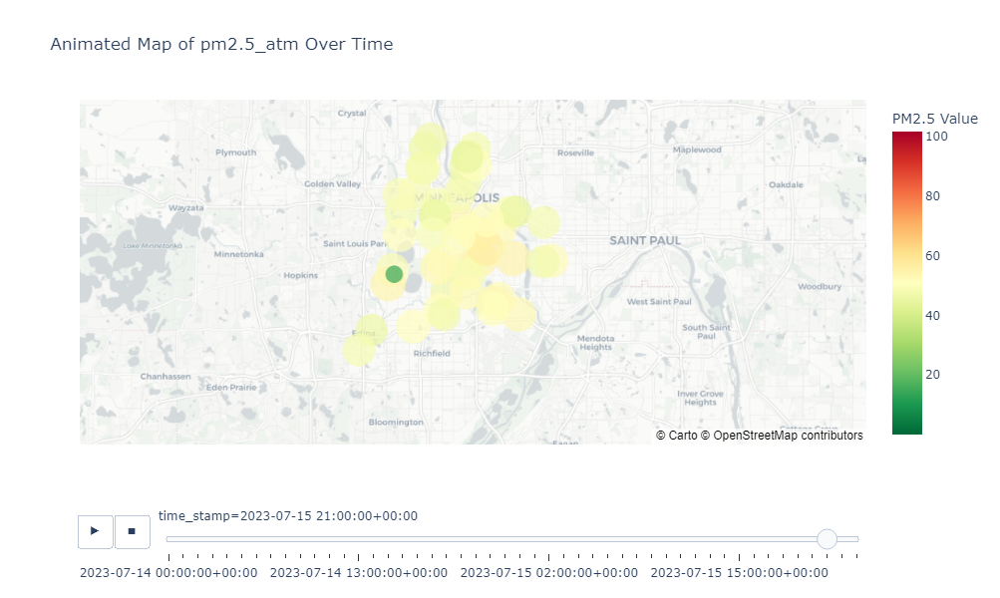

In [19]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('AQ_14-15July2023_1hr_updated.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Compute the maximum PM2.5 value across all timestamps
max_pm25_global = df['pm2.5_atm'].max()

# Compute the color scale range based on the dataset values
color_scale_range = [df['pm2.5_atm'].min(), df['pm2.5_atm'].max()]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r',
                        range_color=color_scale_range,
                        size_max=35,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron",
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,
    width=800
)

# Customize the colorbar legend
fig.update_layout(coloraxis_colorbar=dict(title='PM2.5 Value'))

# Show the map
fig.show()

#### Interactive Line Plot 

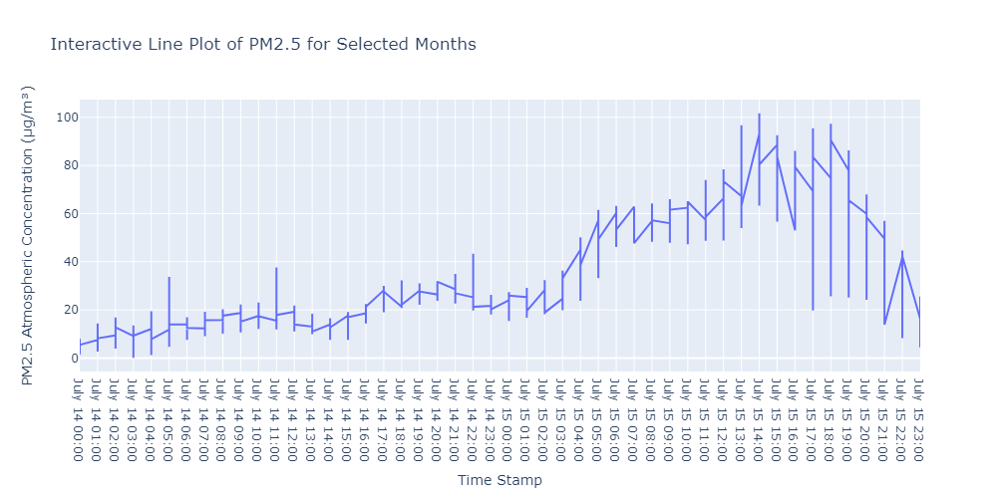

In [20]:
import plotly.graph_objects as go
import pandas as pd

# Load the CSV data
csv_path = 'AQ_14-15July2023_1hr_updated.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Extract month and day information
df['month'] = df['time_stamp'].dt.month
df['day'] = df['time_stamp'].dt.day

# Filter data for specific months (e.g., January, April, July, October)
selected_months = [1, 4, 7, 10]
filtered_df = df[df['month'].isin(selected_months)]

# Create an interactive line plot
fig = go.Figure()

# Add scatter traces for each point with hover text
for month, data in filtered_df.groupby('month'):
    month_name = data['time_stamp'].dt.strftime('%B').iloc[0]  # Get full month name
    hover_text = data['time_stamp'].dt.strftime('%B %d %H:%M')  # Format hover text
    fig.add_trace(go.Scatter(x=data['time_stamp'], y=data['pm2.5_atm'], mode='lines', name=month_name, text=hover_text))

# Customize the layout
fig.update_layout(
    xaxis=dict(title='Time Stamp', type='category'),
    yaxis=dict(title='PM2.5 Atmospheric Concentration (µg/m³)'),
    title='Interactive Line Plot of PM2.5 for Selected Months',
    width=800, height=500,
    hovermode='x',  # Show hover information on x-axis
)

# Set the x-axis tick values and labels for the selected months
fig.update_xaxes(
    tickvals=filtered_df['time_stamp'].unique(),
    ticktext=filtered_df['time_stamp'].dt.strftime('%B %d %H:%M').unique()
)

# Show the interactive plot
fig.show()

## One Big CSV?

In [25]:
import os
import pandas as pd

# Define the directory where the CSV files are located
directory = "./"

# List of CSV file names
file_names = ['AQ_Jan2023_updated.csv', 'AQ_Apr2023_updated.csv', 'AQ_July2023_updated.csv', 'AQ_Oct2023_updated.csv']

# Create an empty list to store individual DataFrames
dfs = []

# Loop through each CSV file and read it into a DataFrame, then append to the list
for file_name in file_names:
    file_path = os.path.join(directory, file_name)
    df = pd.read_csv(file_path)
    dfs.append(df)

# Concatenate the list of DataFrames into a single DataFrame
combined_df = pd.concat(dfs, ignore_index=True)

# Save the combined DataFrame to a new CSV file
combined_df.to_csv(os.path.join(directory, "Combined_AQ_Data.csv"), index=False)

## Visulalization of Data

### Number of Data Points per Month

In [58]:
import pandas as pd

# Load the CSV file
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert the 'time_stamp' column to datetime format
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Extract the month name and create a new column
df['month_name'] = df['time_stamp'].dt.strftime("%B")

# Display unique values and counts for the 'month_name' column
print(df['month_name'].value_counts())

October    1566
July       1397
April      1288
January    1106
Name: month_name, dtype: int64


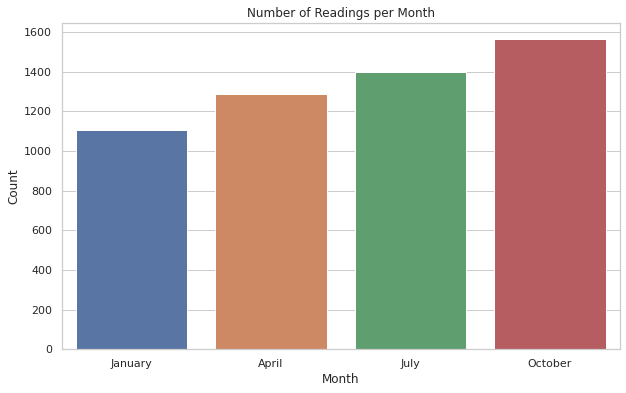

In [23]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the CSV file
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert the 'time_stamp' column to datetime format
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Extract the month name and create a new column
df['month_name'] = df['time_stamp'].dt.strftime("%B")

# Plot the count of records for each month
plt.figure(figsize=(10, 6))
sns.countplot(x='month_name', data=df, order=['January', 'April', 'July', 'October'])
plt.title('Number of Readings per Month')
plt.xlabel('Month')
plt.ylabel('Count')
plt.show()

In [53]:
import pandas as pd

# Load the CSV file
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Count the number of data points for each Sensor_ID
sensor_counts = df['Sensor_ID'].value_counts()

# Display the count of data points for each Sensor_ID
print(sensor_counts)

145204    112
108364    112
85113     112
143246    112
143656    112
         ... 
188539     28
183325     28
99807      28
194635     25
196233     11
Name: Sensor_ID, Length: 64, dtype: int64


In [57]:
# Load the CSV file
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Count the number of data points for each Sensor_ID
sensor_counts = df['Sensor_ID'].value_counts()

# Display the count of data points for each Sensor_ID
print(sensor_counts)

# Identify sensors whose data is less than 112
sensors_less_than_112 = sensor_counts[sensor_counts < 112].index

# Display the Sensor_IDs whose data is less than 112
print("Sensor_IDs with data less than 112:", sensors_less_than_112)

145204    112
108364    112
85113     112
143246    112
143656    112
         ... 
188539     28
183325     28
99807      28
194635     25
196233     11
Name: Sensor_ID, Length: 64, dtype: int64
Sensor_IDs with data less than 112: Int64Index([143916, 113486, 142734, 168327, 142744, 143216, 143636, 142726,
            174855, 142750, 174451, 157935, 157861, 145242, 101525,  11134,
             61239, 110979, 145604, 166459, 145506, 182801, 143942, 142724,
            143668, 143660, 142736, 143648, 161401, 143634, 145202, 145262,
            193171, 193207, 188539, 183325,  99807, 194635, 196233],
           dtype='int64')


### Boxplot for all 4 seasons

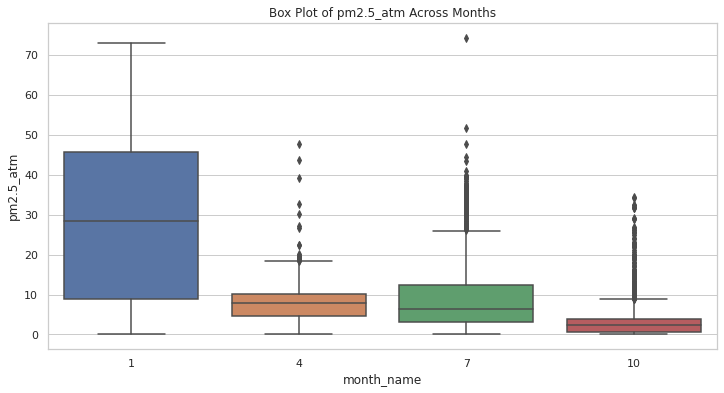

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert 'time_stamp' to datetime format
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Box Plot for pm2.5_atm at different time points
plt.figure(figsize=(12, 6))
sns.boxplot(x=df['time_stamp'].dt.month, y='pm2.5_atm', data=df)
plt.title('Box Plot of pm2.5_atm Across Months')
plt.xlabel('month_name')
plt.ylabel('pm2.5_atm')
plt.show()

### Swarm Plot (Distribution of pm2.5_atm)

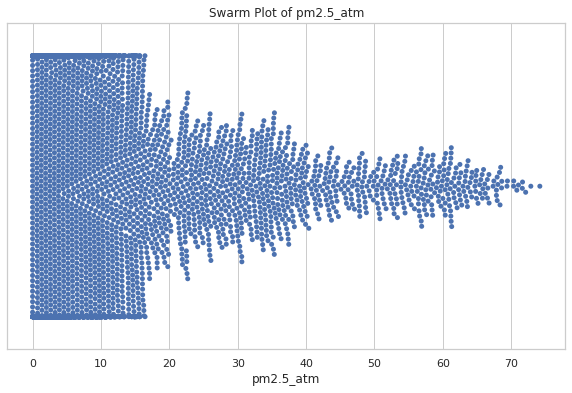

In [64]:
# All data together

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Swarm Plot for pm2.5_atm
plt.figure(figsize=(10, 6))
sns.swarmplot(x='pm2.5_atm', data=df)
plt.title('Swarm Plot of pm2.5_atm')
plt.xlabel('pm2.5_atm')
plt.show()

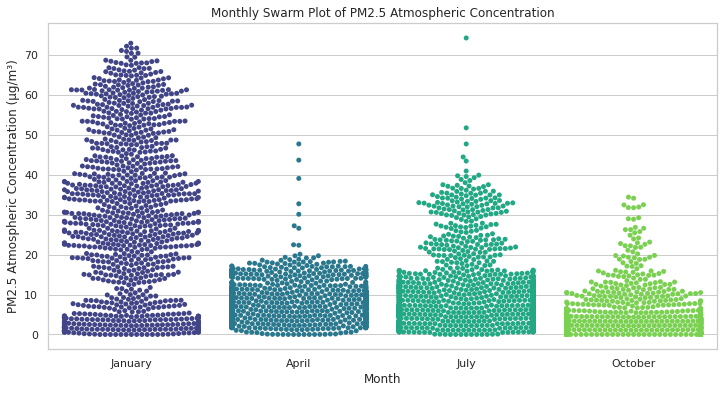

In [21]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime

# Load your CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert the 'time_stamp' column to datetime format
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Extract the month name from the datetime column
df['month_name'] = df['time_stamp'].dt.strftime("%B")

# Create a Monthly Swarm Plot using Seaborn and Matplotlib
plt.figure(figsize=(12, 6))
sns.swarmplot(x='month_name', y='pm2.5_atm', data=df, palette='viridis', size=5)

plt.title('Monthly Swarm Plot of PM2.5 Atmospheric Concentration')
plt.xlabel('Month')
plt.ylabel('PM2.5 Atmospheric Concentration (µg/m³)')

plt.show()

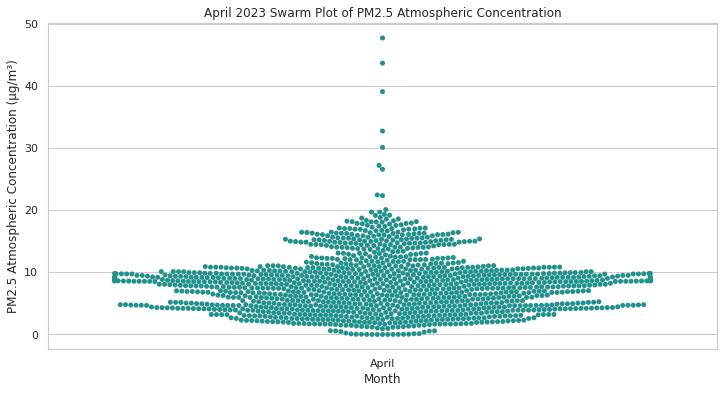

In [60]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime

# Load your CSV data
csv_path = 'AQ_Apr2023_updated.csv'
df = pd.read_csv(csv_path)

# Convert the 'time_stamp' column to datetime format
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Extract the month name from the datetime column
df['month_name'] = df['time_stamp'].dt.strftime("%B")

# Create a Monthly Swarm Plot using Seaborn and Matplotlib
plt.figure(figsize=(12, 6))
sns.swarmplot(x='month_name', y='pm2.5_atm', data=df, palette='viridis', size=5)

plt.title('April 2023 Swarm Plot of PM2.5 Atmospheric Concentration')
plt.xlabel('Month')
plt.ylabel('PM2.5 Atmospheric Concentration (µg/m³)')

plt.show()

#### Monthly Swarm with embeded violin Plot 

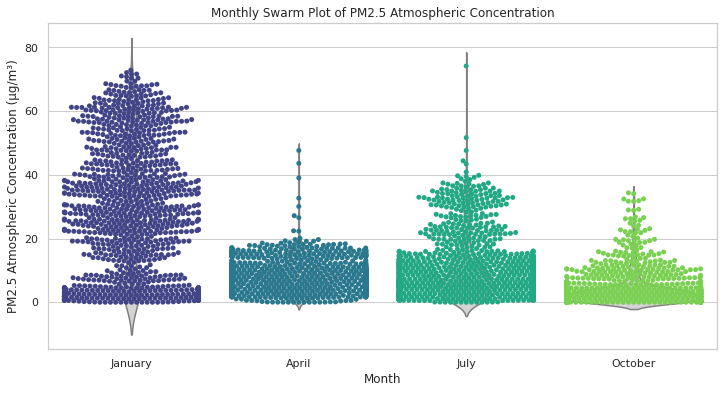

In [63]:
# Load your CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert the 'time_stamp' column to datetime format
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Extract the month name from the datetime column
df['month_name'] = df['time_stamp'].dt.strftime("%B")


# Create a Monthly Swarm Plot using Seaborn and Matplotlib
plt.figure(figsize=(12, 6))
sns.swarmplot(x='month_name', y='pm2.5_atm', data=df, palette='viridis', size=5)
sns.violinplot(x='month_name', y='pm2.5_atm', data=df, inner=None, color='lightgray')

plt.title('Monthly Swarm and Violin Plot of PM2.5 Atmospheric Concentration')
plt.xlabel('Month')
plt.ylabel('PM2.5 Atmospheric Concentration (µg/m³)')

plt.show()

### Violin Plot 

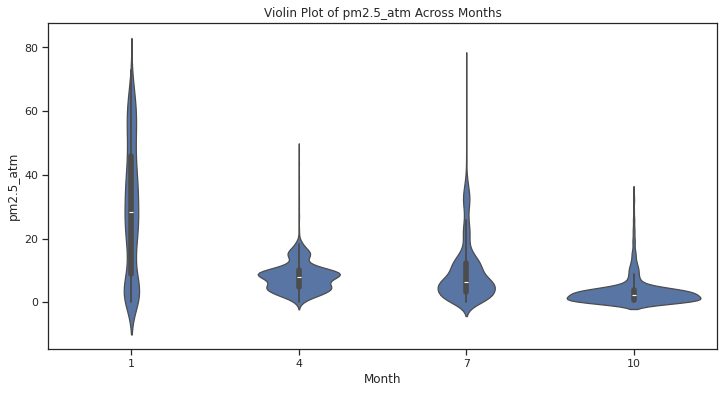

In [43]:
plt.figure(figsize=(12, 6))
sns.violinplot(x=df['time_stamp'].dt.month, y='pm2.5_atm', data=df)
plt.title('Violin Plot of pm2.5_atm Across Months')
plt.xlabel('Month')
plt.ylabel('pm2.5_atm')
plt.show()

### Histogram

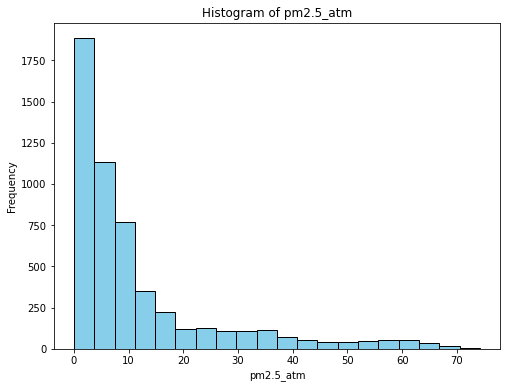

In [15]:
# Try log distribution

import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Histogram for pm2.5_atm
plt.figure(figsize=(8, 6))
plt.hist(df['pm2.5_atm'], bins=20, color='skyblue', edgecolor='black')
plt.title('Histogram of pm2.5_atm')
plt.xlabel('pm2.5_atm')
plt.ylabel('Frequency')
plt.show()

### Bar Plot (Get Monthly Average):

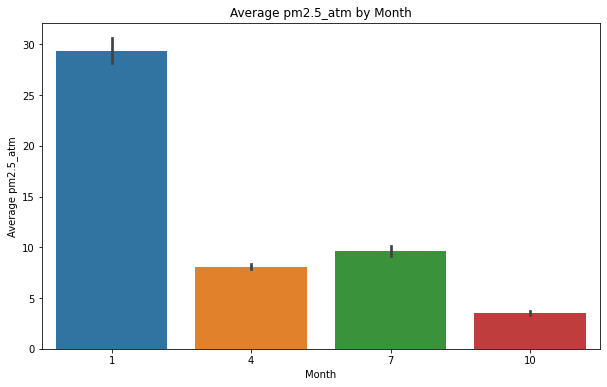

In [5]:
import pandas as pd
import seaborn as sns

# Load the CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert 'time_stamp' to datetime format
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Bar Plot for average pm2.5_atm by month
plt.figure(figsize=(10, 6))
sns.barplot(x=df['time_stamp'].dt.month, y='pm2.5_atm', data=df)
plt.title('Average pm2.5_atm by Month')
plt.xlabel('Month')
plt.ylabel('Average pm2.5_atm')
plt.show()

### KDE Plot (Kernel Density Estimate)
The density in a KDE plot provides information about the relative likelihood of different values in the dataset. Peaks in the plot indicate regions where the data is more densely distributed, while valleys represent areas with lower data density.

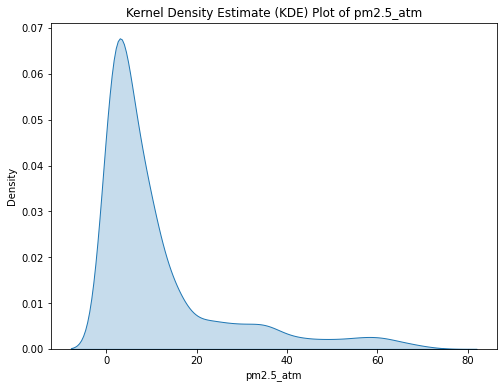

In [7]:
# mixed-Gussian

import pandas as pd
import seaborn as sns

# Load the CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert 'time_stamp' to datetime format
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# KDE Plot for pm2.5_atm
plt.figure(figsize=(8, 6))
sns.kdeplot(df['pm2.5_atm'], fill=True)
plt.title('Kernel Density Estimate (KDE) Plot of pm2.5_atm')
plt.xlabel('pm2.5_atm')
plt.show()

### Heatmap (Correlation Matrix):
Not useful here but can use in my other projects

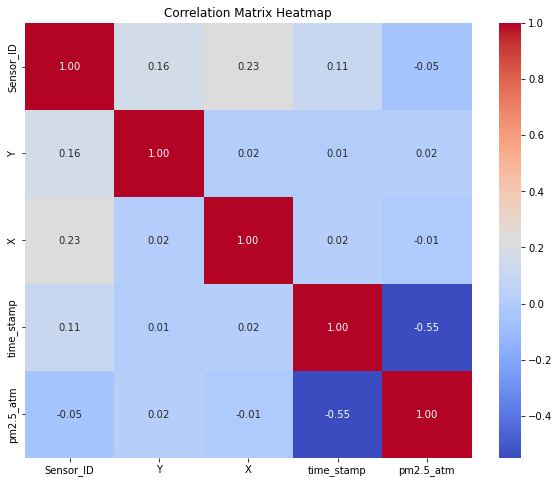

In [12]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert 'time_stamp' to datetime format
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Calculate the correlation matrix
corr_matrix = df.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix Heatmap')
plt.show()

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:1615: UserWarning: 
The markers list has fewer values (3) than needed (64) and will cycle, which may produce an uninterpretable plot.
  func(x=x, y=y, **kwargs)
/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:1615: UserWarning: 
The markers list has fewer values (3) than needed (64) and will cycle, which may produce an uninterpretable plot.
  func(x=x, y=y, **kwargs)
/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:1615: UserWarning: 
The markers list has fewer values (3) than needed (64) and will cycle, which may produce an uninterpretable plot.
  func(x=x, y=y, **kwargs)
/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:1615: UserWarning: 
The markers list has fewer values (3) than needed (64) and will cycle, which may produce an uninterpretable plot.
  func(x=x, y=y, **kwargs)
/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:1615: UserWarning: 
The markers list has fewer values (3) tha

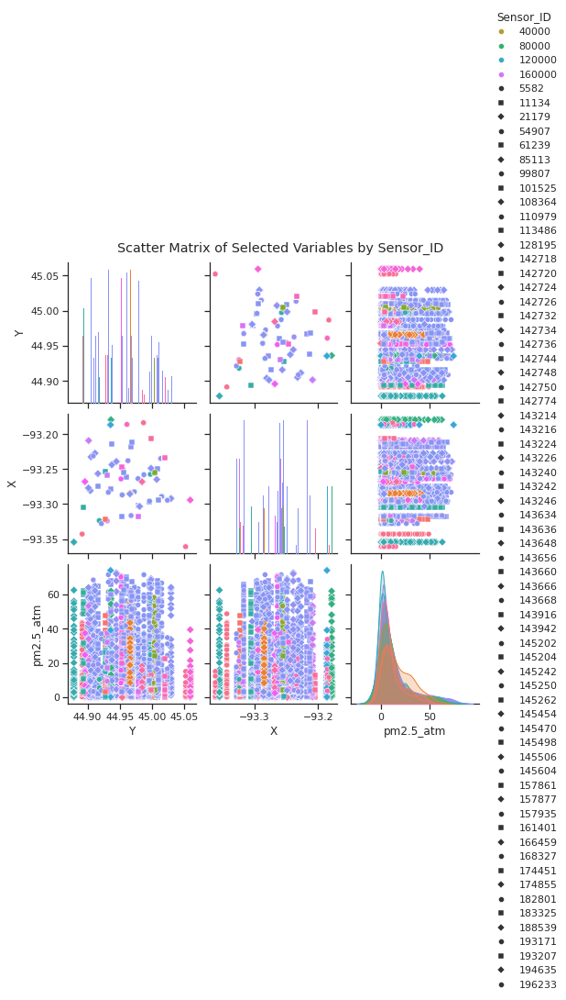

In [38]:
sns.set_theme(style="ticks")
sns.pairplot(df, hue='Sensor_ID', markers=["o", "s", "D"], palette="husl")
plt.suptitle('Scatter Matrix of Selected Variables by Sensor_ID', y=1.02)
plt.show()

### Animated Scatter plot for all 4 seasons

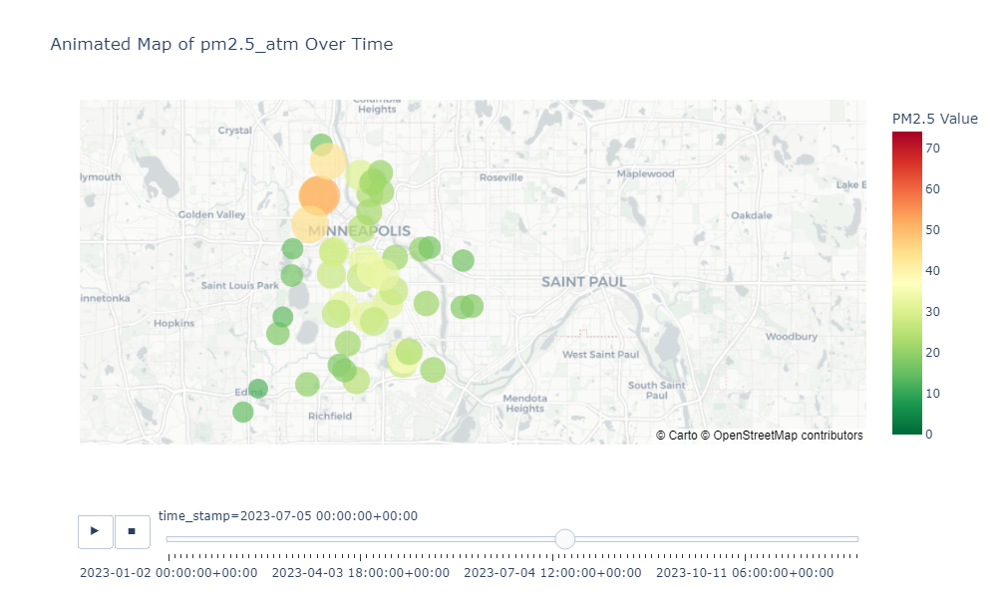

In [ ]:
import plotly.express as px
import pandas as pd

# Load your CSV file
df = pd.read_csv('Combined_AQ_Data.csv')

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Specify the Minnesota coordinates
minneapolis_coordinates = [44.970697000014205, -93.27057655499587]

# Compute the maximum PM2.5 value across all timestamps
max_pm25_global = df['pm2.5_atm'].max()

# Compute the color scale range based on the dataset values
color_scale_range = [df['pm2.5_atm'].min(), df['pm2.5_atm'].max()]

# Create an animated scatter plot on a map with Plotly, focusing on Minnesota
fig = px.scatter_mapbox(df,
                        lat='Y', 
                        lon='X', 
                        color='pm2.5_atm', 
                        size='pm2.5_atm',
                        animation_frame='time_stamp',
                        color_continuous_scale='RdYlGn_r',
                        range_color=color_scale_range,
                        size_max=35,
                        title='Animated Map of pm2.5_atm Over Time',
                        mapbox_style="carto-positron",
                        center={'lat': minneapolis_coordinates[0], 'lon': minneapolis_coordinates[1]},
                        zoom=9
                       )

# Set the size of the visualization window
fig.update_layout(
    height=600,
    width=800
)

# Customize the colorbar legend
fig.update_layout(coloraxis_colorbar=dict(title='PM2.5 Value'))

# Show the map
fig.show()

### Temporal Variation of PM2.5 Concentration
The x-axis represents time stamps, displaying unique dates and times, while the y-axis depicts PM2.5 concentration in µg/m³

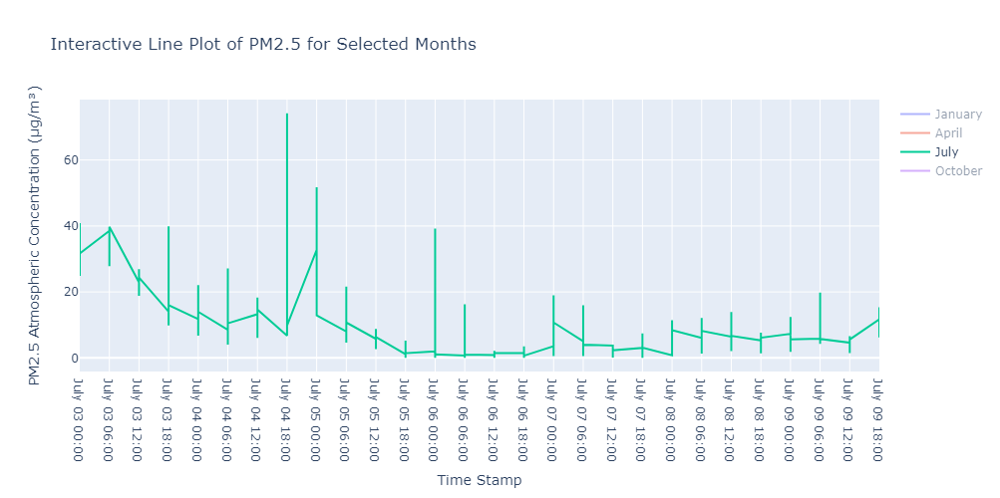

In [53]:
import plotly.graph_objects as go
import pandas as pd

# Load the CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Extract month and day information
df['month'] = df['time_stamp'].dt.month
df['day'] = df['time_stamp'].dt.day

# Filter data for specific months (e.g., January, April, July, October)
selected_months = [1, 4, 7, 10]
filtered_df = df[df['month'].isin(selected_months)]

# Create an interactive line plot
fig = go.Figure()

# Add scatter traces for each point with hover text
for month, data in filtered_df.groupby('month'):
    month_name = data['time_stamp'].dt.strftime('%B').iloc[0]  # Get full month name
    hover_text = data['time_stamp'].dt.strftime('%B %d %H:%M')  # Format hover text
    fig.add_trace(go.Scatter(x=data['time_stamp'], y=data['pm2.5_atm'], mode='lines', name=month_name, text=hover_text))

# Customize the layout
fig.update_layout(
    xaxis=dict(title='Time Stamp', type='category'),
    yaxis=dict(title='PM2.5 Atmospheric Concentration (µg/m³)'),
    title='Interactive Line Plot of PM2.5 for Selected Months',
    width=800, height=500,
    hovermode='x',  # Show hover information on x-axis
)

# Set the x-axis tick values and labels for the selected months
fig.update_xaxes(
    tickvals=filtered_df['time_stamp'].unique(),
    ticktext=filtered_df['time_stamp'].dt.strftime('%B %d %H:%M').unique()
)

# Show the interactive plot
fig.show()

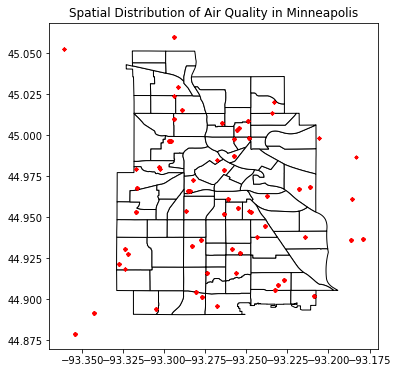

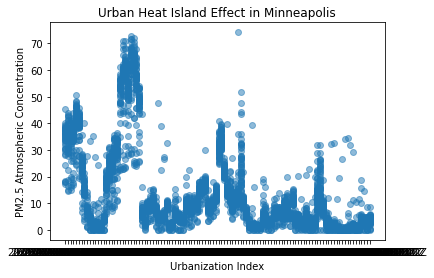

In [11]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

# Load CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert to GeoDataFrame (assuming you have latitude and longitude columns)
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['X'], df['Y']))

# Load the Minneapolis Neighborhoods GeoJSON file
neighborhoods_geojson_file = "Minneapolis_Neighborhoods.geojson"
minneapolis_neighborhoods = gpd.read_file(neighborhoods_geojson_file)

# Plot spatial distribution within Minneapolis
ax = minneapolis_neighborhoods.plot(figsize=(10, 6), edgecolor='black', color='white')
gdf.plot(ax=ax, color='red', markersize=5)
plt.title('Spatial Distribution of Air Quality in Minneapolis')
plt.show()

# Calculate and visualize Urban Heat Island effect (adjust as per your data)
# Example: Scatter plot of air quality vs. time_stamp in Minneapolis
plt.scatter(df['time_stamp'], df['pm2.5_atm'], alpha=0.5)
plt.xlabel('time_stamp')
plt.ylabel('PM2.5 Atmospheric Concentration')
plt.title('Urban Heat Island Effect in Minneapolis')
plt.show()

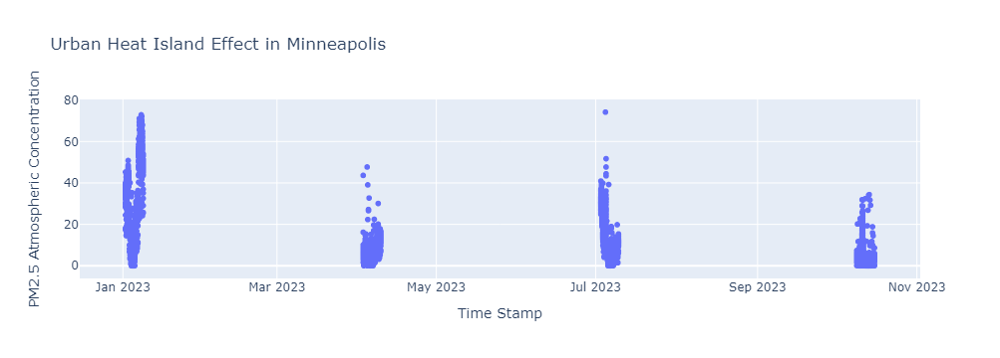

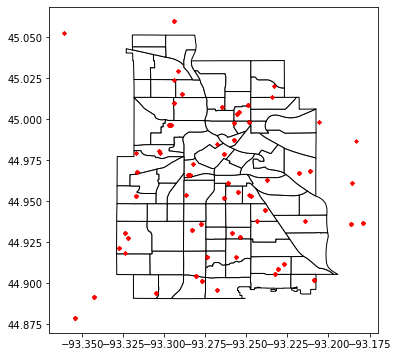

In [12]:
import pandas as pd
import geopandas as gpd
import plotly.express as px

# Load CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Convert to GeoDataFrame (assuming you have latitude and longitude columns)
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['X'], df['Y']))

# Load the Minneapolis Neighborhoods GeoJSON file
neighborhoods_geojson_file = "Minneapolis_Neighborhoods.geojson"
minneapolis_neighborhoods = gpd.read_file(neighborhoods_geojson_file)

# Plot spatial distribution within Minneapolis
fig, ax = plt.subplots(figsize=(10, 6))
minneapolis_neighborhoods.plot(ax=ax, edgecolor='black', color='white')
gdf.plot(ax=ax, color='red', markersize=5)

# Calculate and visualize Urban Heat Island effect (adjust as per your data)
# Example: Scatter plot of air quality vs. time_stamp in Minneapolis
fig2 = px.scatter(df, x='time_stamp', y='pm2.5_atm', title='Urban Heat Island Effect in Minneapolis',
                  labels={'time_stamp': 'Time Stamp', 'pm2.5_atm': 'PM2.5 Atmospheric Concentration'})
fig2.show()

S

In [ ]:
# Temporal one will be handy than spatial


#Temporal Coorelation 
# Spatial coorelation

# Pearson Coorelation 
# distance between sensors
      #use Neo Tool to get the distance 
    
# 

## 76x76 matrices - 4 of these for each season
# Distance of each sensor in comparison to all remaining sensor

### Matrix
User Combined_AQ_Data.csv Sensor IDs [3088, 5582, ...  198941] 

1st Sensor ID {[January readings], [April readings], [July readings], [October readings], [X, Y]} 
2nd Sensor ID {[January readings], [April readings], [July readings], [October readings], [X, Y]} 
. 
. 
. 
LAst Sensor ID {[January readings], [April readings], [July readings], [October readings], [X, Y]}

Create a matrix using code
Take data from Combined_AQ_Data.csv

### Matrix

In [78]:
import pandas as pd
from IPython.display import display

# Load your CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Create a matrix to store readings
matrix = []

# Iterate over each unique timestamp
for timestamp in df['time_stamp'].unique():
    # Filter data for the current timestamp
    timestamp_data = df[df['time_stamp'] == timestamp]
    
    # Extract PM2.5 readings for each sensor
    sensor_readings = timestamp_data.groupby('Sensor_ID')['pm2.5_atm'].apply(list).reset_index(name='pm2.5_atm')
    
    # Create a dictionary for the current timestamp
    timestamp_entry = {'timestamp': timestamp}
    
    # Add sensor readings to the dictionary
    for _, row in sensor_readings.iterrows():
        sensor_id = row['Sensor_ID']
        pm25_values = row['pm2.5_atm']
        timestamp_entry[f'Sensor_{sensor_id}'] = pm25_values
    
    # Append the entry to the matrix
    matrix.append(timestamp_entry)

# Create a DataFrame from the matrix
reshaped_df = pd.DataFrame(matrix)

# Set timestamp as the index for better readability
reshaped_df.set_index('timestamp', inplace=True)

# Display the DataFrame
display(reshaped_df)

,Sensor_5582,Sensor_11134,Sensor_21179,Sensor_54907,Sensor_61239,Sensor_85113,Sensor_101525,Sensor_108364,Sensor_110979,Sensor_113486,...,Sensor_143942,Sensor_182801,Sensor_161401,Sensor_99807,Sensor_183325,Sensor_188539,Sensor_193171,Sensor_193207,Sensor_194635,Sensor_196233
timestamp,,,,,,,,,,,,,,,,,,,,,
2023-01-02 00:00:00+00:00,[30.592],[24.445500000000003],[35.942499999999995],[30.286],[18.209],[31.979],[38.049],[37.823],[30.531],[17.884],...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-02 06:00:00+00:00,[18.8725],[14.523],[28.906],[37.325],[28.7755],[38.4765],[30.2495],[27.631500000000003],[37.3125],[16.566499999999998],...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-02 12:00:00+00:00,[19.0835],[16.0915],[28.0715],[33.495000000000005],[25.707],[34.281000000000006],[32.7645],[30.768],[33.3735],[16.7115],...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-02 18:00:00+00:00,[21.324],[16.9375],[28.2275],[33.269000000000005],[26.908],[39.898],[34.1195],[33.7415],[33.428],[18.9275],...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-03 00:00:00+00:00,[29.9645],[26.0325],[37.791],[39.9215],[33.555],[44.372],[41.3805],[41.602],[41.1375],[24.542],...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-10-14 18:00:00+00:00,[0.364],[0.5265],[11.7545],[1.0275],[0.9685],[1.0285],[0.7070000000000001],[0.5309999999999999],[1.3955],[0.066],...,[1.5045],[0.8035],[0.6890000000000001],[0.5525],[1.4505],[5.4705],[0.8055],[0.6575],[0.0],NaN
2023-10-15 00:00:00+00:00,[1.723],[2.371],[18.839],[4.2795],[3.982],[3.0895],[2.815],[2.2485],[4.2465],NaN,...,[4.800000000000001],[2.5775],[2.458],[2.6265],[4.4725],[15.8805],[2.521],[2.731],[0.0],NaN
2023-10-15 06:00:00+00:00,[1.7295],[2.24],[14.482],[4.173],[3.862],[3.0305],[2.905],[2.477],[3.5285],NaN,...,[4.26],[2.9370000000000003],[2.443],[2.512],[3.8305],[3.3865],[2.7375],[3.223],[0.0],NaN


In [80]:
import pandas as pd
from IPython.display import display

# Load your CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Get unique sensor IDs
unique_sensor_ids = df['Sensor_ID'].unique()

# Create a matrix to store readings
matrix = []

# Iterate over each unique sensor ID
for sensor_id in unique_sensor_ids:
    # Filter data for the current sensor ID
    sensor_data = df[df['Sensor_ID'] == sensor_id]
    
    # Extract readings for each month
    january_readings = sensor_data[sensor_data['time_stamp'].dt.month == 1]['pm2.5_atm'].tolist()
    april_readings = sensor_data[sensor_data['time_stamp'].dt.month == 4]['pm2.5_atm'].tolist()
    july_readings = sensor_data[sensor_data['time_stamp'].dt.month == 7]['pm2.5_atm'].tolist()
    october_readings = sensor_data[sensor_data['time_stamp'].dt.month == 10]['pm2.5_atm'].tolist()
    
    # Extract X, Y coordinates
    x_coordinates = sensor_data['X'].iloc[0]
    y_coordinates = sensor_data['Y'].iloc[0]
    
    # Create a dictionary for the current sensor
    sensor_entry = {
        'Sensor_ID': sensor_id,
        'January_Readings': january_readings,
        'April_Readings': april_readings,
        'July_Readings': july_readings,
        'October_Readings': october_readings,
        'X_Coordinates': x_coordinates,
        'Y_Coordinates': y_coordinates
    }
    
    # Append the entry to the matrix
    matrix.append(sensor_entry)

# Create a DataFrame from the matrix
table_df = pd.DataFrame(matrix)

# Set Sensor_ID as the index for better readability
table_df.set_index('Sensor_ID', inplace=True)

# Display the resulting table
display(table_df)

,January_Readings,April_Readings,July_Readings,October_Readings,X_Coordinates,Y_Coordinates
Sensor_ID,,,,,,
142734,"[37.8595, 31.6815, 31.5745, 34.847, 43.245, 38...","[6.82, 5.166, 8.855, 6.014, 4.0760000000000005...","[27.235, 32.675, 19.512, 13.7775, 15.8415, 17....","[3.6275, 3.49, 2.5715, 1.6960000000000002, 3.8...",-93.280624,44.904320
145454,"[36.03, 42.7935, 40.3065, 42.1395, 50.79900000...","[8.616, 5.433, 10.5165, 11.0565, 12.515, 8.755...","[37.081, 39.7105, 25.653, 17.22, 14.851, 11.28...","[4.0405, 5.3755, 3.9825, 1.988, 6.364, 3.976, ...",-93.238920,44.944750
142732,"[35.7635, 30.581, 32.1325, 33.479, 43.1485, 38...","[7.3265, 3.371, 7.845, 8.186499999999999, 9.96...","[28.319000000000003, 31.254, 20.578, 12.567, 1...","[1.7845, 2.299, 1.5875, 0.7145, 2.640500000000...",-93.274155,44.916058
145262,"[17.3175, 14.8125, 15.046, 17.727, 24.6455, 19...",[],[],[],-93.302444,44.979410
142736,"[34.748999999999995, 38.2965, 36.6325, 36.484,...","[5.4875, 2.8520000000000003, 8.868500000000001...",[],[],-93.282240,44.972713
...,...,...,...,...,...,...
188539,[],[],[],"[6.3805, 4.1615, 3.781, 6.0405, 6.031, 3.4465,...",-93.267876,44.984580
183325,[],[],[],"[4.612, 4.2855, 3.5945, 1.746, 7.5, 4.908, 3.3...",-93.233280,45.020240
99807,[],[],[],"[7.4015, 3.1245000000000003, 1.901, 0.791, 3.2...",-93.323710,44.918340


### Correlation Matrix between sensors based on pm2.5 Values

This code calculates the Pearson correlation coefficient between pairs of sensors based on their 'pm2.5_atm' readings. It is also designed to explore and visualize the correlation values 

#### January 2023

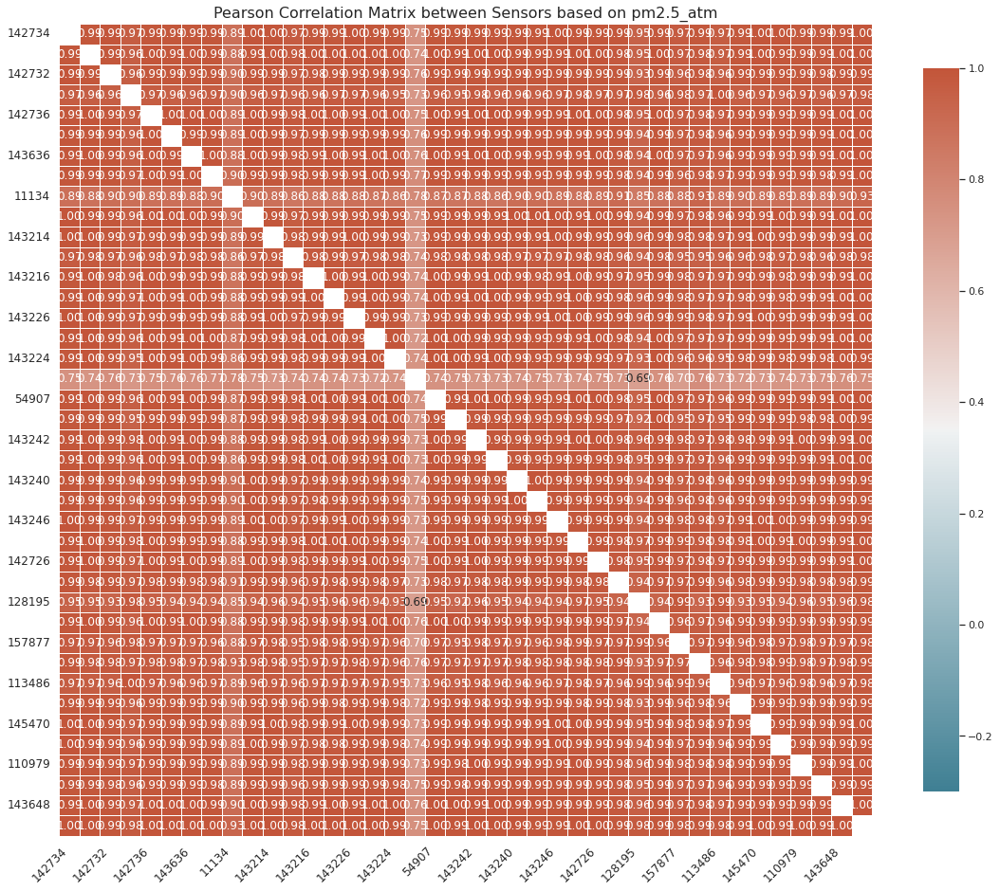

Pearson Correlation Matrix between Sensors based on pm2.5_atm:
Pearson Correlation Matrix between Sensors based on pm2.5_atm:


,142734,145454,142732,145262,142736,145250,143636,142748,11134,142774,143214,61239,143216,145204,143226,143916,143224,21179,54907,168327,143242,143666,143240,143656,143246,85113,142726,108364,128195,142720,157877,5582,113486,145498,145470,101525,110979,142718,143648,142744
142734,nan,0.99,0.99,0.97,0.99,0.99,0.99,0.99,0.89,1.00,1.00,0.97,0.99,0.99,1.00,0.99,0.99,0.75,0.99,0.99,0.99,0.99,0.99,0.99,1.00,0.99,0.99,0.99,0.95,0.99,0.97,0.99,0.97,0.99,1.00,1.00,0.99,0.99,0.99,1.00
145454,0.99,nan,0.99,0.96,1.00,0.99,1.00,0.99,0.88,0.99,1.00,0.98,1.00,1.00,1.00,1.00,1.00,0.74,1.00,0.99,1.00,1.00,0.99,0.99,0.99,1.00,1.00,0.98,0.95,1.00,0.97,0.98,0.97,0.99,1.00,0.99,0.99,0.99,1.00,1.00
142732,0.99,0.99,nan,0.96,0.99,0.99,0.99,0.99,0.90,0.99,0.99,0.97,0.98,0.99,0.99,0.99,0.99,0.76,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.93,0.99,0.96,0.98,0.96,0.99,0.99,0.99,0.99,0.98,0.99,0.99
145262,0.97,0.96,0.96,nan,0.97,0.96,0.96,0.97,0.90,0.96,0.97,0.96,0.96,0.97,0.97,0.96,0.95,0.73,0.96,0.95,0.98,0.96,0.96,0.96,0.97,0.98,0.97,0.97,0.98,0.96,0.98,0.97,1.00,0.96,0.97,0.96,0.97,0.96,0.97,0.98
142736,0.99,1.00,0.99,0.97,nan,1.00,1.00,1.00,0.89,1.00,0.99,0.98,1.00,1.00,0.99,1.00,1.00,0.75,1.00,0.99,1.00,1.00,0.99,0.99,0.99,1.00,1.00,0.98,0.95,1.00,0.97,0.98,0.97,0.99,0.99,0.99,0.99,0.99,1.00,1.00
145250,0.99,0.99,0.99,0.96,1.00,nan,0.99,0.99,0.89,1.00,0.99,0.97,0.99,0.99,0.99,0.99,0.99,0.76,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.94,0.99,0.97,0.98,0.96,0.99,0.99,0.99,0.99,0.99,1.00,1.00
143636,0.99,1.00,0.99,0.96,1.00,0.99,nan,1.00,0.88,1.00,0.99,0.98,0.99,1.00,0.99,1.00,1.00,0.76,1.00,0.99,1.00,1.00,0.99,0.99,0.99,0.99,1.00,0.98,0.94,1.00,0.97,0.97,0.96,0.99,0.99,0.99,0.99,0.99,1.00,1.00
142748,0.99,0.99,0.99,0.97,1.00,0.99,1.00,nan,0.90,0.99,0.99,0.98,0.99,0.99,0.99,1.00,0.99,0.77,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.94,0.99,0.96,0.98,0.97,0.99,0.99,0.99,0.99,0.98,0.99,1.00
11134,0.89,0.88,0.90,0.90,0.89,0.89,0.88,0.90,nan,0.90,0.89,0.86,0.88,0.88,0.88,0.87,0.86,0.78,0.87,0.87,0.88,0.86,0.90,0.90,0.89,0.88,0.89,0.91,0.85,0.88,0.88,0.93,0.89,0.90,0.89,0.89,0.89,0.89,0.90,0.93
142774,1.00,0.99,0.99,0.96,1.00,1.00,1.00,0.99,0.90,nan,0.99,0.97,0.99,0.99,0.99,0.99,0.99,0.75,0.99,0.99,0.99,0.99,1.00,1.00,1.00,0.99,1.00,0.99,0.94,0.99,0.97,0.98,0.96,0.99,0.99,1.00,0.99,0.99,1.00,1.00


In [77]:
import pandas as pd  # For data manipulation and analysis
import numpy as np   # For numerical operations
import seaborn as sns  # For statistical data visualization
import matplotlib.pyplot as plt  # For creating static plots
from scipy.stats import pearsonr  # For calculating Pearson correlation coefficient

# Load your CSV data
csv_path = 'AQ_Jan2023_updated.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Get unique sensor IDs
unique_sensor_ids = df['Sensor_ID'].unique()

# Create a matrix to store correlation coefficients
correlation_matrix = pd.DataFrame(index=unique_sensor_ids, columns=unique_sensor_ids)

# Iterate over each unique sensor ID
for sensor_id_1 in unique_sensor_ids:
    for sensor_id_2 in unique_sensor_ids:
        if sensor_id_1 != sensor_id_2:
            # Filter data for the current sensor IDs
            sensor_data_1 = df[df['Sensor_ID'] == sensor_id_1].set_index('time_stamp')['pm2.5_atm']
            sensor_data_2 = df[df['Sensor_ID'] == sensor_id_2].set_index('time_stamp')['pm2.5_atm']
            
            # Align timestamps and drop NaN values
            common_timestamps = sensor_data_1.index.intersection(sensor_data_2.index)
            sensor_data_1 = sensor_data_1.loc[common_timestamps]
            sensor_data_2 = sensor_data_2.loc[common_timestamps]
            
            # Calculate the Pearson correlation coefficient
            correlation_coefficient, _ = pearsonr(sensor_data_1, sensor_data_2)
            
            # Store the coefficient in the correlation matrix
            correlation_matrix.loc[sensor_id_1, sensor_id_2] = correlation_coefficient

# Set up the matplotlib figure
plt.figure(figsize=(16, 14))

# Customize the color map
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# Draw the heatmap with improved visualization
sns.heatmap(correlation_matrix.astype(float), 
            annot=True, 
            cmap=cmap, 
            fmt='.2f', 
            linewidths=0.5,
            square=True,  # Ensure a square layout
            vmin=-0.3, vmax=1,  # Set the color scale range for correlation
            cbar_kws={"shrink": 0.8},  # Adjust color bar size
            xticklabels=2,  # Show every 2nd x-axis label for better readability
            yticklabels=2)  # Show every 2nd y-axis label

# Customize the plot
plt.title('Pearson Correlation Matrix between Sensors based on January 2023 pm2.5_atm', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

# Print the correlation matrix as a formatted table with additional styling
print("Pearson Correlation Matrix between Sensors based on January 2023 pm2.5_atm:")
formatted_matrix = (
    correlation_matrix.style
    .format("{:.2f}")
    .set_table_styles([
        {'selector': 'th', 'props': [('background-color', '#f2f2f2')]},
        {'selector': 'td', 'props': [('text-align', 'center')]},
    ])
)

# Display the formatted correlation matrix
print("Pearson Correlation Matrix between Sensors based on January 2023 pm2.5_atm:")
formatted_matrix = correlation_matrix.style.format("{:.2f}")
display(formatted_matrix)

#### Other way of calculating Pearson correlation coefficient

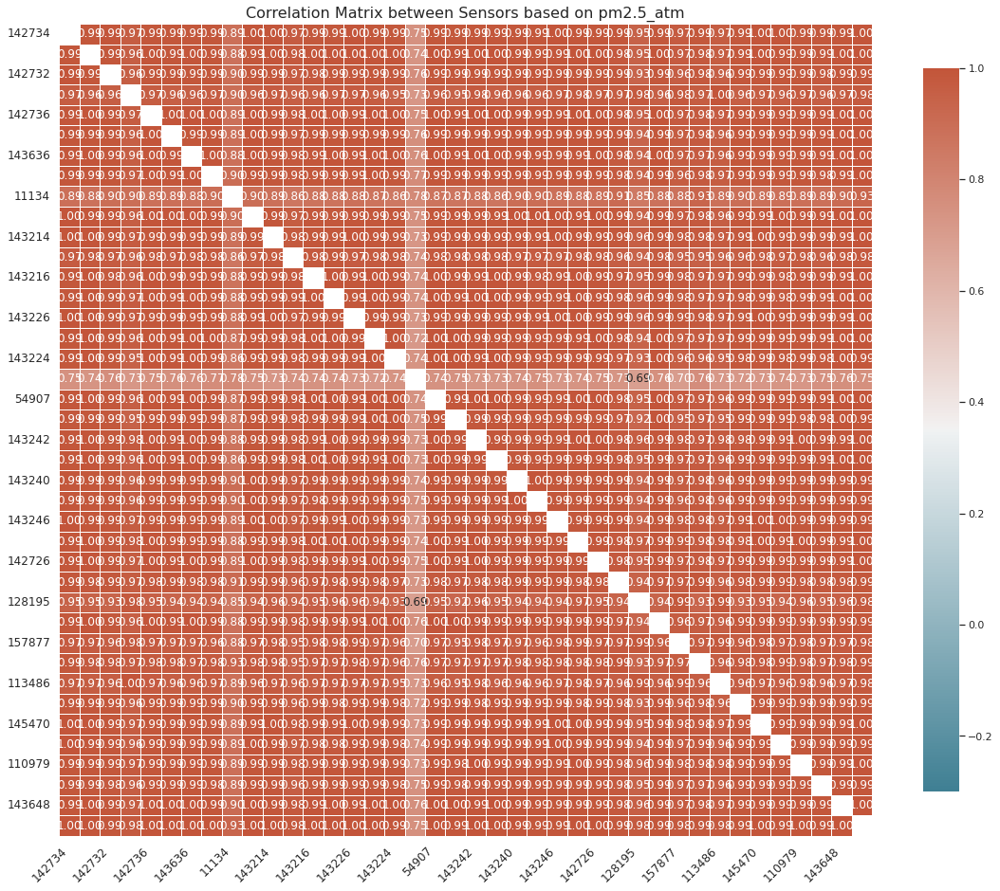

Correlation Matrix between Sensors based on pm2.5_atm:
Correlation Matrix between Sensors based on pm2.5_atm:


,142734,145454,142732,145262,142736,145250,143636,142748,11134,142774,143214,61239,143216,145204,143226,143916,143224,21179,54907,168327,143242,143666,143240,143656,143246,85113,142726,108364,128195,142720,157877,5582,113486,145498,145470,101525,110979,142718,143648,142744
142734,nan,0.99,0.99,0.97,0.99,0.99,0.99,0.99,0.89,1.00,1.00,0.97,0.99,0.99,1.00,0.99,0.99,0.75,0.99,0.99,0.99,0.99,0.99,0.99,1.00,0.99,0.99,0.99,0.95,0.99,0.97,0.99,0.97,0.99,1.00,1.00,0.99,0.99,0.99,1.00
145454,0.99,nan,0.99,0.96,1.00,0.99,1.00,0.99,0.88,0.99,1.00,0.98,1.00,1.00,1.00,1.00,1.00,0.74,1.00,0.99,1.00,1.00,0.99,0.99,0.99,1.00,1.00,0.98,0.95,1.00,0.97,0.98,0.97,0.99,1.00,0.99,0.99,0.99,1.00,1.00
142732,0.99,0.99,nan,0.96,0.99,0.99,0.99,0.99,0.90,0.99,0.99,0.97,0.98,0.99,0.99,0.99,0.99,0.76,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.93,0.99,0.96,0.98,0.96,0.99,0.99,0.99,0.99,0.98,0.99,0.99
145262,0.97,0.96,0.96,nan,0.97,0.96,0.96,0.97,0.90,0.96,0.97,0.96,0.96,0.97,0.97,0.96,0.95,0.73,0.96,0.95,0.98,0.96,0.96,0.96,0.97,0.98,0.97,0.97,0.98,0.96,0.98,0.97,1.00,0.96,0.97,0.96,0.97,0.96,0.97,0.98
142736,0.99,1.00,0.99,0.97,nan,1.00,1.00,1.00,0.89,1.00,0.99,0.98,1.00,1.00,0.99,1.00,1.00,0.75,1.00,0.99,1.00,1.00,0.99,0.99,0.99,1.00,1.00,0.98,0.95,1.00,0.97,0.98,0.97,0.99,0.99,0.99,0.99,0.99,1.00,1.00
145250,0.99,0.99,0.99,0.96,1.00,nan,0.99,0.99,0.89,1.00,0.99,0.97,0.99,0.99,0.99,0.99,0.99,0.76,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.94,0.99,0.97,0.98,0.96,0.99,0.99,0.99,0.99,0.99,1.00,1.00
143636,0.99,1.00,0.99,0.96,1.00,0.99,nan,1.00,0.88,1.00,0.99,0.98,0.99,1.00,0.99,1.00,1.00,0.76,1.00,0.99,1.00,1.00,0.99,0.99,0.99,0.99,1.00,0.98,0.94,1.00,0.97,0.97,0.96,0.99,0.99,0.99,0.99,0.99,1.00,1.00
142748,0.99,0.99,0.99,0.97,1.00,0.99,1.00,nan,0.90,0.99,0.99,0.98,0.99,0.99,0.99,1.00,0.99,0.77,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.94,0.99,0.96,0.98,0.97,0.99,0.99,0.99,0.99,0.98,0.99,1.00
11134,0.89,0.88,0.90,0.90,0.89,0.89,0.88,0.90,nan,0.90,0.89,0.86,0.88,0.88,0.88,0.87,0.86,0.78,0.87,0.87,0.88,0.86,0.90,0.90,0.89,0.88,0.89,0.91,0.85,0.88,0.88,0.93,0.89,0.90,0.89,0.89,0.89,0.89,0.90,0.93
142774,1.00,0.99,0.99,0.96,1.00,1.00,1.00,0.99,0.90,nan,0.99,0.97,0.99,0.99,0.99,0.99,0.99,0.75,0.99,0.99,0.99,0.99,1.00,1.00,1.00,0.99,1.00,0.99,0.94,0.99,0.97,0.98,0.96,0.99,0.99,1.00,0.99,0.99,1.00,1.00


In [74]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load your CSV data
csv_path = 'AQ_Jan2023_updated.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Get unique sensor IDs
unique_sensor_ids = df['Sensor_ID'].unique()

# Create a matrix to store correlation coefficients
correlation_matrix = pd.DataFrame(index=unique_sensor_ids, columns=unique_sensor_ids)

# Iterate over each unique sensor ID
for sensor_id_1 in unique_sensor_ids:
    for sensor_id_2 in unique_sensor_ids:
        if sensor_id_1 != sensor_id_2:
            # Filter data for the current sensor IDs
            sensor_data_1 = df[df['Sensor_ID'] == sensor_id_1].set_index('time_stamp')['pm2.5_atm']
            sensor_data_2 = df[df['Sensor_ID'] == sensor_id_2].set_index('time_stamp')['pm2.5_atm']
            
            # Align timestamps and drop NaN values
            common_timestamps = sensor_data_1.index.intersection(sensor_data_2.index)
            sensor_data_1 = sensor_data_1.loc[common_timestamps]
            sensor_data_2 = sensor_data_2.loc[common_timestamps]
            
            # Calculate the correlation coefficient
            correlation_coefficient = np.corrcoef(sensor_data_1, sensor_data_2)[0, 1]
            
            # Store the coefficient in the correlation matrix
            correlation_matrix.loc[sensor_id_1, sensor_id_2] = correlation_coefficient

# Set up the matplotlib figure
plt.figure(figsize=(16, 14))

# Customize the color map
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# Draw the heatmap with improved visualization
sns.heatmap(correlation_matrix.astype(float), 
            annot=True, 
            cmap=cmap, 
            fmt='.2f', 
            linewidths=0.5,
            square=True,  # Ensure a square layout
            vmin=-0.3, vmax=1,  # Set the color scale range for correlation
            cbar_kws={"shrink": 0.8},  # Adjust color bar size
            xticklabels=2,  # Show every 2nd x-axis label for better readability
            yticklabels=2)  # Show every 2nd y-axis label

# Customize the plot
plt.title('Correlation Matrix between Sensors based on pm2.5_atm', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

# Print the correlation matrix as a formatted table with additional styling
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = (
    correlation_matrix.style
    .format("{:.2f}")
    .set_table_styles([
        {'selector': 'th', 'props': [('background-color', '#f2f2f2')]},
        {'selector': 'td', 'props': [('text-align', 'center')]},
    ])
)

# Display the formatted correlation matrix
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = correlation_matrix.style.format("{:.2f}")
display(formatted_matrix)

#### April 2023

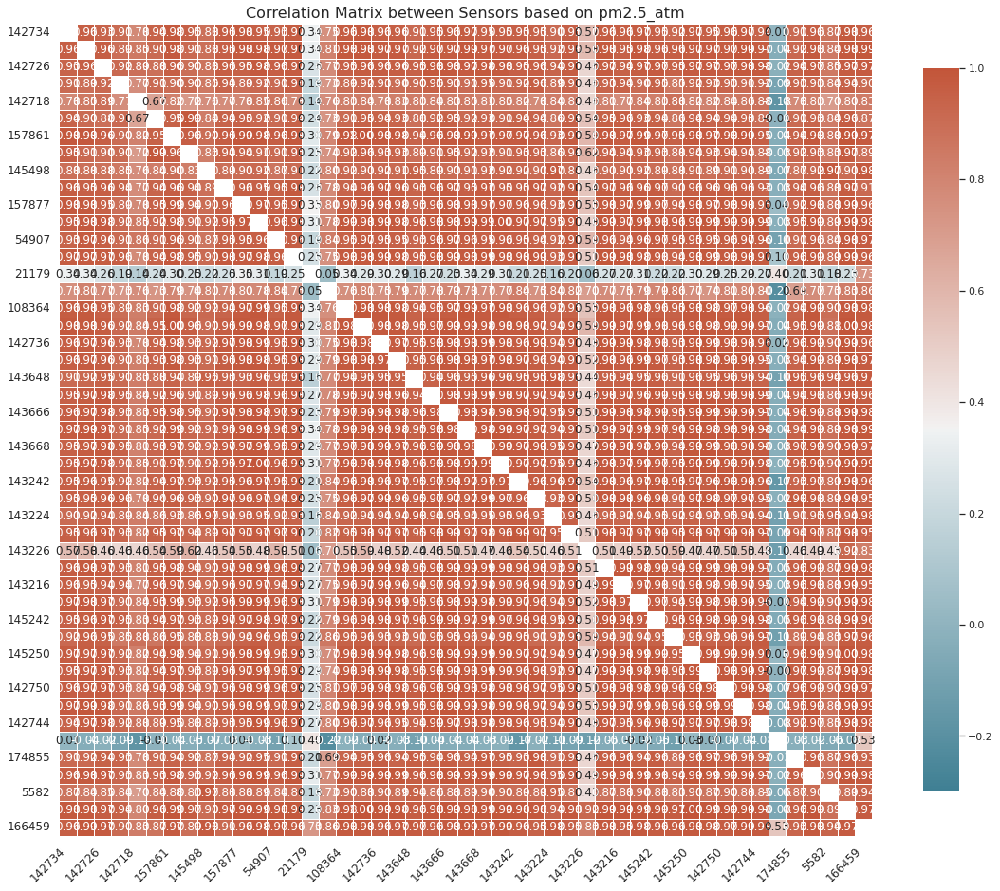

Correlation Matrix between Sensors based on pm2.5_atm:
Correlation Matrix between Sensors based on pm2.5_atm:


,142734,145506,142726,142720,142718,128195,157861,113486,145498,85113,157877,157935,54907,168327,21179,174451,108364,142732,142736,145470,143648,143636,143666,143246,143668,143240,143242,143916,143224,145202,143226,145204,143216,143214,145242,142774,145250,142748,142750,145454,142744,11134,174855,143656,5582,145604,166459
142734,nan,0.96,0.93,0.91,0.78,0.94,0.98,0.95,0.88,0.96,0.98,0.95,0.93,0.97,0.34,0.75,0.96,0.98,0.96,0.96,0.91,0.95,0.96,0.97,0.95,0.95,0.95,0.95,0.90,0.95,0.57,0.96,0.96,0.97,0.95,0.92,0.97,0.95,0.96,0.97,0.94,0.01,0.91,0.96,0.87,0.98,0.96
145506,0.96,nan,0.96,0.89,0.85,0.90,0.98,0.91,0.88,0.95,0.98,0.98,0.97,0.97,0.34,0.81,0.98,0.98,0.97,0.97,0.92,0.97,0.97,0.99,0.97,0.97,0.96,0.95,0.92,0.96,0.58,0.98,0.95,0.98,0.96,0.96,0.97,0.97,0.97,0.99,0.97,-0.04,0.92,0.98,0.84,0.98,0.99
142726,0.93,0.96,nan,0.92,0.89,0.88,0.96,0.90,0.88,0.96,0.95,0.98,0.96,0.97,0.26,0.77,0.95,0.96,0.96,0.96,0.95,0.98,0.98,0.97,0.98,0.98,0.95,0.96,0.94,0.97,0.46,0.97,0.94,0.97,0.97,0.95,0.97,0.97,0.97,0.98,0.98,-0.02,0.94,0.97,0.85,0.97,0.97
142720,0.91,0.89,0.92,nan,0.77,0.91,0.90,0.90,0.85,0.94,0.89,0.92,0.91,0.96,0.19,0.73,0.89,0.92,0.93,0.90,0.90,0.95,0.93,0.91,0.95,0.91,0.92,0.96,0.89,0.93,0.46,0.93,0.94,0.90,0.95,0.85,0.92,0.93,0.93,0.91,0.92,-0.09,0.93,0.93,0.84,0.94,0.90
142718,0.78,0.85,0.89,0.77,nan,0.67,0.82,0.72,0.76,0.77,0.78,0.85,0.86,0.78,0.14,0.76,0.83,0.84,0.78,0.83,0.83,0.84,0.83,0.85,0.81,0.85,0.82,0.78,0.84,0.82,0.46,0.81,0.77,0.84,0.83,0.88,0.82,0.82,0.84,0.86,0.88,-0.18,0.78,0.83,0.70,0.80,0.83
128195,0.94,0.90,0.88,0.91,0.67,nan,0.95,0.99,0.84,0.94,0.95,0.92,0.91,0.94,0.24,0.73,0.91,0.95,0.94,0.93,0.88,0.92,0.95,0.92,0.93,0.91,0.94,0.94,0.86,0.95,0.54,0.95,0.96,0.93,0.94,0.86,0.94,0.94,0.94,0.93,0.89,-0.01,0.91,0.93,0.84,0.96,0.87
157861,0.98,0.98,0.96,0.90,0.82,0.95,nan,0.96,0.90,0.96,0.99,0.98,0.96,0.98,0.30,0.79,0.98,1.00,0.98,0.98,0.94,0.96,0.98,0.99,0.97,0.97,0.97,0.96,0.93,0.97,0.59,0.98,0.97,0.99,0.97,0.95,0.98,0.97,0.98,0.99,0.95,-0.04,0.94,0.98,0.88,0.99,0.97
113486,0.95,0.91,0.90,0.90,0.72,0.99,0.96,nan,0.83,0.94,0.94,0.91,0.91,0.95,0.25,0.74,0.92,0.96,0.93,0.93,0.89,0.91,0.95,0.92,0.92,0.91,0.93,0.93,0.86,0.94,0.62,0.94,0.94,0.93,0.93,0.88,0.94,0.93,0.94,0.94,0.88,-0.03,0.92,0.93,0.83,0.97,0.89
145498,0.88,0.88,0.88,0.85,0.76,0.84,0.90,0.83,nan,0.89,0.90,0.92,0.87,0.90,0.22,0.80,0.92,0.90,0.92,0.91,0.95,0.89,0.90,0.91,0.92,0.92,0.92,0.90,0.97,0.89,0.46,0.90,0.90,0.92,0.89,0.88,0.91,0.89,0.91,0.90,0.89,-0.07,0.87,0.92,0.97,0.90,0.98
85113,0.96,0.95,0.96,0.94,0.77,0.94,0.96,0.94,0.89,nan,0.96,0.95,0.95,0.98,0.26,0.78,0.94,0.96,0.97,0.96,0.93,0.96,0.97,0.95,0.97,0.95,0.95,0.97,0.92,0.97,0.54,0.97,0.96,0.96,0.97,0.90,0.96,0.96,0.96,0.96,0.93,-0.03,0.94,0.96,0.88,0.97,0.91


In [72]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load your CSV data
csv_path = 'AQ_Apr2023_updated.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Get unique sensor IDs
unique_sensor_ids = df['Sensor_ID'].unique()

# Create a matrix to store correlation coefficients
correlation_matrix = pd.DataFrame(index=unique_sensor_ids, columns=unique_sensor_ids)

# Iterate over each unique sensor ID
for sensor_id_1 in unique_sensor_ids:
    for sensor_id_2 in unique_sensor_ids:
        if sensor_id_1 != sensor_id_2:
            # Filter data for the current sensor IDs
            sensor_data_1 = df[df['Sensor_ID'] == sensor_id_1].set_index('time_stamp')['pm2.5_atm']
            sensor_data_2 = df[df['Sensor_ID'] == sensor_id_2].set_index('time_stamp')['pm2.5_atm']
            
            # Align timestamps and drop NaN values
            common_timestamps = sensor_data_1.index.intersection(sensor_data_2.index)
            sensor_data_1 = sensor_data_1.loc[common_timestamps]
            sensor_data_2 = sensor_data_2.loc[common_timestamps]
            
            # Calculate the correlation coefficient
            correlation_coefficient = np.corrcoef(sensor_data_1, sensor_data_2)[0, 1]
            
            # Store the coefficient in the correlation matrix
            correlation_matrix.loc[sensor_id_1, sensor_id_2] = correlation_coefficient

# Set up the matplotlib figure
plt.figure(figsize=(16, 14))

# Customize the color map
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# Draw the heatmap with improved visualization
sns.heatmap(correlation_matrix.astype(float), 
            annot=True, 
            cmap=cmap, 
            fmt='.2f', 
            linewidths=0.5,
            square=True,  # Ensure a square layout
            vmin=-0.3, vmax=1,  # Set the color scale range for correlation
            cbar_kws={"shrink": 0.8},  # Adjust color bar size
            xticklabels=2,  # Show every 2nd x-axis label for better readability
            yticklabels=2)  # Show every 2nd y-axis label

# Customize the plot
plt.title('Correlation Matrix between Sensors based on pm2.5_atm', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

# Print the correlation matrix as a formatted table with additional styling
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = (
    correlation_matrix.style
    .format("{:.2f}")
    .set_table_styles([
        {'selector': 'th', 'props': [('background-color', '#f2f2f2')]},
        {'selector': 'td', 'props': [('text-align', 'center')]},
    ])
)

# Display the formatted correlation matrix
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = correlation_matrix.style.format("{:.2f}")
display(formatted_matrix)

#### July 2023

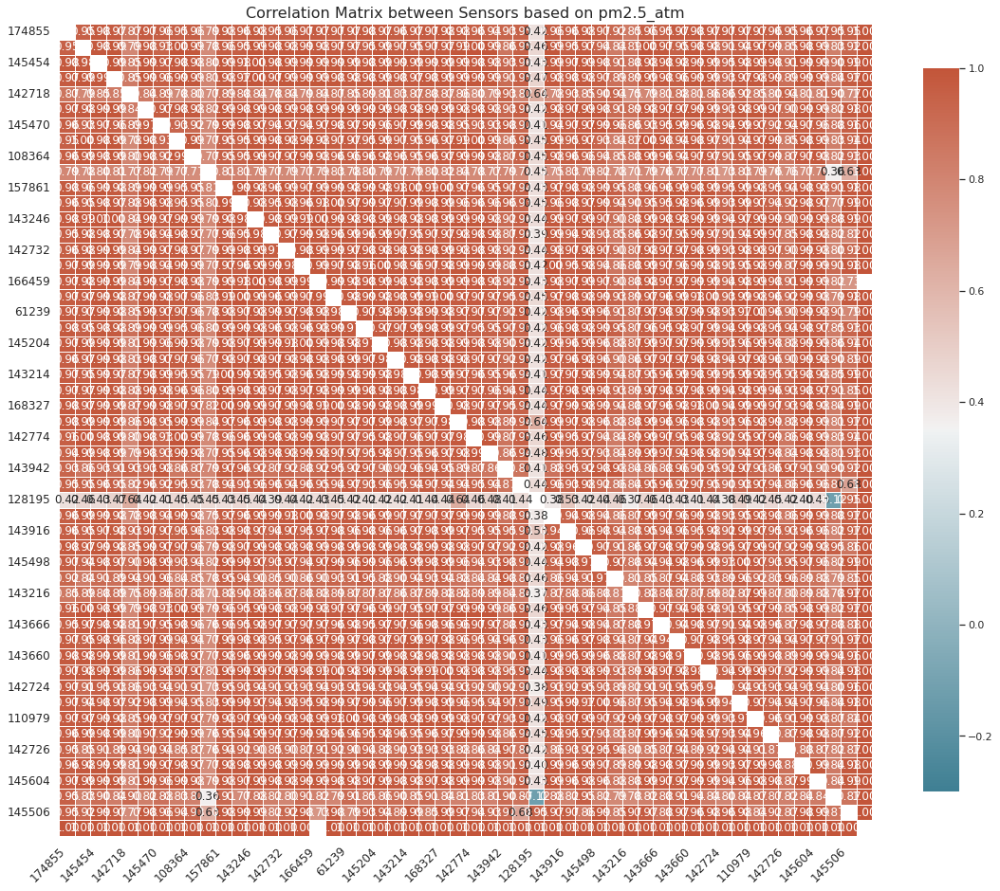

Correlation Matrix between Sensors based on pm2.5_atm:
Correlation Matrix between Sensors based on pm2.5_atm:


,174855,142750,145454,101525,142718,143240,145470,157935,108364,21179,157861,143668,143246,182801,142732,143242,166459,142748,61239,174451,145204,143226,143214,145242,168327,142734,142774,145250,143942,143224,128195,85113,143916,54907,145498,142744,143216,143634,143666,113486,143660,143656,142724,142720,110979,5582,142726,157877,145604,143636,145506,161401
174855,nan,0.95,0.98,0.97,0.87,0.97,0.96,0.95,0.96,0.79,0.98,0.96,0.98,0.95,0.96,0.97,0.97,0.97,0.97,0.98,0.97,0.96,0.97,0.97,0.98,0.98,0.96,0.94,0.93,0.95,0.42,0.96,0.96,0.98,0.97,0.92,0.85,0.96,0.95,0.97,0.98,0.97,0.97,0.97,0.97,0.96,0.95,0.96,0.97,0.95,0.95,1.00
142750,0.95,nan,0.98,0.99,0.79,0.98,0.93,1.00,0.99,0.78,0.96,0.95,0.99,0.98,0.98,0.99,0.98,0.97,0.97,0.95,0.99,0.97,0.95,0.97,0.97,0.99,1.00,0.99,0.86,0.95,0.46,0.99,0.95,0.97,0.94,0.84,0.89,1.00,0.97,0.95,0.98,0.98,0.91,0.94,0.97,0.99,0.85,0.98,0.99,0.83,0.92,1.00
145454,0.98,0.98,nan,0.99,0.85,0.99,0.97,0.98,0.98,0.80,0.99,0.98,1.00,0.98,0.99,0.99,0.99,0.99,0.99,0.98,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.98,0.93,0.96,0.43,0.99,0.97,0.99,0.98,0.91,0.88,0.98,0.98,0.98,0.99,0.99,0.95,0.98,0.99,0.98,0.91,0.99,0.99,0.90,0.99,1.00
101525,0.97,0.99,0.99,nan,0.85,0.99,0.96,0.99,0.99,0.81,0.98,0.97,1.00,0.97,0.99,0.99,0.99,0.98,0.98,0.98,0.99,0.98,0.97,0.98,0.99,0.99,0.99,0.99,0.91,0.95,0.47,0.98,0.98,0.98,0.97,0.89,0.89,0.99,0.98,0.96,0.99,0.99,0.93,0.97,0.98,0.99,0.89,0.99,0.99,0.84,0.97,1.00
142718,0.87,0.79,0.85,0.85,nan,0.84,0.89,0.78,0.80,0.77,0.89,0.88,0.84,0.78,0.84,0.79,0.84,0.87,0.85,0.89,0.81,0.83,0.87,0.88,0.87,0.86,0.80,0.79,0.93,0.82,0.64,0.78,0.93,0.85,0.90,0.94,0.75,0.79,0.81,0.88,0.81,0.86,0.86,0.92,0.85,0.80,0.94,0.81,0.81,0.90,0.77,1.00
143240,0.97,0.98,0.99,0.99,0.84,nan,0.97,0.98,0.98,0.82,0.99,0.98,0.99,0.98,0.99,0.98,0.99,0.99,0.99,0.99,0.99,0.98,0.98,0.99,0.99,0.98,0.98,0.98,0.93,0.96,0.42,0.98,0.97,0.99,0.98,0.91,0.89,0.98,0.97,0.97,0.99,0.99,0.93,0.98,0.99,0.97,0.90,0.99,0.99,0.82,0.98,1.00
145470,0.96,0.93,0.97,0.96,0.89,0.97,nan,0.93,0.92,0.79,0.99,0.98,0.97,0.94,0.97,0.94,0.97,0.98,0.97,0.99,0.96,0.97,0.99,0.98,0.98,0.95,0.93,0.93,0.98,0.92,0.41,0.94,0.97,0.97,0.99,0.96,0.86,0.93,0.95,0.99,0.96,0.98,0.94,0.99,0.97,0.92,0.94,0.97,0.96,0.88,0.96,1.00
157935,0.95,1.00,0.98,0.99,0.78,0.98,0.93,nan,0.99,0.77,0.95,0.95,0.99,0.98,0.98,0.99,0.98,0.97,0.97,0.95,0.99,0.97,0.95,0.96,0.97,0.99,1.00,0.99,0.86,0.95,0.45,0.99,0.95,0.97,0.93,0.84,0.87,1.00,0.98,0.94,0.98,0.97,0.91,0.94,0.97,0.99,0.85,0.98,0.99,0.83,0.94,1.00
108364,0.96,0.99,0.98,0.99,0.80,0.98,0.92,0.99,nan,0.77,0.95,0.95,0.99,0.97,0.97,0.99,0.98,0.96,0.96,0.96,0.98,0.96,0.95,0.96,0.97,0.99,0.99,0.98,0.87,0.93,0.45,0.98,0.96,0.96,0.94,0.85,0.88,0.99,0.96,0.94,0.97,0.97,0.91,0.95,0.97,0.99,0.87,0.97,0.98,0.82,0.93,1.00
21179,0.79,0.78,0.80,0.81,0.77,0.82,0.79,0.77,0.77,nan,0.81,0.81,0.79,0.77,0.79,0.77,0.79,0.83,0.78,0.80,0.79,0.77,0.79,0.80,0.82,0.84,0.78,0.77,0.79,0.78,0.45,0.75,0.83,0.79,0.82,0.78,0.71,0.79,0.76,0.77,0.77,0.81,0.73,0.83,0.79,0.76,0.76,0.77,0.79,0.36,0.63,1.00


In [73]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load your CSV data
csv_path = 'AQ_July2023_updated.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Get unique sensor IDs
unique_sensor_ids = df['Sensor_ID'].unique()

# Create a matrix to store correlation coefficients
correlation_matrix = pd.DataFrame(index=unique_sensor_ids, columns=unique_sensor_ids)

# Iterate over each unique sensor ID
for sensor_id_1 in unique_sensor_ids:
    for sensor_id_2 in unique_sensor_ids:
        if sensor_id_1 != sensor_id_2:
            # Filter data for the current sensor IDs
            sensor_data_1 = df[df['Sensor_ID'] == sensor_id_1].set_index('time_stamp')['pm2.5_atm']
            sensor_data_2 = df[df['Sensor_ID'] == sensor_id_2].set_index('time_stamp')['pm2.5_atm']
            
            # Align timestamps and drop NaN values
            common_timestamps = sensor_data_1.index.intersection(sensor_data_2.index)
            sensor_data_1 = sensor_data_1.loc[common_timestamps]
            sensor_data_2 = sensor_data_2.loc[common_timestamps]
            
            # Calculate the correlation coefficient
            correlation_coefficient = np.corrcoef(sensor_data_1, sensor_data_2)[0, 1]
            
            # Store the coefficient in the correlation matrix
            correlation_matrix.loc[sensor_id_1, sensor_id_2] = correlation_coefficient

# Set up the matplotlib figure
plt.figure(figsize=(16, 14))

# Customize the color map
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# Draw the heatmap with improved visualization
sns.heatmap(correlation_matrix.astype(float), 
            annot=True, 
            cmap=cmap, 
            fmt='.2f', 
            linewidths=0.5,
            square=True,  # Ensure a square layout
            vmin=-0.3, vmax=1,  # Set the color scale range for correlation
            cbar_kws={"shrink": 0.8},  # Adjust color bar size
            xticklabels=2,  # Show every 2nd x-axis label for better readability
            yticklabels=2)  # Show every 2nd y-axis label

# Customize the plot
plt.title('Correlation Matrix between Sensors based on pm2.5_atm', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

# Print the correlation matrix as a formatted table with additional styling
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = (
    correlation_matrix.style
    .format("{:.2f}")
    .set_table_styles([
        {'selector': 'th', 'props': [('background-color', '#f2f2f2')]},
        {'selector': 'td', 'props': [('text-align', 'center')]},
    ])
)

# Display the formatted correlation matrix
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = correlation_matrix.style.format("{:.2f}")
display(formatted_matrix)

#### Oct2023

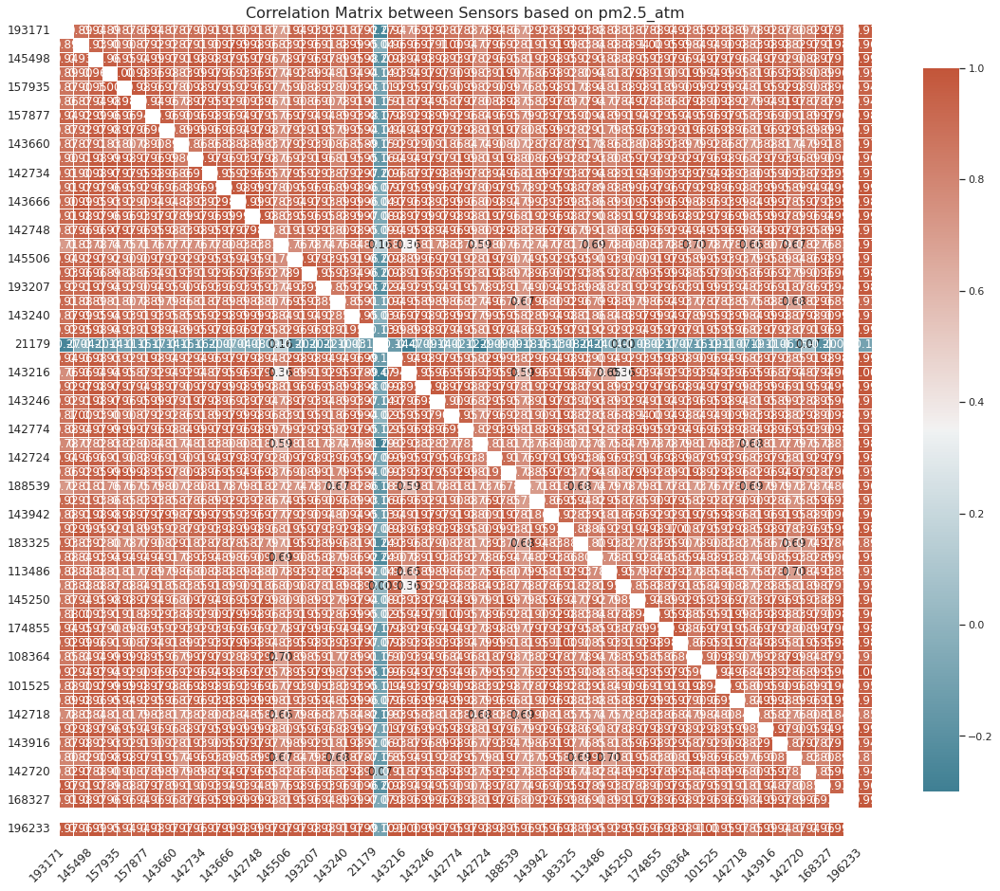

Correlation Matrix between Sensors based on pm2.5_atm:
Correlation Matrix between Sensors based on pm2.5_atm:


,193171,61239,145498,142750,157935,11134,157877,143656,143660,142732,142734,145470,143666,142744,142748,143636,145506,143224,193207,145604,143240,143226,21179,157861,143216,143214,143246,54907,142774,166459,142724,161401,188539,145454,143942,174451,183325,99807,113486,128195,145250,110979,174855,145242,108364,182801,101525,145204,142718,143242,143916,5582,142720,85113,168327,194635,196233
193171,nan,0.89,0.94,0.89,0.87,0.86,0.94,0.87,0.87,0.90,0.91,0.91,0.90,0.91,0.87,0.71,0.94,0.93,0.92,0.91,0.87,0.92,-0.27,0.94,0.76,0.92,0.92,0.87,0.88,0.78,0.94,0.86,0.72,0.92,0.88,0.92,0.93,0.88,0.88,0.83,0.87,0.88,0.94,0.92,0.85,0.92,0.88,0.89,0.78,0.92,0.87,0.80,0.82,0.97,0.91,nan,0.97
61239,0.89,nan,0.93,0.90,0.90,0.87,0.92,0.92,0.87,0.91,0.90,0.97,0.99,0.98,0.96,0.83,0.92,0.96,0.91,0.88,0.99,0.95,-0.04,0.96,0.96,0.97,0.91,1.00,0.94,0.77,0.96,0.92,0.81,0.91,0.91,0.99,0.83,0.84,0.88,0.88,0.94,1.00,0.95,0.99,0.84,0.94,0.90,0.98,0.83,0.98,0.98,0.82,0.97,0.91,0.98,nan,0.96
145498,0.94,0.93,nan,0.96,0.95,0.94,0.99,0.97,0.91,0.98,0.98,0.97,0.95,0.97,0.96,0.78,0.97,0.96,0.97,0.89,0.95,0.98,-0.20,0.98,0.94,0.98,0.98,0.93,0.97,0.82,0.96,0.95,0.81,0.93,0.98,0.95,0.92,0.93,0.88,0.88,0.95,0.93,0.97,0.96,0.94,0.97,0.97,0.96,0.84,0.97,0.92,0.90,0.88,0.97,0.97,nan,0.99
142750,0.89,0.90,0.96,nan,1.00,0.98,0.96,0.98,0.83,0.99,0.97,0.96,0.93,0.96,0.97,0.74,0.92,0.89,0.94,0.81,0.94,0.94,-0.14,0.93,0.94,0.97,0.97,0.90,0.99,0.83,0.91,0.99,0.76,0.86,0.98,0.92,0.80,0.94,0.81,0.87,0.98,0.91,0.90,0.91,0.99,0.94,0.99,0.95,0.81,0.96,0.93,0.98,0.90,0.89,0.96,nan,0.95
157935,0.87,0.90,0.95,1.00,nan,0.98,0.96,0.97,0.80,0.98,0.97,0.95,0.92,0.96,0.97,0.75,0.90,0.88,0.92,0.80,0.93,0.93,-0.11,0.92,0.95,0.97,0.96,0.90,0.99,0.82,0.90,0.99,0.76,0.85,0.98,0.91,0.78,0.94,0.81,0.88,0.98,0.91,0.89,0.90,0.99,0.92,0.99,0.94,0.81,0.95,0.92,0.98,0.90,0.88,0.96,nan,0.94
11134,0.86,0.87,0.94,0.98,0.98,nan,0.94,0.96,0.78,0.97,0.95,0.92,0.90,0.93,0.96,0.71,0.90,0.86,0.90,0.78,0.91,0.91,-0.15,0.91,0.87,0.94,0.95,0.87,0.97,0.80,0.88,0.98,0.75,0.83,0.97,0.89,0.77,0.94,0.77,0.84,0.97,0.88,0.86,0.87,0.98,0.90,0.98,0.92,0.79,0.94,0.91,0.97,0.87,0.87,0.94,nan,0.94
157877,0.94,0.92,0.99,0.96,0.96,0.94,nan,0.96,0.90,0.96,0.98,0.96,0.94,0.97,0.95,0.76,0.97,0.94,0.94,0.89,0.93,0.98,-0.17,0.98,0.92,0.98,0.99,0.92,0.96,0.84,0.96,0.95,0.79,0.93,0.97,0.95,0.90,0.94,0.89,0.91,0.94,0.92,0.95,0.94,0.95,0.96,0.97,0.95,0.83,0.96,0.90,0.91,0.89,0.97,0.96,nan,0.98
143656,0.87,0.92,0.97,0.98,0.97,0.96,0.96,nan,0.89,0.99,0.96,0.96,0.94,0.97,0.98,0.77,0.92,0.91,0.95,0.79,0.95,0.94,-0.14,0.94,0.94,0.97,0.97,0.92,0.98,0.81,0.91,0.97,0.80,0.85,0.99,0.92,0.82,0.91,0.79,0.85,0.96,0.93,0.92,0.91,0.96,0.96,0.98,0.96,0.81,0.96,0.92,0.95,0.89,0.89,0.96,nan,0.97
143660,0.87,0.87,0.91,0.83,0.80,0.78,0.90,0.89,nan,0.86,0.86,0.88,0.88,0.89,0.83,0.77,0.92,0.93,0.90,0.86,0.85,0.89,-0.15,0.92,0.92,0.90,0.91,0.86,0.84,0.74,0.90,0.80,0.72,0.87,0.87,0.87,0.91,0.78,0.86,0.83,0.80,0.88,0.93,0.89,0.79,0.92,0.86,0.87,0.73,0.88,0.81,0.74,0.79,0.91,0.87,nan,0.97
142732,0.90,0.91,0.98,0.99,0.98,0.97,0.96,0.99,0.86,nan,0.97,0.96,0.93,0.97,0.98,0.76,0.92,0.91,0.96,0.81,0.95,0.95,-0.16,0.94,0.94,0.97,0.97,0.91,0.99,0.81,0.91,0.98,0.80,0.86,0.99,0.92,0.82,0.93,0.80,0.85,0.97,0.92,0.92,0.92,0.97,0.96,0.98,0.96,0.82,0.97,0.93,0.96,0.89,0.90,0.96,nan,0.96


In [75]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load your CSV data
csv_path = 'AQ_Oct2023_updated.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Get unique sensor IDs
unique_sensor_ids = df['Sensor_ID'].unique()

# Create a matrix to store correlation coefficients
correlation_matrix = pd.DataFrame(index=unique_sensor_ids, columns=unique_sensor_ids)

# Iterate over each unique sensor ID
for sensor_id_1 in unique_sensor_ids:
    for sensor_id_2 in unique_sensor_ids:
        if sensor_id_1 != sensor_id_2:
            # Filter data for the current sensor IDs
            sensor_data_1 = df[df['Sensor_ID'] == sensor_id_1].set_index('time_stamp')['pm2.5_atm']
            sensor_data_2 = df[df['Sensor_ID'] == sensor_id_2].set_index('time_stamp')['pm2.5_atm']
            
            # Align timestamps and drop NaN values
            common_timestamps = sensor_data_1.index.intersection(sensor_data_2.index)
            sensor_data_1 = sensor_data_1.loc[common_timestamps]
            sensor_data_2 = sensor_data_2.loc[common_timestamps]
            
            # Calculate the correlation coefficient
            correlation_coefficient = np.corrcoef(sensor_data_1, sensor_data_2)[0, 1]
            
            # Store the coefficient in the correlation matrix
            correlation_matrix.loc[sensor_id_1, sensor_id_2] = correlation_coefficient

# Set up the matplotlib figure
plt.figure(figsize=(16, 14))

# Customize the color map
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# Draw the heatmap with improved visualization
sns.heatmap(correlation_matrix.astype(float), 
            annot=True, 
            cmap=cmap, 
            fmt='.2f', 
            linewidths=0.5,
            square=True,  # Ensure a square layout
            vmin=-0.3, vmax=1,  # Set the color scale range for correlation
            cbar_kws={"shrink": 0.8},  # Adjust color bar size
            xticklabels=2,  # Show every 2nd x-axis label for better readability
            yticklabels=2)  # Show every 2nd y-axis label

# Customize the plot
plt.title('Correlation Matrix between Sensors based on pm2.5_atm', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

# Print the correlation matrix as a formatted table with additional styling
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = (
    correlation_matrix.style
    .format("{:.2f}")
    .set_table_styles([
        {'selector': 'th', 'props': [('background-color', '#f2f2f2')]},
        {'selector': 'td', 'props': [('text-align', 'center')]},
    ])
)

# Display the formatted correlation matrix
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = correlation_matrix.style.format("{:.2f}")
display(formatted_matrix)

#### All 4 months

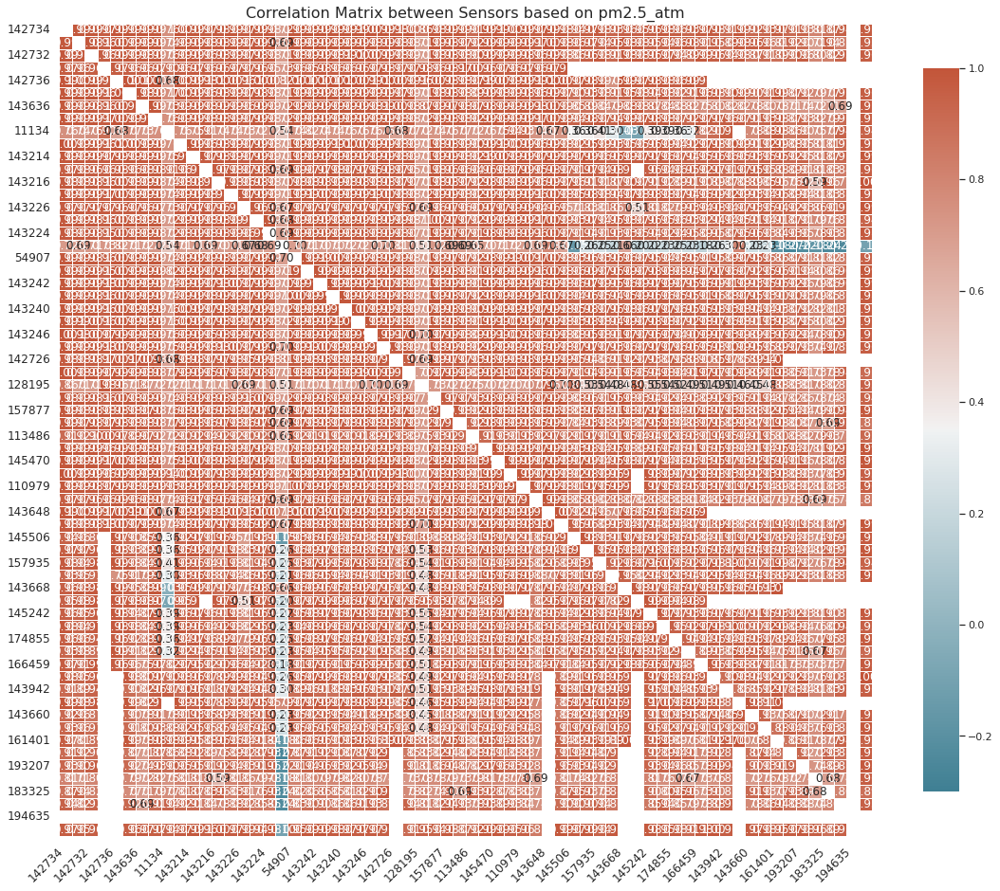

In [76]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load your CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Get unique sensor IDs
unique_sensor_ids = df['Sensor_ID'].unique()

# Create a matrix to store correlation coefficients
correlation_matrix = pd.DataFrame(index=unique_sensor_ids, columns=unique_sensor_ids)

# Iterate over each unique sensor ID
for sensor_id_1 in unique_sensor_ids:
    for sensor_id_2 in unique_sensor_ids:
        if sensor_id_1 != sensor_id_2:
            # Filter data for the current sensor IDs
            sensor_data_1 = df[df['Sensor_ID'] == sensor_id_1].set_index('time_stamp')['pm2.5_atm']
            sensor_data_2 = df[df['Sensor_ID'] == sensor_id_2].set_index('time_stamp')['pm2.5_atm']
            
            # Align timestamps and drop NaN values
            common_timestamps = sensor_data_1.index.intersection(sensor_data_2.index)
            sensor_data_1 = sensor_data_1.loc[common_timestamps]
            sensor_data_2 = sensor_data_2.loc[common_timestamps]
            
            # Calculate the correlation coefficient
            correlation_coefficient = np.corrcoef(sensor_data_1, sensor_data_2)[0, 1]
            
            # Store the coefficient in the correlation matrix
            correlation_matrix.loc[sensor_id_1, sensor_id_2] = correlation_coefficient

# Set up the matplotlib figure
plt.figure(figsize=(16, 14))

# Customize the color map
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# Draw the heatmap with improved visualization
sns.heatmap(correlation_matrix.astype(float), 
            annot=True, 
            cmap=cmap, 
            fmt='.2f', 
            linewidths=0.5,
            square=True,  # Ensure a square layout
            vmin=-0.3, vmax=1,  # Set the color scale range for correlation
            cbar_kws={"shrink": 0.8},  # Adjust color bar size
            xticklabels=2,  # Show every 2nd x-axis label for better readability
            yticklabels=2)  # Show every 2nd y-axis label

# Customize the plot
plt.title('Correlation Matrix between Sensors based on pm2.5_atm', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

In [17]:
# Print the correlation matrix as a formatted table with additional styling
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = (
    correlation_matrix.style
    .format("{:.2f}")
    .set_table_styles([
        {'selector': 'th', 'props': [('background-color', '#f2f2f2')]},
        {'selector': 'td', 'props': [('text-align', 'center')]},
    ])
)

# Display the formatted correlation matrix
print("Correlation Matrix between Sensors based on pm2.5_atm:")
formatted_matrix = correlation_matrix.style.format("{:.2f}")
display(formatted_matrix)

Correlation Matrix between Sensors based on pm2.5_atm:
Correlation Matrix between Sensors based on pm2.5_atm:


,142734,145454,142732,145262,142736,145250,143636,142748,11134,142774,143214,61239,143216,145204,143226,143916,143224,21179,54907,168327,143242,143666,143240,143656,143246,85113,142726,108364,128195,142720,157877,5582,113486,145498,145470,101525,110979,142718,143648,142744,145506,157861,157935,174451,143668,145202,145242,142750,174855,145604,166459,182801,143942,143634,143660,142724,161401,193171,193207,188539,183325,99807,194635,196233
142734,nan,0.99,0.99,0.97,0.99,0.99,0.99,0.99,0.76,1.00,0.99,0.97,0.98,0.99,0.97,0.99,0.98,0.72,0.99,0.99,0.99,0.99,0.99,0.99,1.00,0.99,0.98,1.00,0.86,0.98,0.99,0.99,0.91,0.99,0.99,1.00,0.99,0.97,0.99,0.98,0.94,0.97,0.98,0.93,0.96,0.95,0.96,0.98,0.96,0.93,0.97,0.98,0.91,0.99,0.92,0.93,0.97,0.91,0.93,0.81,0.87,0.94,nan,0.97
145454,0.99,nan,0.98,0.96,1.00,0.99,0.99,0.99,0.74,0.99,0.99,0.98,0.98,0.99,0.97,0.99,0.99,0.69,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.99,0.98,0.98,0.71,0.99,0.98,0.97,0.92,0.99,0.99,0.99,0.99,0.97,1.00,0.98,0.96,0.97,0.94,0.95,0.98,0.98,0.95,0.94,0.96,0.98,0.91,0.95,0.89,0.98,0.96,0.96,0.81,0.92,0.90,0.71,0.94,0.82,nan,0.95
142732,0.99,0.98,nan,0.96,0.99,0.99,0.98,0.99,0.76,0.99,0.99,0.96,0.98,0.99,0.97,0.98,0.98,0.71,0.98,0.99,0.99,0.98,0.99,1.00,1.00,0.99,0.98,0.99,0.71,0.98,0.98,0.98,0.90,0.99,0.99,0.99,0.98,0.96,0.99,0.98,0.86,0.96,0.98,0.91,0.98,0.98,0.96,0.97,0.94,0.89,0.99,0.96,0.94,0.98,0.87,0.91,0.89,0.90,0.96,0.80,0.82,0.93,nan,0.96
145262,0.97,0.96,0.96,nan,0.97,0.96,0.96,0.97,0.90,0.96,0.97,0.96,0.96,0.97,0.97,0.96,0.95,0.73,0.96,0.95,0.98,0.96,0.96,0.96,0.97,0.98,0.97,0.97,0.98,0.96,0.98,0.97,1.00,0.96,0.97,0.96,0.97,0.96,0.97,0.98,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
142736,0.99,1.00,0.99,0.97,nan,1.00,1.00,1.00,0.68,1.00,0.99,0.98,1.00,1.00,0.96,1.00,1.00,0.82,1.00,1.00,1.00,1.00,1.00,1.00,0.99,1.00,1.00,0.99,0.96,1.00,0.98,0.98,0.97,0.99,1.00,0.99,0.99,0.99,1.00,1.00,0.97,0.98,0.99,0.75,0.99,0.97,0.98,0.98,0.96,0.99,0.96,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
145250,0.99,0.99,0.99,0.96,1.00,nan,0.98,0.99,0.77,1.00,0.99,0.96,0.98,0.99,0.97,0.98,0.98,0.71,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.97,0.99,0.71,0.98,0.98,0.98,0.89,0.99,0.98,0.99,0.98,0.96,0.99,0.97,0.90,0.93,0.98,0.91,0.95,0.98,0.94,0.98,0.92,0.91,0.96,0.98,0.90,0.99,0.90,0.91,0.99,0.87,0.92,0.79,0.77,0.92,nan,0.96
143636,0.99,0.99,0.98,0.96,1.00,0.98,nan,0.99,0.73,0.99,0.99,0.98,0.99,0.99,0.96,0.99,0.99,0.72,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.99,1.00,0.98,0.87,0.99,0.97,0.98,0.97,0.98,0.99,0.99,0.99,0.98,1.00,0.99,0.85,0.89,0.84,0.79,0.88,0.98,0.87,0.84,0.88,0.82,0.75,0.80,0.82,0.82,0.78,0.80,0.78,0.71,0.74,0.72,0.71,0.69,nan,0.97
142748,0.99,0.99,0.99,0.97,1.00,0.99,0.99,nan,0.76,0.99,0.99,0.98,0.98,0.99,0.97,0.99,0.98,0.72,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.98,0.72,0.99,0.98,0.98,0.92,0.99,0.99,0.99,0.99,0.97,1.00,0.99,0.94,0.98,0.97,0.94,0.99,0.97,0.98,0.98,0.97,0.92,0.97,0.97,0.96,0.97,0.91,0.93,0.98,0.87,0.93,0.82,0.79,0.91,nan,0.97
11134,0.76,0.74,0.76,0.90,0.68,0.77,0.73,0.76,nan,0.76,0.75,0.91,0.74,0.74,0.73,0.72,0.72,0.54,0.74,0.82,0.74,0.74,0.76,0.76,0.76,0.75,0.68,0.77,0.72,0.74,0.76,0.77,0.72,0.76,0.75,0.94,0.93,0.74,0.67,0.74,0.36,0.36,0.41,0.30,-0.03,-0.09,0.39,0.39,0.36,0.32,0.82,0.90,0.97,nan,0.78,0.88,0.98,0.86,0.90,0.75,0.77,0.94,nan,0.94
142774,1.00,0.99,0.99,0.96,1.00,1.00,0.99,0.99,0.76,nan,0.99,0.96,0.98,0.99,0.97,0.99,0.98,0.71,0.99,0.99,0.99,0.99,1.00,1.00,0.99,0.99,0.98,0.99,0.71,0.98,0.98,0.99,0.90,0.99,0.99,1.00,0.99,0.96,0.99,0.98,0.92,0.95,0.99,0.93,0.95,0.95,0.96,0.99,0.94,0.92,0.97,0.98,0.90,0.99,0.91,0.92,0.99,0.88,0.95,0.81,0.81,0.92,nan,0.97


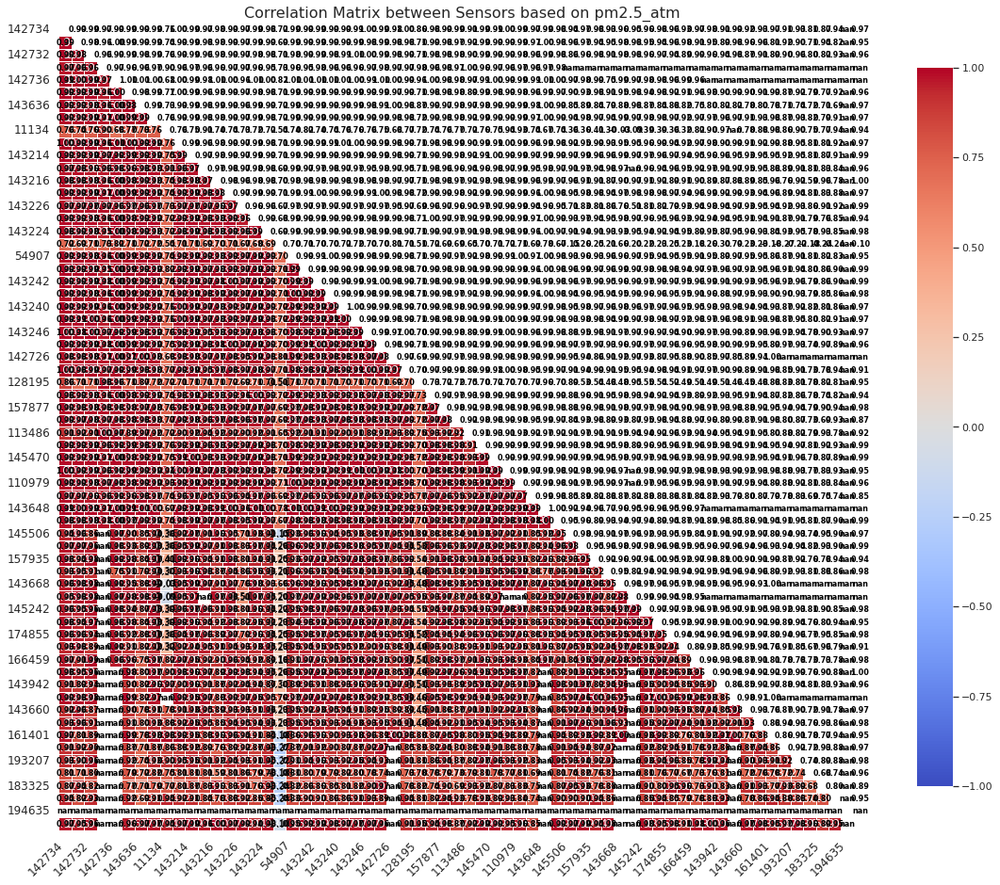

In [42]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load your CSV data
csv_path = 'Combined_AQ_Data.csv'
df = pd.read_csv(csv_path)

# Assuming df['time_stamp'] is a datetime column
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Get unique sensor IDs
unique_sensor_ids = df['Sensor_ID'].unique()

# Create a matrix to store correlation coefficients
correlation_matrix = pd.DataFrame(index=unique_sensor_ids, columns=unique_sensor_ids)

# Iterate over each unique sensor ID
for sensor_id_1 in unique_sensor_ids:
    for sensor_id_2 in unique_sensor_ids:
        if sensor_id_1 != sensor_id_2:
            # Filter data for the current sensor IDs
            sensor_data_1 = df[df['Sensor_ID'] == sensor_id_1].set_index('time_stamp')['pm2.5_atm']
            sensor_data_2 = df[df['Sensor_ID'] == sensor_id_2].set_index('time_stamp')['pm2.5_atm']
            
            # Align timestamps and drop NaN values
            common_timestamps = sensor_data_1.index.intersection(sensor_data_2.index)
            sensor_data_1 = sensor_data_1.loc[common_timestamps]
            sensor_data_2 = sensor_data_2.loc[common_timestamps]
            
            # Calculate the correlation coefficient
            correlation_coefficient = np.corrcoef(sensor_data_1, sensor_data_2)[0, 1]
            
            # Store the coefficient in the correlation matrix
            correlation_matrix.loc[sensor_id_1, sensor_id_2] = correlation_coefficient

# Set up the matplotlib figure
plt.figure(figsize=(16, 14))

# Customize the color map for better visibility
cmap = sns.color_palette("coolwarm", as_cmap=True)

# Draw the heatmap with improved visualization
heatmap = sns.heatmap(correlation_matrix.astype(float), 
                      annot=True, 
                      cmap=cmap, 
                      fmt='.2f', 
                      linewidths=0.5,
                      square=True,  # Ensure a square layout
                      vmin=-1, vmax=1,  # Set the color scale range for correlation
                      cbar_kws={"shrink": 0.8},  # Adjust color bar size
                      xticklabels=2,  # Show every 2nd x-axis label for better readability
                      yticklabels=2,  # Show every 2nd y-axis label
                      mask=np.triu(correlation_matrix))  # Remove redundant information from the upper triangular part

# Add text annotations
for i in range(len(correlation_matrix)):
    for j in range(len(correlation_matrix)):
        if i != j:
            plt.text(j + 0.5, i + 0.5, f"{correlation_matrix.iloc[i, j]:.2f}", 
                     ha='center', va='center', fontsize=8, color='black', fontweight='bold')

# Customize the plot
plt.title('Correlation Matrix between Sensors based on pm2.5_atm', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

### Weather Data

https://madis-data.ncep.noaa.gov/index.shtml
https://forecast.weather.gov/MapClick.php?lat=44.97902000000005&lon=-93.26493999999997
https://www.wunderground.com/history
https://www.weather.gov/mpx/mspclimate
https://www.climate.gov/maps-data/dataset/past-weather-zip-code-data-table
https://www.dnr.state.mn.us/climate/historical/daily-data.html?sid=mspthr&sname=Minneapolis/St%20Paul%20Threaded%20Record&sdate=2010-01-01&edate=por
https://www.wunderground.com/history/daily/us/mn/minneapolis